In [127]:
# Dependencies and Setup
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from matplotlib import rcParams
import scipy.stats as sts
import os
from collections import Counter
import requests
import json
import gmaps

# Google API Key
from api_keys import gkey

# Configure gmaps
gmaps.configure(gkey)

In [128]:
#setting background of figure black
plt.style.use('ggplot')

In [129]:
#Set Fonts/Plot Style
rcParams['figure.figsize'] = [15.0, 10.0]
rcParams['figure.dpi'] = 80
rcParams['savefig.dpi'] = 100
rcParams['font.size'] = 20
rcParams['legend.fontsize'] = 'large'
rcParams['figure.titlesize'] = 'medium'
rcParams['font.family'] = 'sans-serif'
rcParams['font.sans-serif'] = ['Arial']
rcParams['xtick.direction'] = 'in'
rcParams['ytick.direction'] = 'in'
rcParams['xtick.top'] = True
rcParams['ytick.right'] = True
rcParams['xtick.major.size'] = 10
rcParams['ytick.major.size'] = 10
rcParams['xtick.minor.size'] = 5
rcParams['ytick.minor.size'] = 5
rcParams['xtick.minor.visible'] = True
rcParams['ytick.minor.visible'] = True

## Reading clean California census data for plotting

In [4]:
#reading 2012 clean california census data
path_ca_2012=os.path.join('output_census', 'ca_2012_fg.csv')
ca_2012=pd.read_csv(path_ca_2012)

#reading 2014 clean california census data
path_ca_2014=os.path.join('output_census', 'ca_2014_fg.csv')
ca_2014=pd.read_csv(path_ca_2014)

#reading 2015 clean california census data
path_ca_2015=os.path.join('output_census', 'ca_2015_fg.csv')
ca_2015=pd.read_csv(path_ca_2015)

#reading 2017 clean california census data
path_ca_2017=os.path.join('output_census', 'ca_2017_fg.csv')
ca_2017=pd.read_csv(path_ca_2017)

#reading 2019 clean california census data
path_ca_2019=os.path.join('output_census', 'ca_2019_fg.csv')
ca_2019=pd.read_csv(path_ca_2019)

## California Census 2012 Figures

In [5]:
#2012 california cleaned data columns
ca_2012.columns

Index(['Zipcode', 'Population', 'Median Age', 'Household Income',
       'Per Capita Income', 'Poverty Rate', 'Unemployment Rate', 'House Value',
       'House Construction Year', 'Monthly Owner Cost', 'Monthly Rent',
       'Public Transport Rate', 'Personal Transport Rate',
       'Commute Time Public', 'Commute Time Car', 'High School Rate',
       'College Rate', 'Uneducated Rate', 'English Language Rate',
       'Spanish Language Rate', 'White Population Rate',
       'Black Population Rate', 'Hispanic Population Rate',
       'Asian Population Rate', 'City', 'County', 'Lat', 'Lng',
       'Housing_units', 'State'],
      dtype='object')

### Scatter Matrix plot

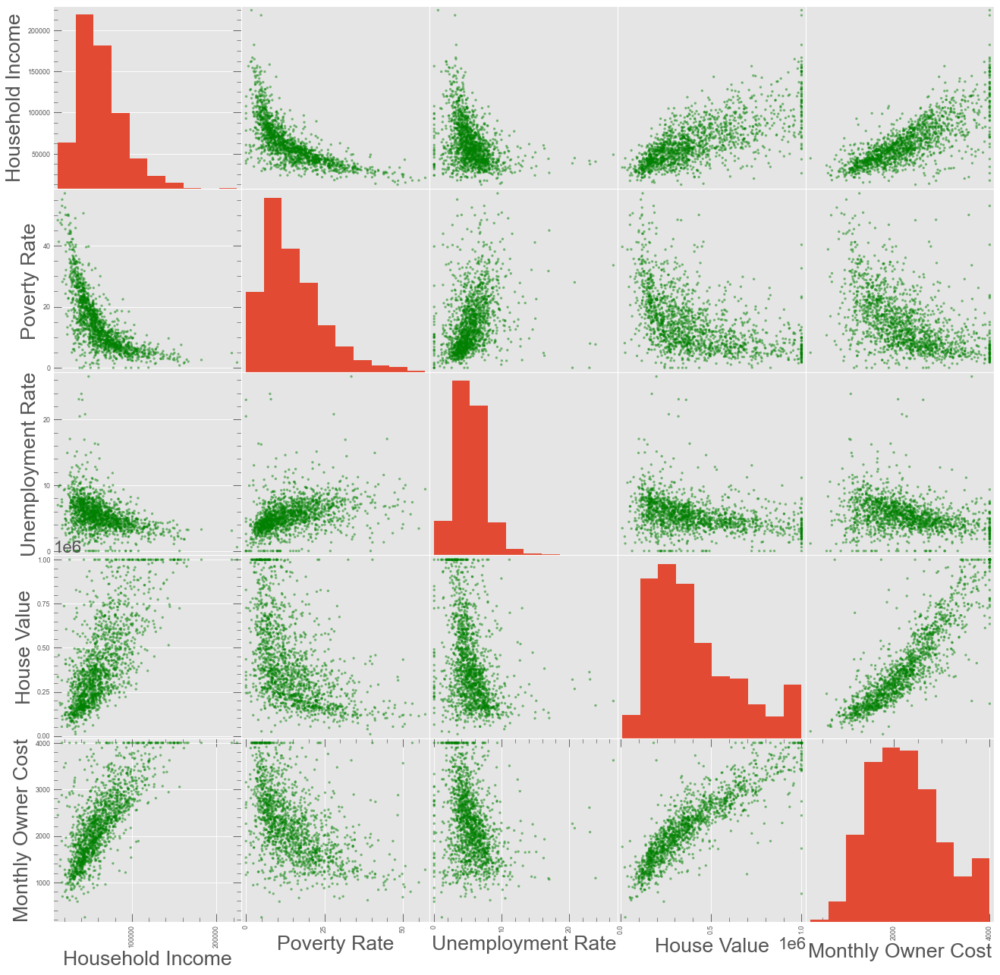

In [6]:
# to plot all selected columns
col=ca_2012[[ 'Household Income',
        'Poverty Rate', 'Unemployment Rate', 'House Value',
        'Monthly Owner Cost', ]]

pd.plotting.scatter_matrix(col,c='g', figsize=(20,20))
plt.show()


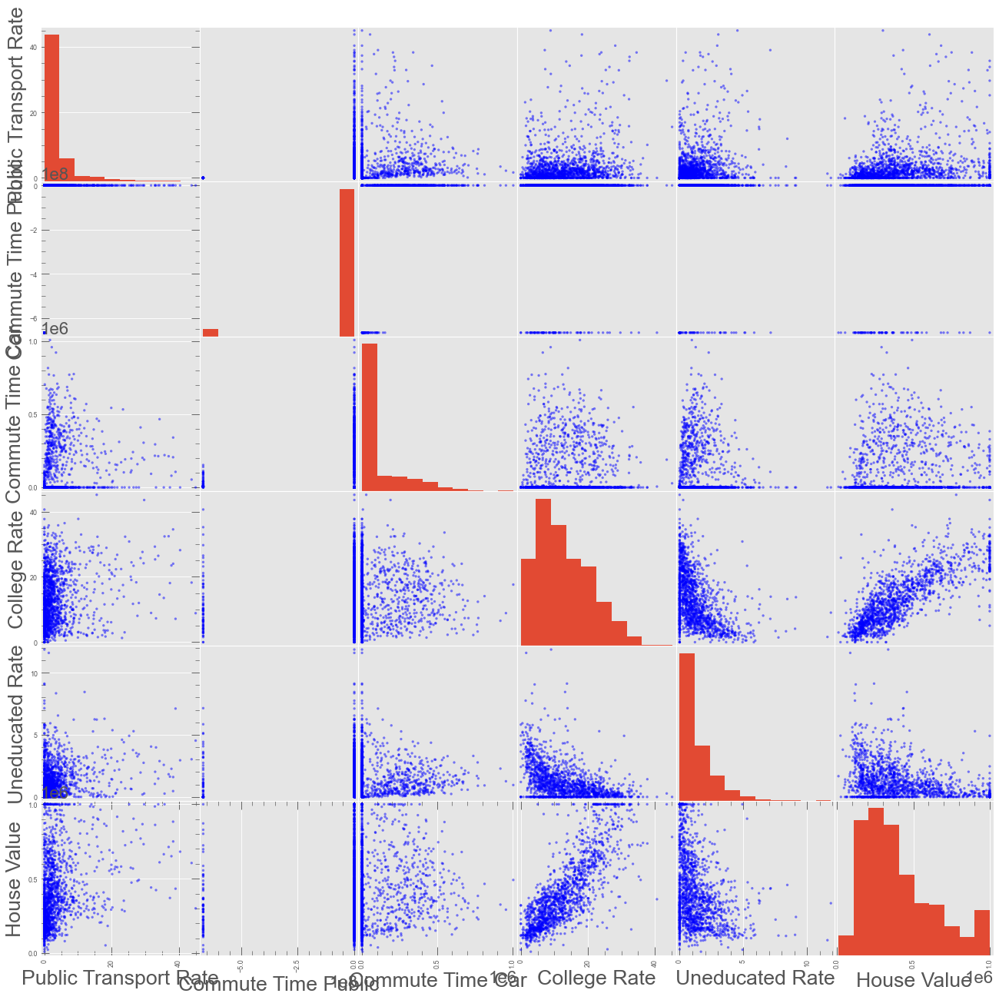

In [7]:
# to plot all selected columns
cols=ca_2012[['Public Transport Rate',
       'Commute Time Public', 'Commute Time Car', 
       'College Rate', 'Uneducated Rate','House Value' ]]

pd.plotting.scatter_matrix(cols,c='b', figsize=(20,20))
plt.show()

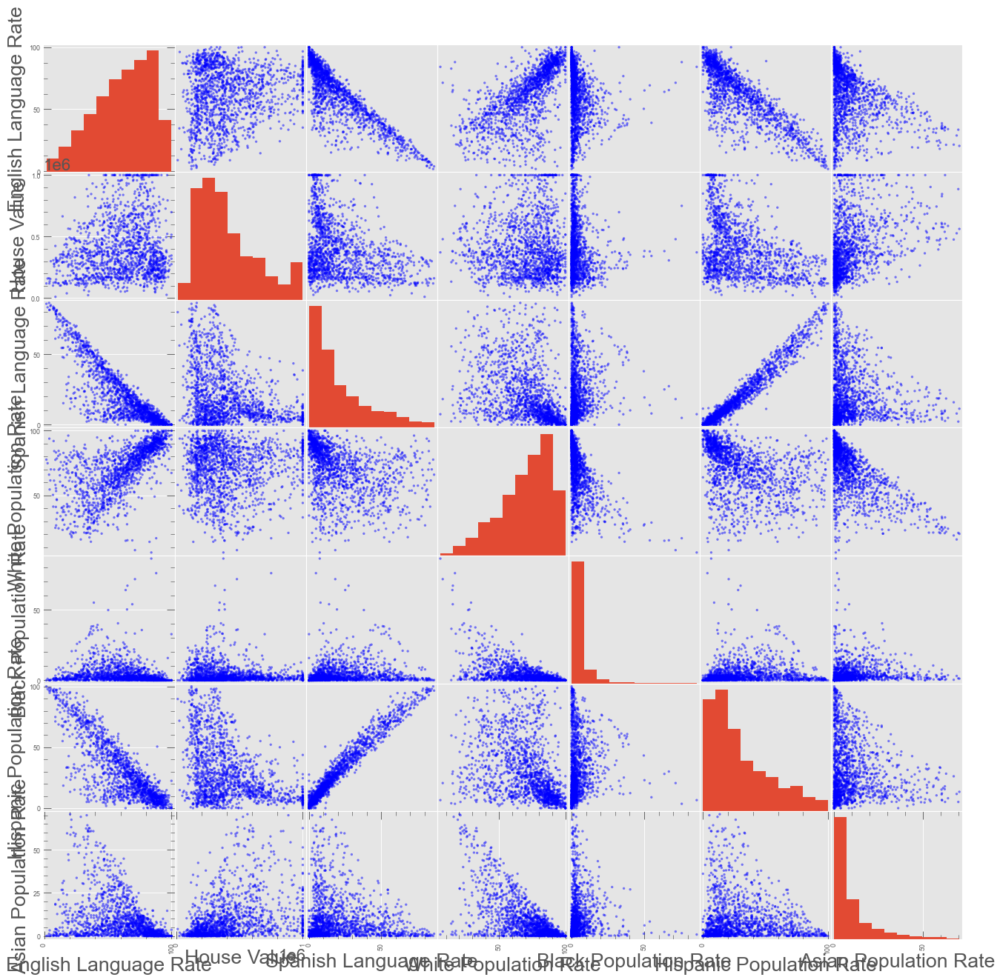

In [8]:
# to plot all selected columns
cols=ca_2012[[  'English Language Rate','House Value',
       'Spanish Language Rate', 'White Population Rate',
       'Black Population Rate', 'Hispanic Population Rate',
       'Asian Population Rate' ]]

pd.plotting.scatter_matrix(cols,c='b', figsize=(20,20))
plt.show()      


In [ ]:
## 

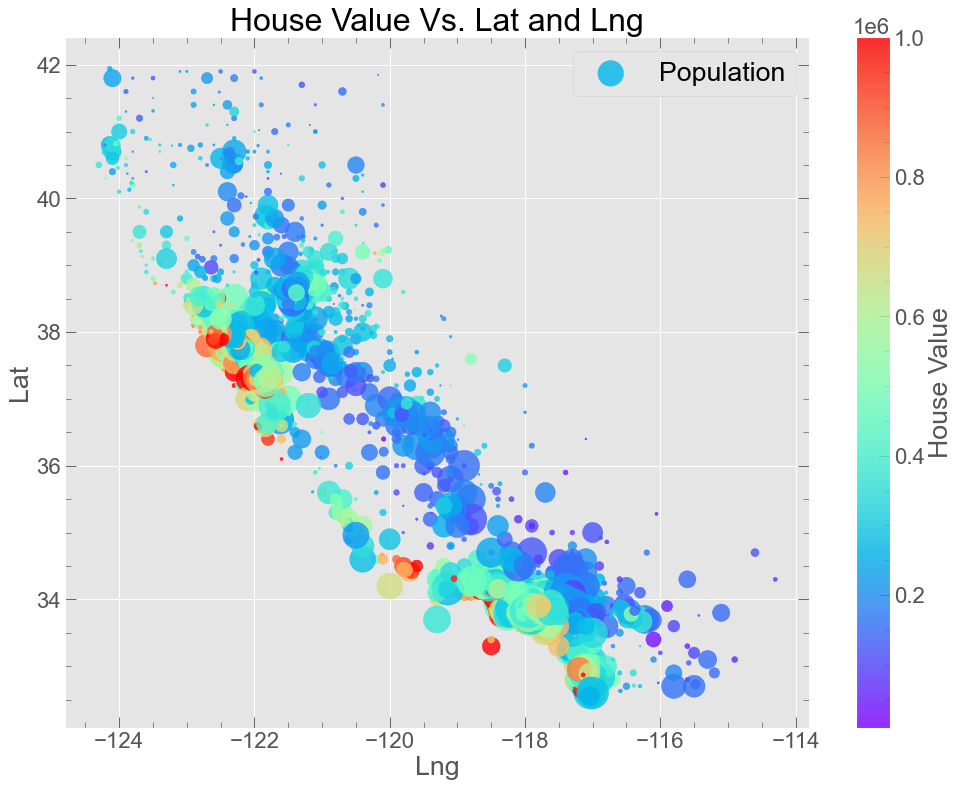

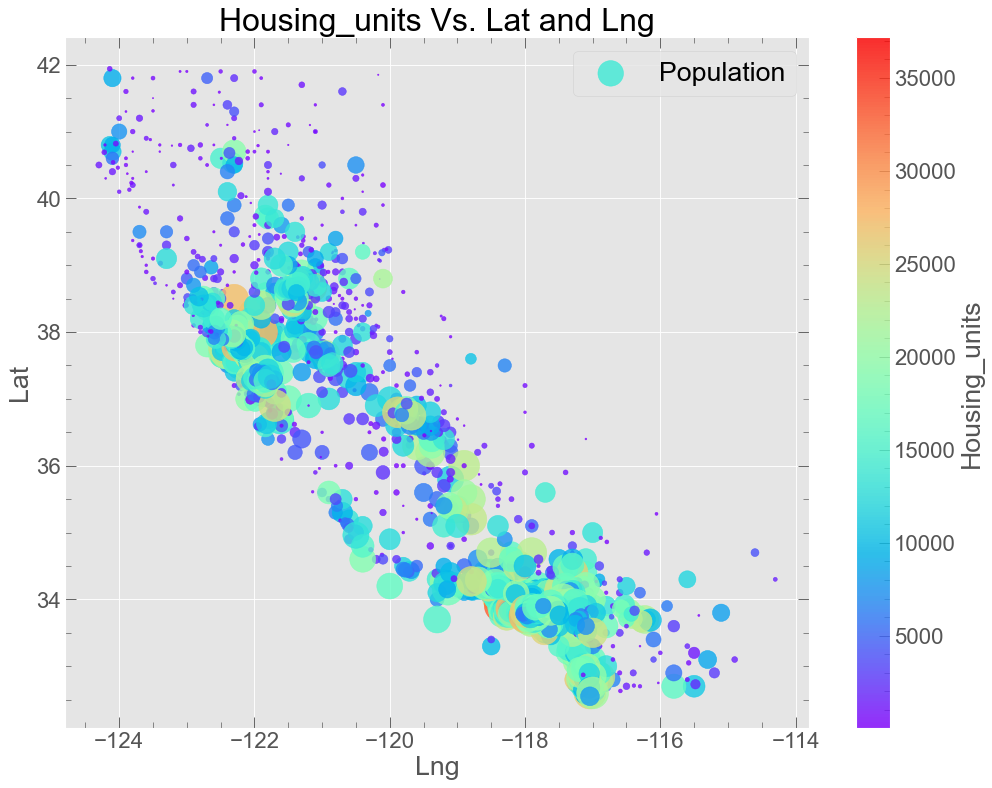

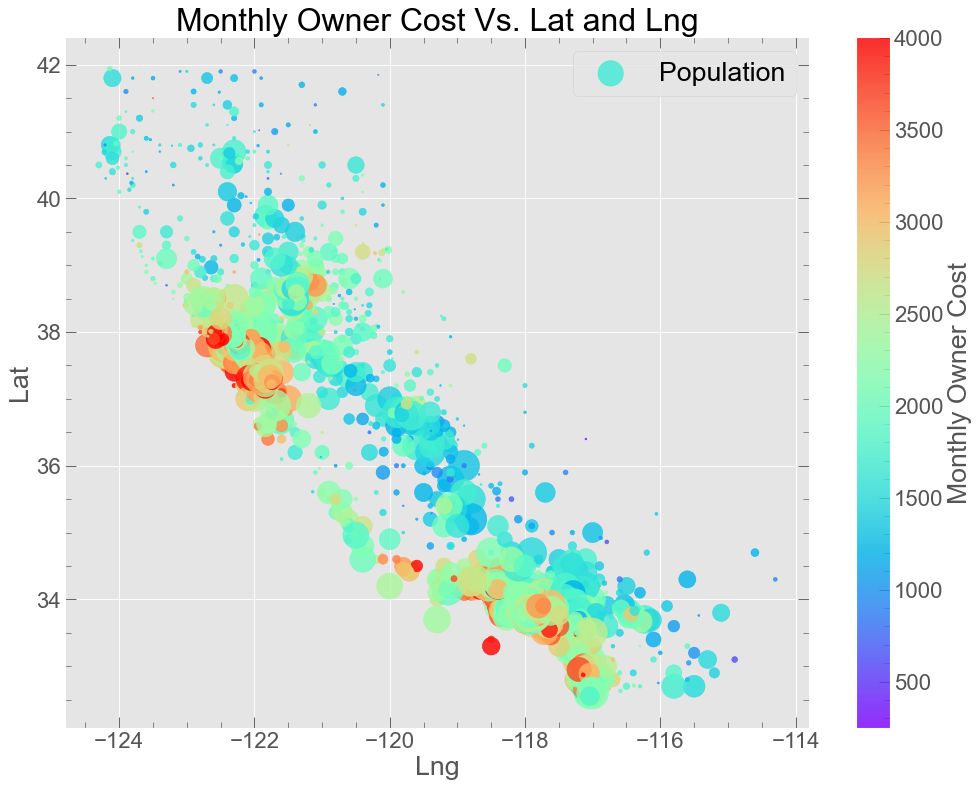

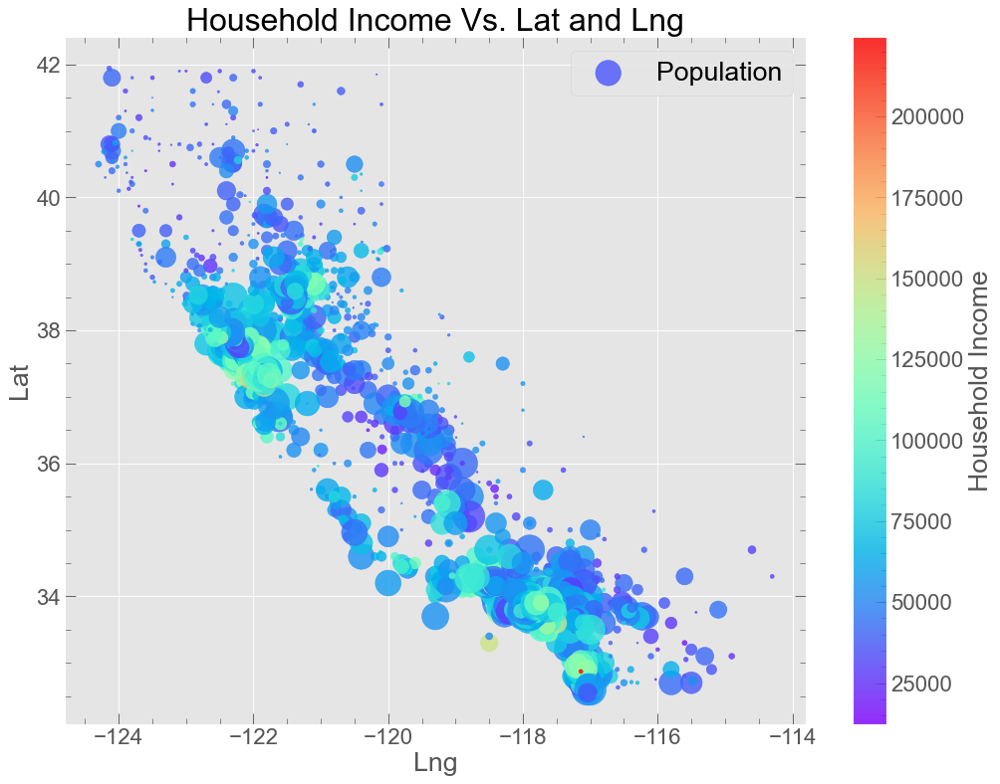

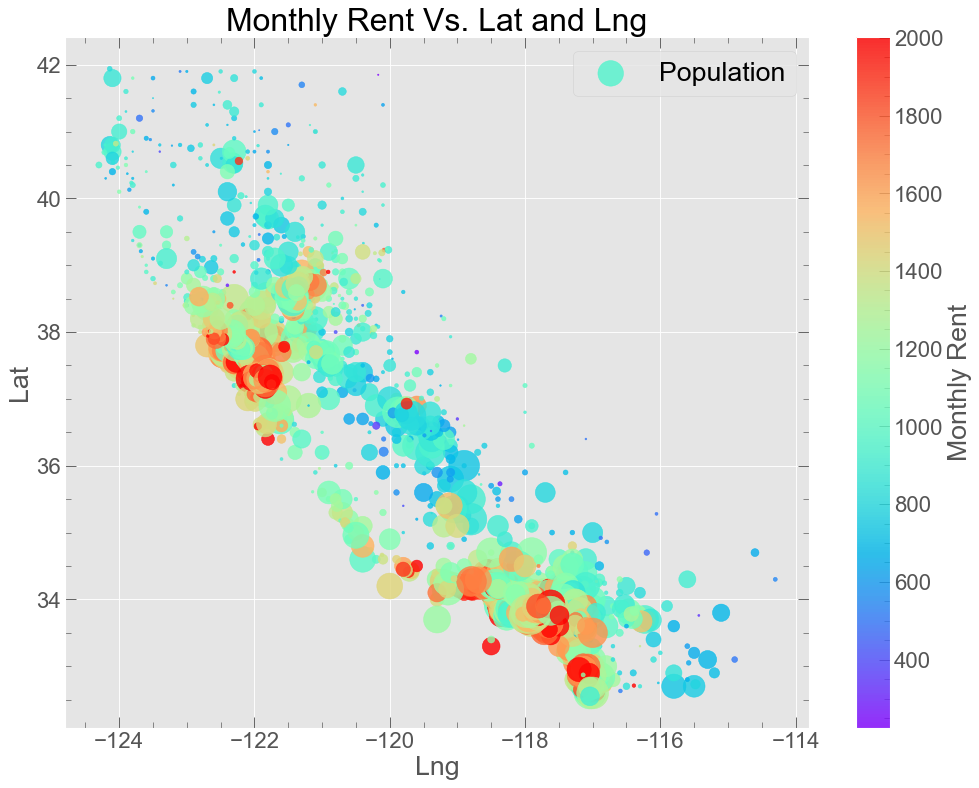

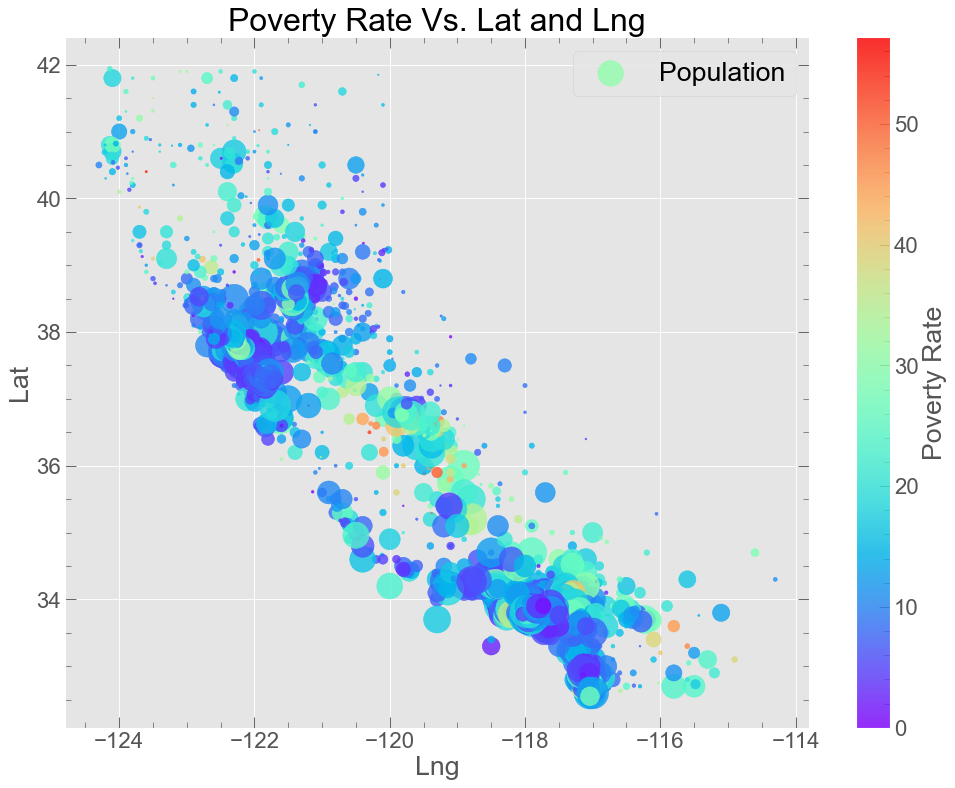

In [9]:
#
c=['House Value','Housing_units','Monthly Owner Cost','Household Income',
  'Monthly Rent','Poverty Rate']
for i in range(1, 7):
    fig = plt.figure(figsize=(15,80))
    ax = fig.add_subplot(6, 1, i)
    
    ca_2012.plot(kind='scatter', x='Lng', y='Lat', alpha=0.8, 
                s=ca_2012['Population']/100,label='Population',
                 c=c[i-1], cmap=plt.get_cmap('rainbow'),
                colorbar=True, ax=ax)
    ax.set_title(f'{c[i-1]} Vs. Lat and Lng')

plt.show()

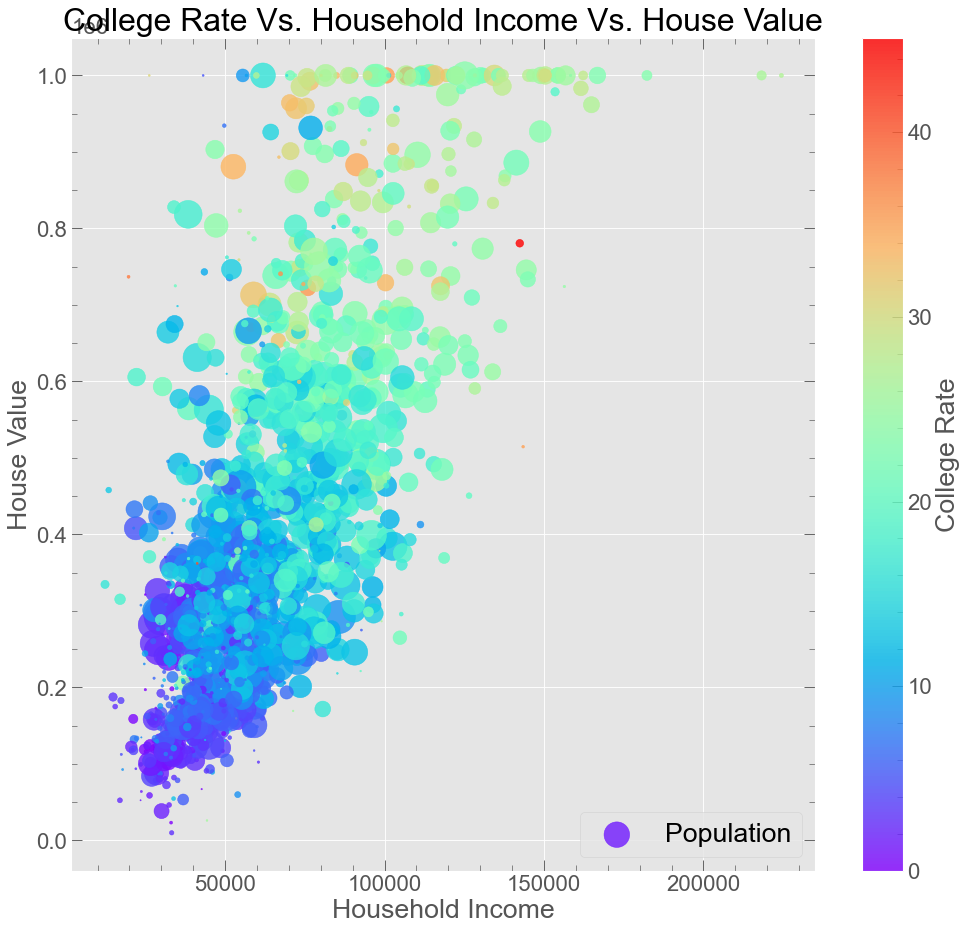

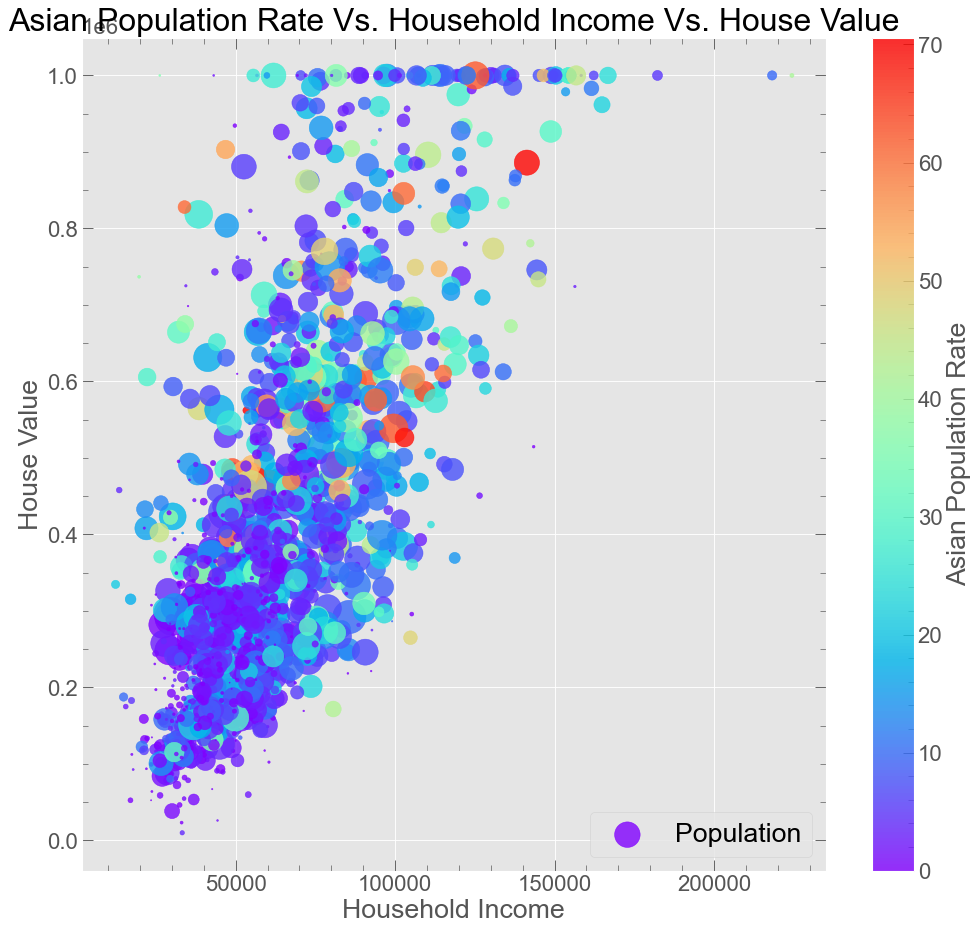

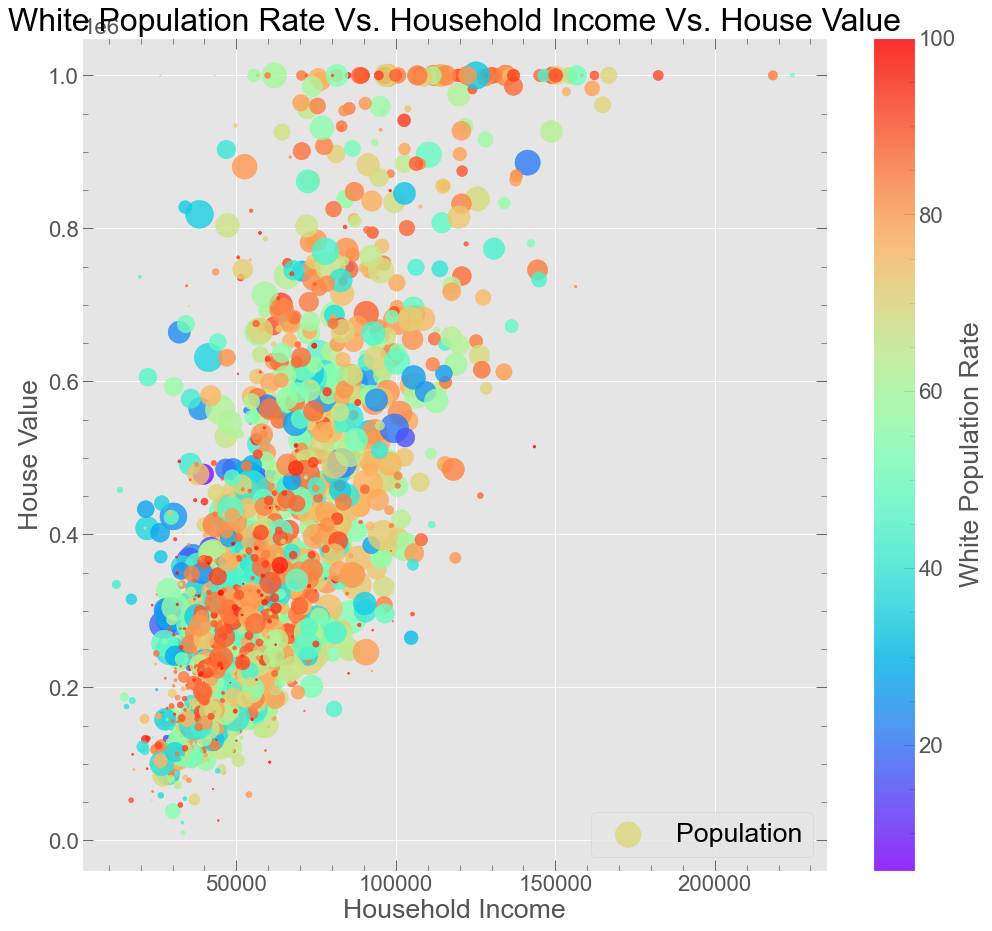

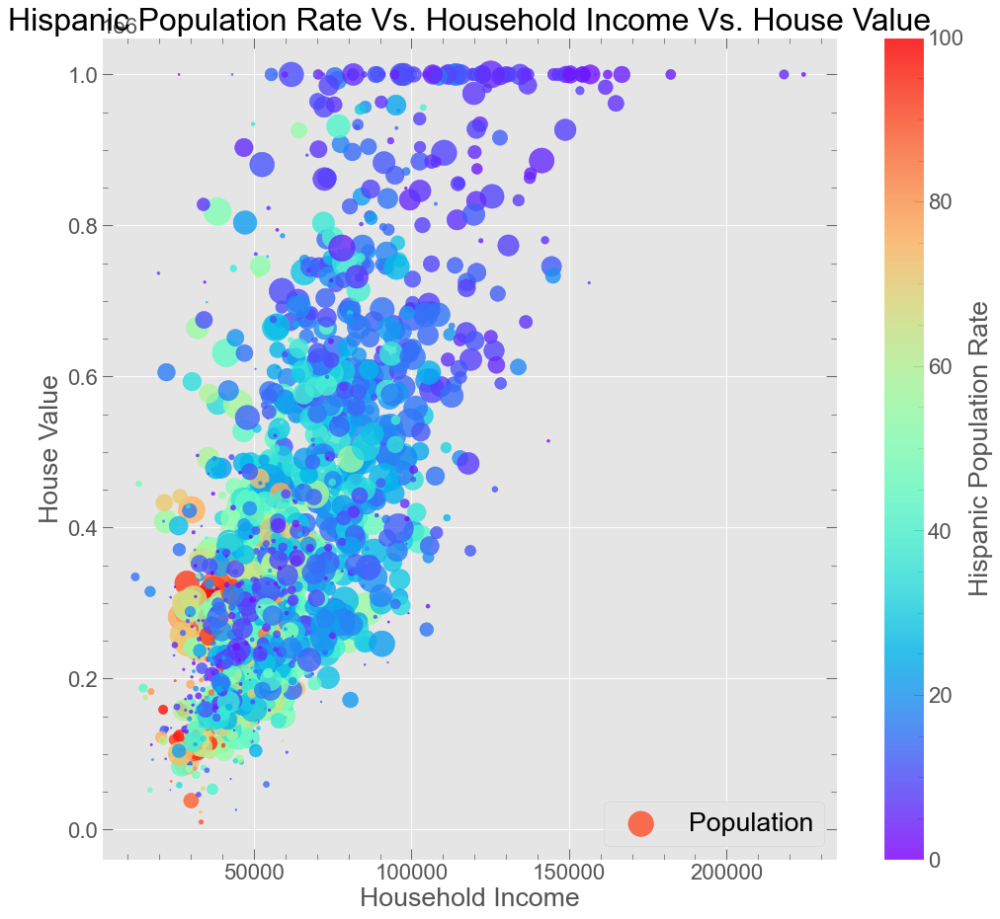

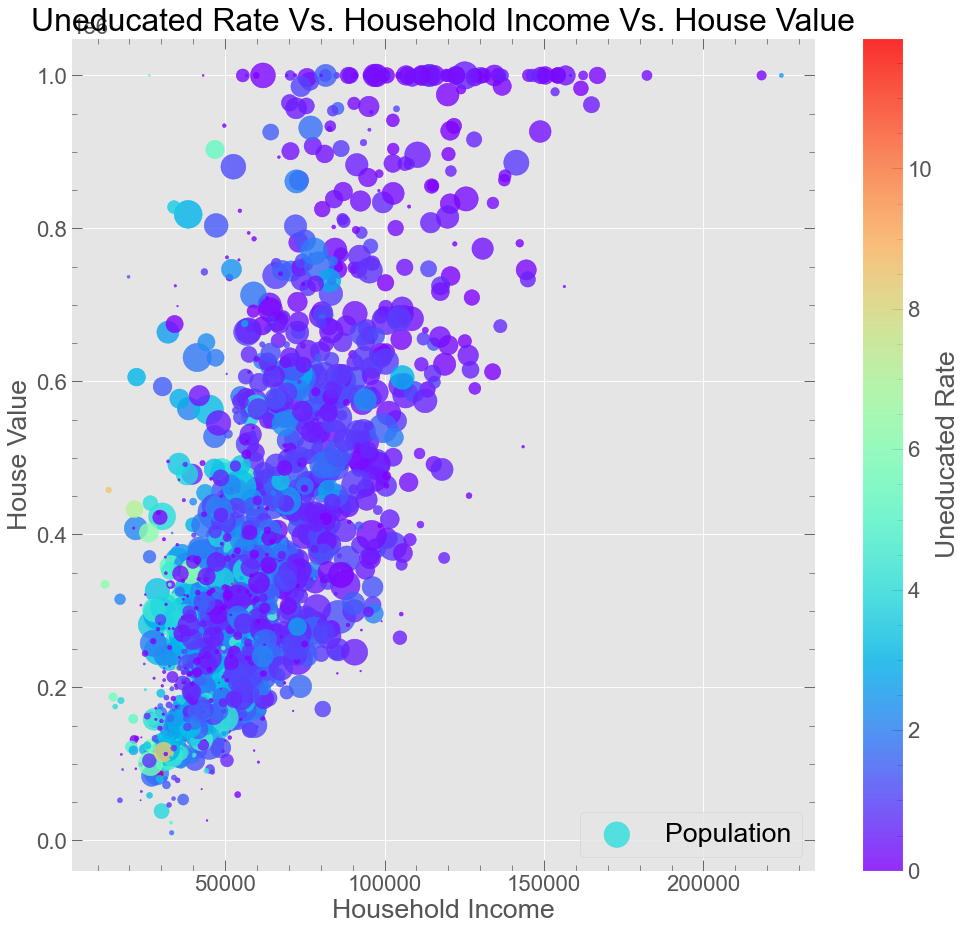

In [10]:
#
c=['College Rate','Asian Population Rate','White Population Rate',
  'Hispanic Population Rate','Uneducated Rate']
for i in range(1, 6):
    fig = plt.figure(figsize=(15,80))
    ax = fig.add_subplot(5, 1, i)
    
    ca_2012.plot(kind='scatter', x='Household Income', y='House Value',
                 alpha=0.8, 
                s=ca_2012['Population']/100,label='Population',
                 c=c[i-1], cmap=plt.get_cmap('rainbow'),
                colorbar=True, ax=ax)
    ax.set_title(f'{c[i-1]} Vs. Household Income Vs. House Value')

plt.show()

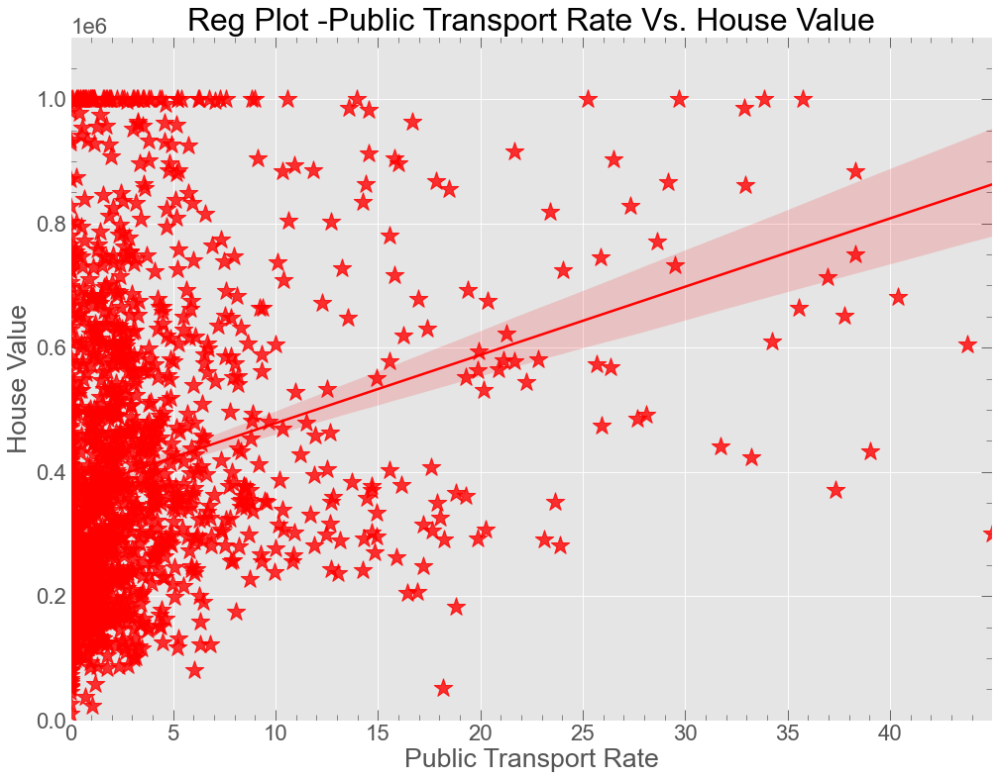

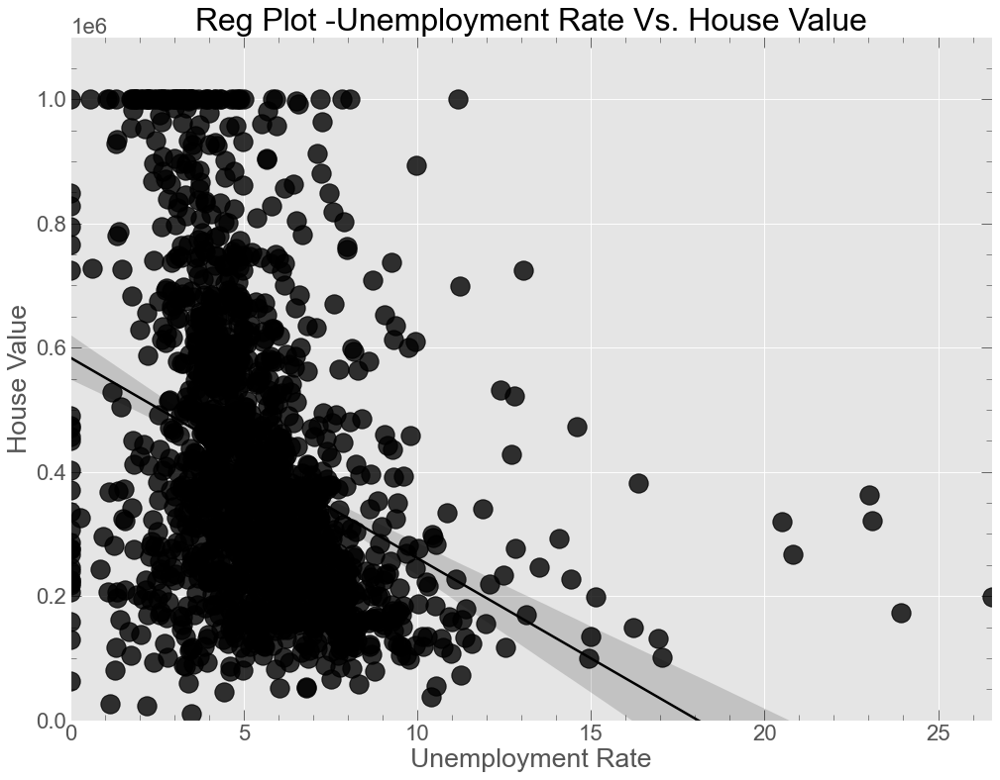

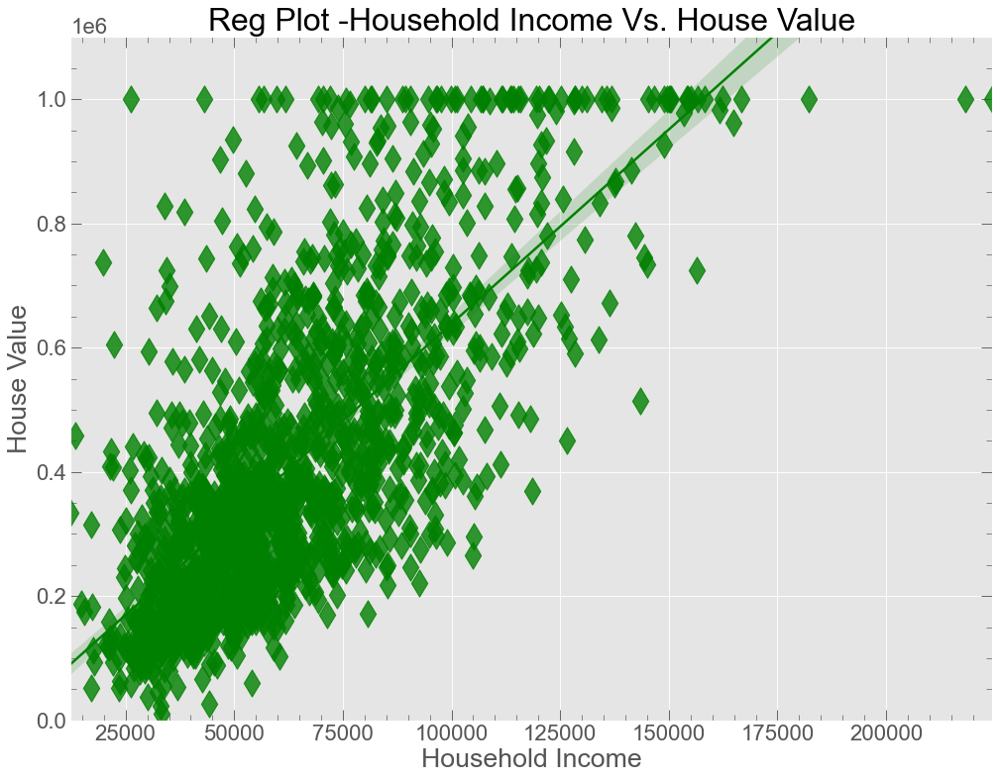

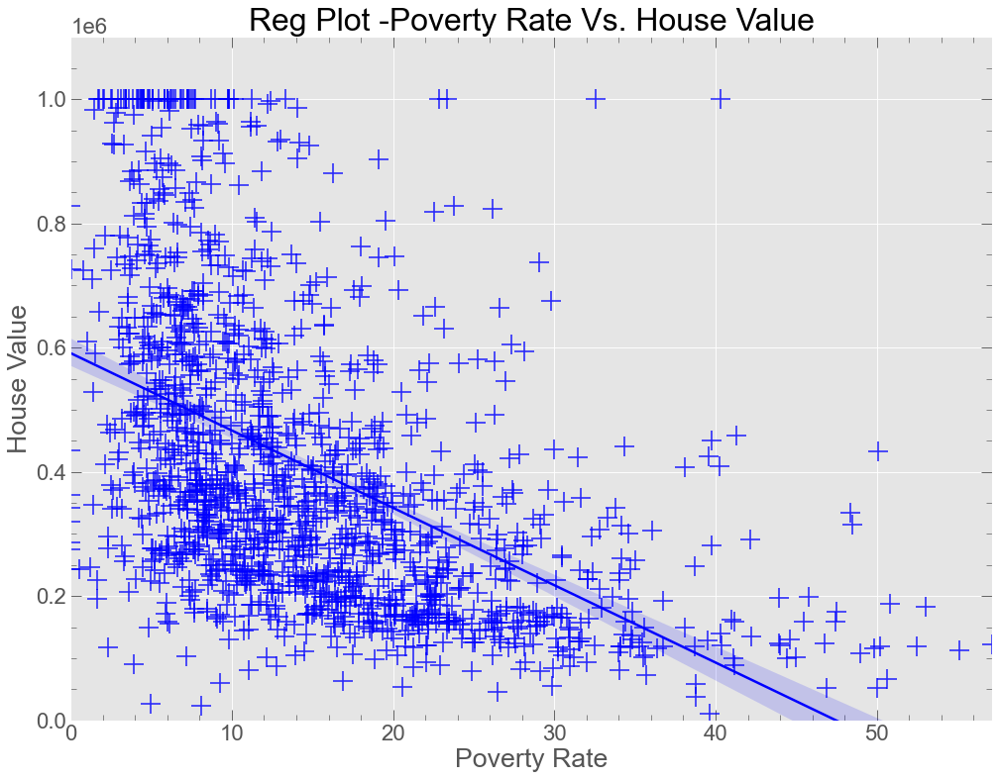

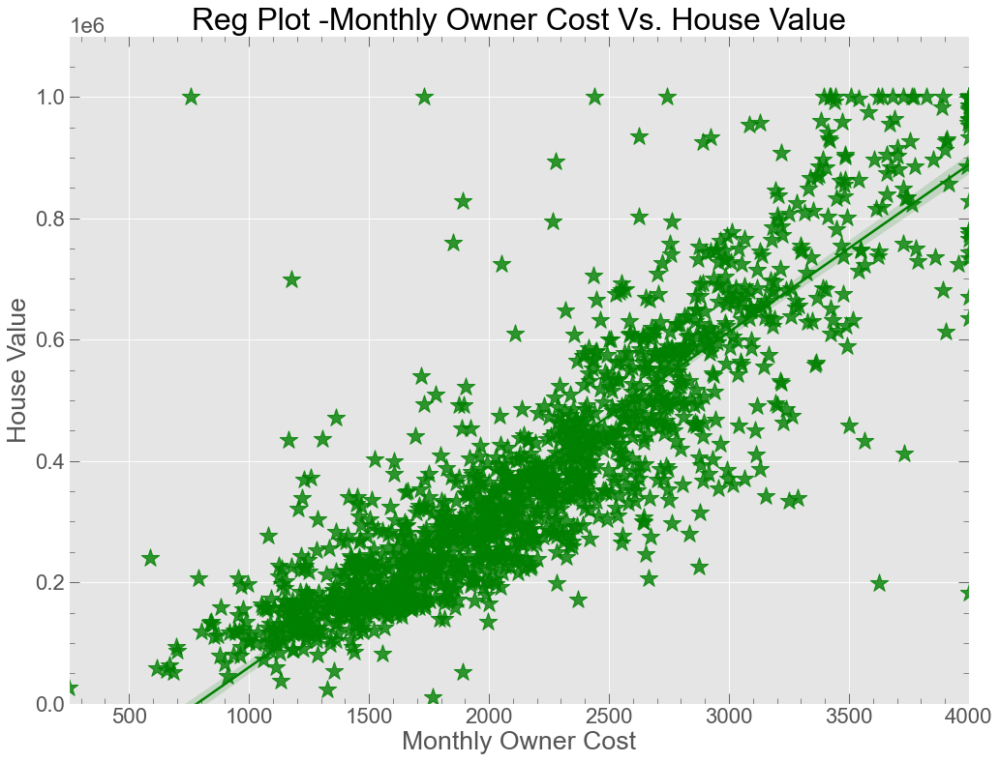

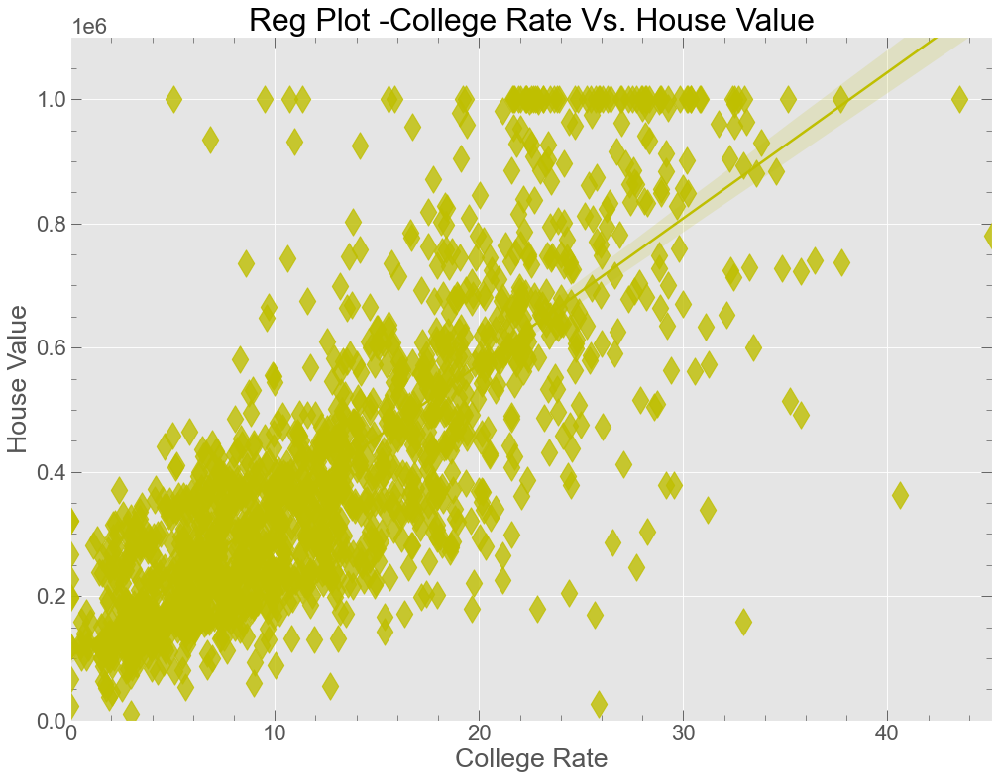

In [11]:
#using seaborn barplot
c=['Public Transport Rate','Unemployment Rate','Household Income',
  'Poverty Rate','Monthly Owner Cost','College Rate']
marker=["*","o","d","+","*","d"]
color=['r','k','g','b','g','y','b']
for i in range(1, 7):
    fig = plt.figure(figsize=(15,80))
    ax = fig.add_subplot(6, 1, i)
    
    sns.regplot(x=c[i-1], y='House Value',
           data=ca_2012,color=color[i-1],marker=marker[i-1],
            scatter_kws={'s':300},ax=ax);

    ax.set_ylim([0, 1100000])

    ax.set_xlabel(f'{c[i-1]}')
    ax.set_ylabel('House Value')
    ax.set_title(f'Reg Plot -{c[i-1]} Vs. House Value')

plt.show()

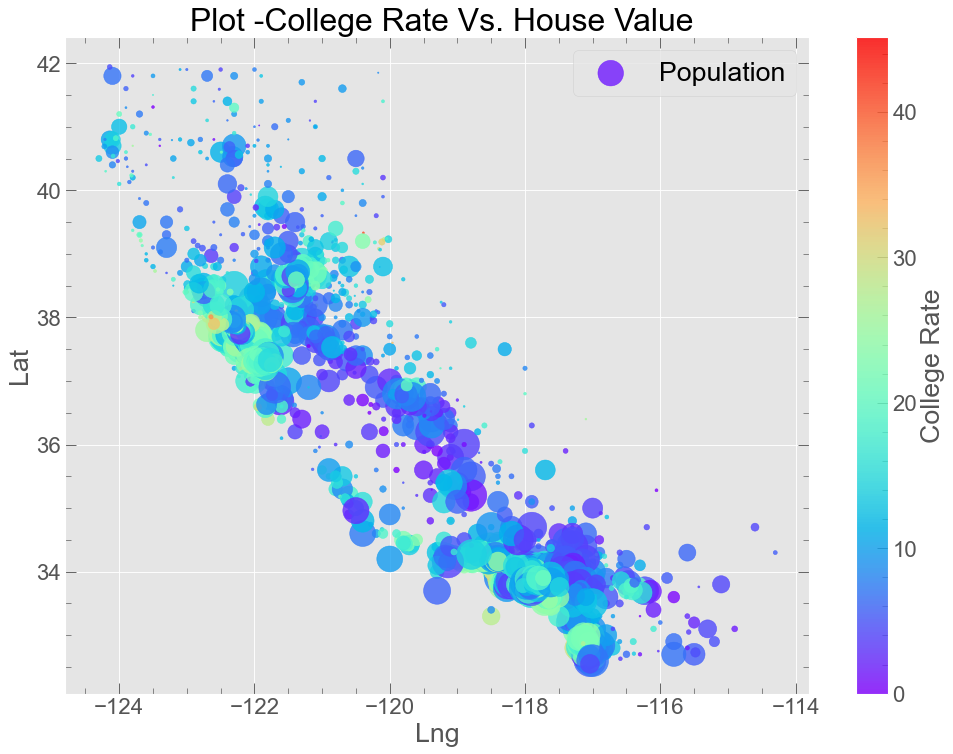

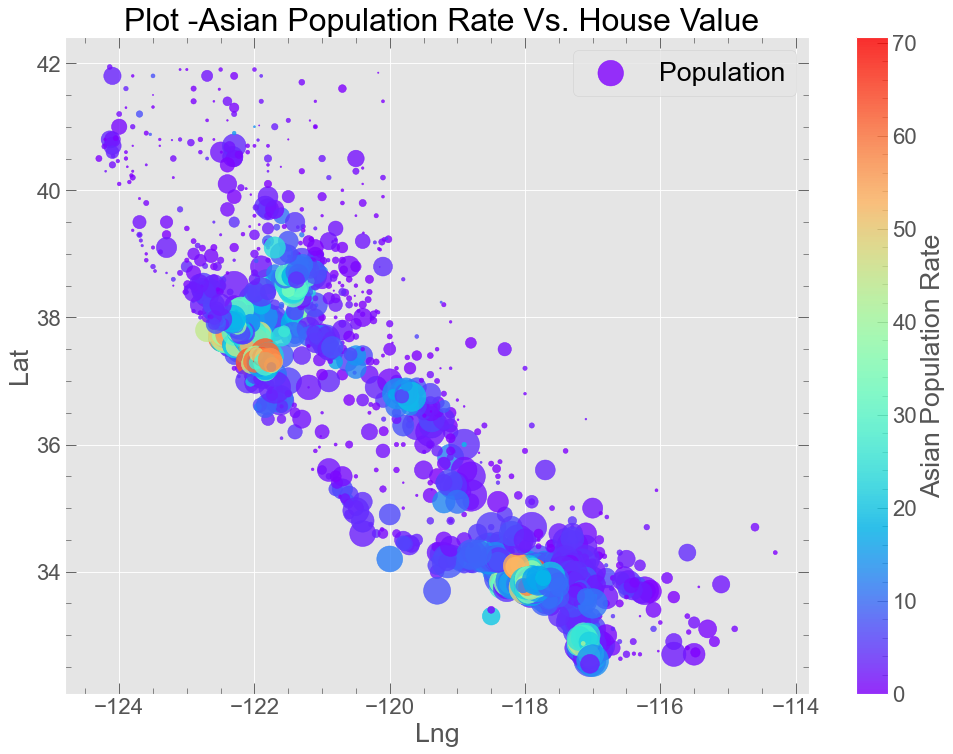

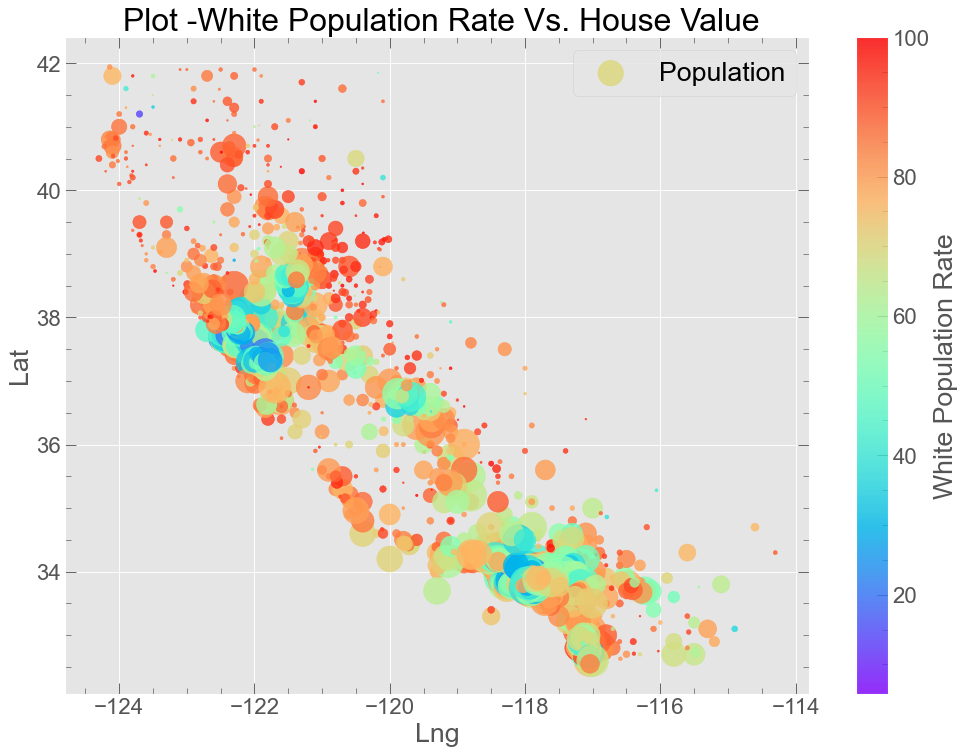

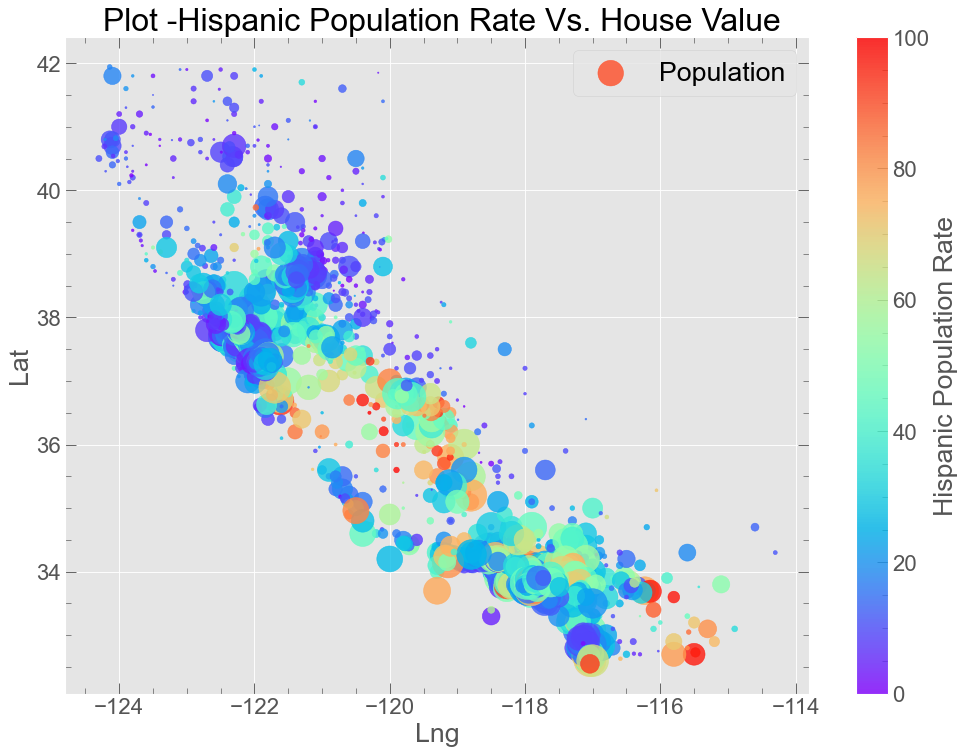

In [12]:
#
c=['College Rate','Asian Population Rate','White Population Rate',
  'Hispanic Population Rate']
for i in range(1, 5):
    fig = plt.figure(figsize=(15,50))
    ax = fig.add_subplot(4, 1, i)
    
    ca_2012.plot(kind='scatter', x='Lng', y='Lat', alpha=0.8, 
                s=ca_2012['Population']/100,label='Population',
                 c=c[i-1], cmap=plt.get_cmap('rainbow'),
                colorbar=True, ax=ax)

    #ax.set_xlabel(f'{c[i-1]}')
    #ax.set_ylabel('House Value')
    ax.set_title(f' Plot -{c[i-1]} Vs. House Value')

plt.show()

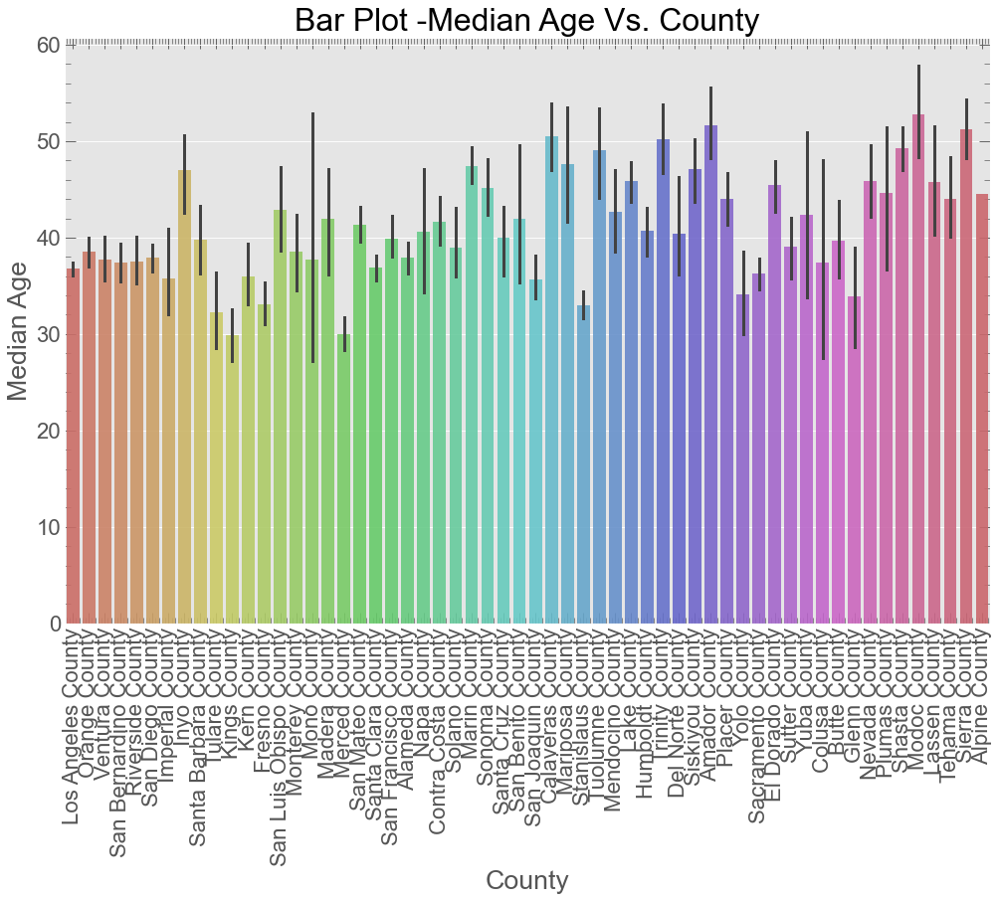

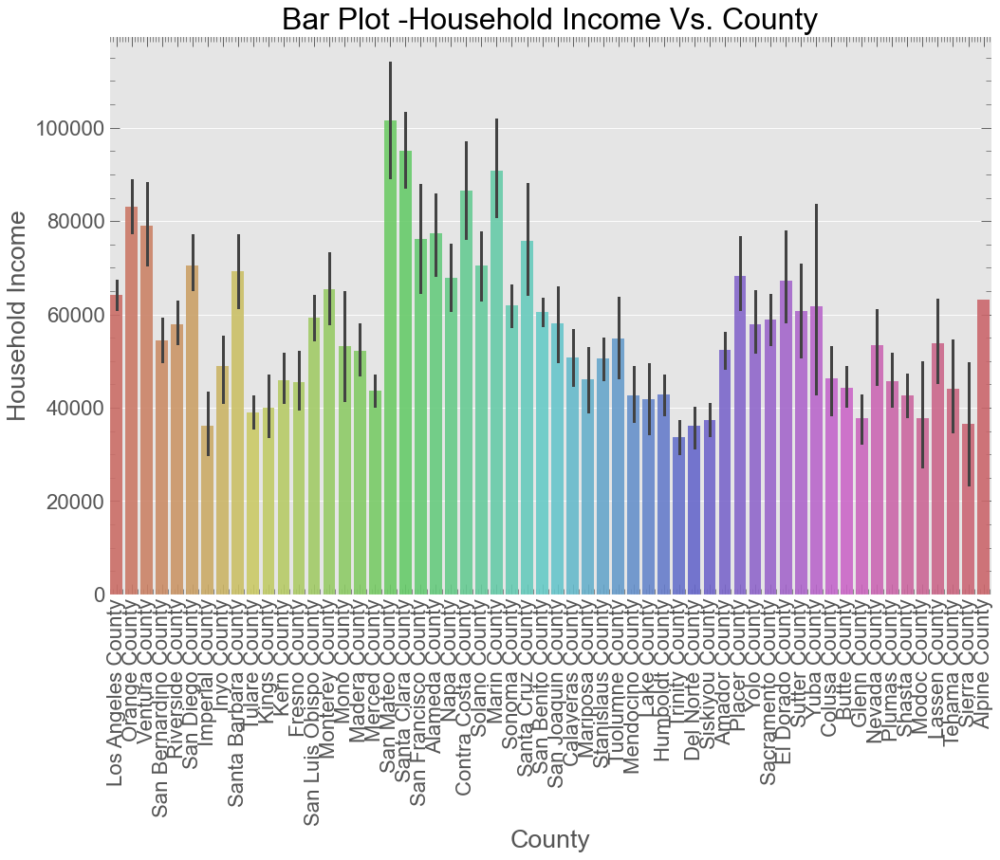

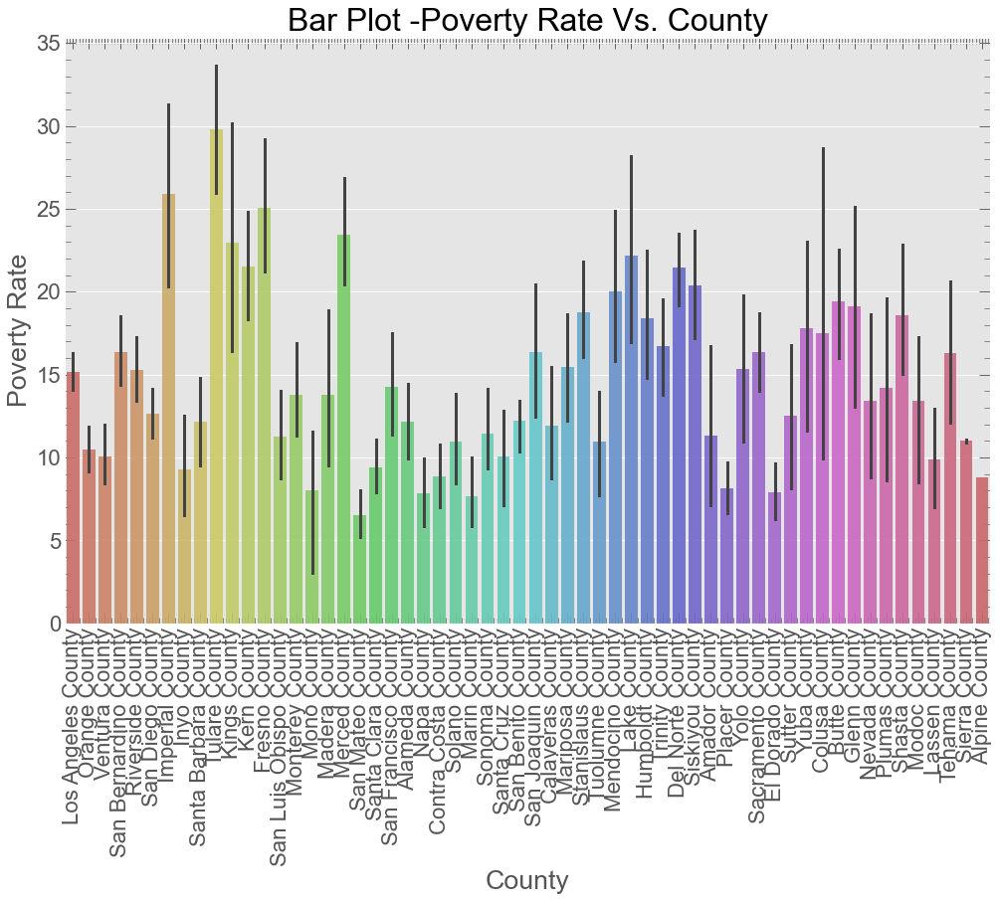

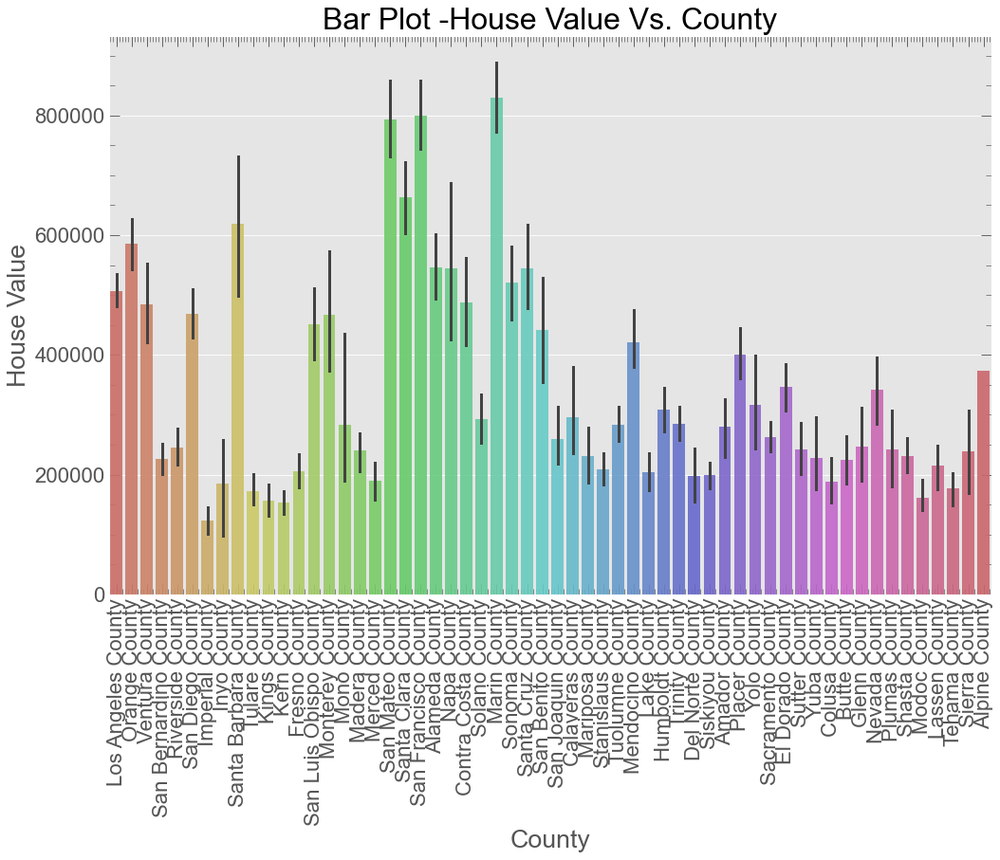

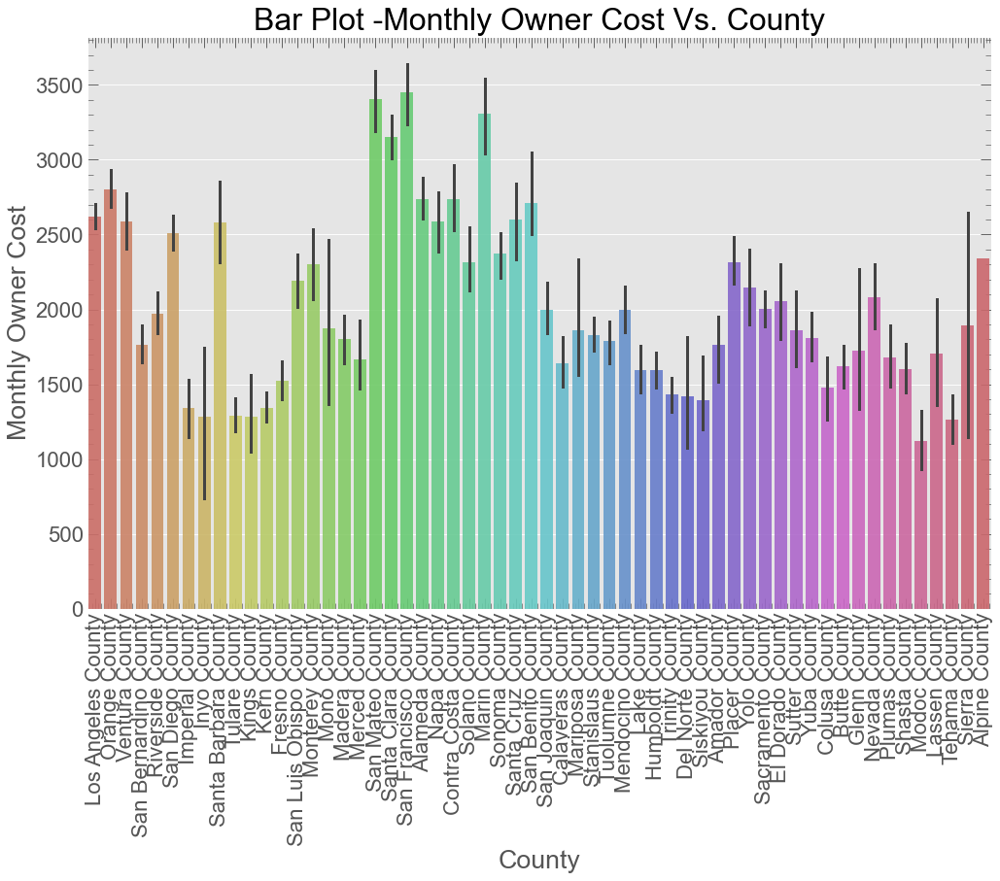

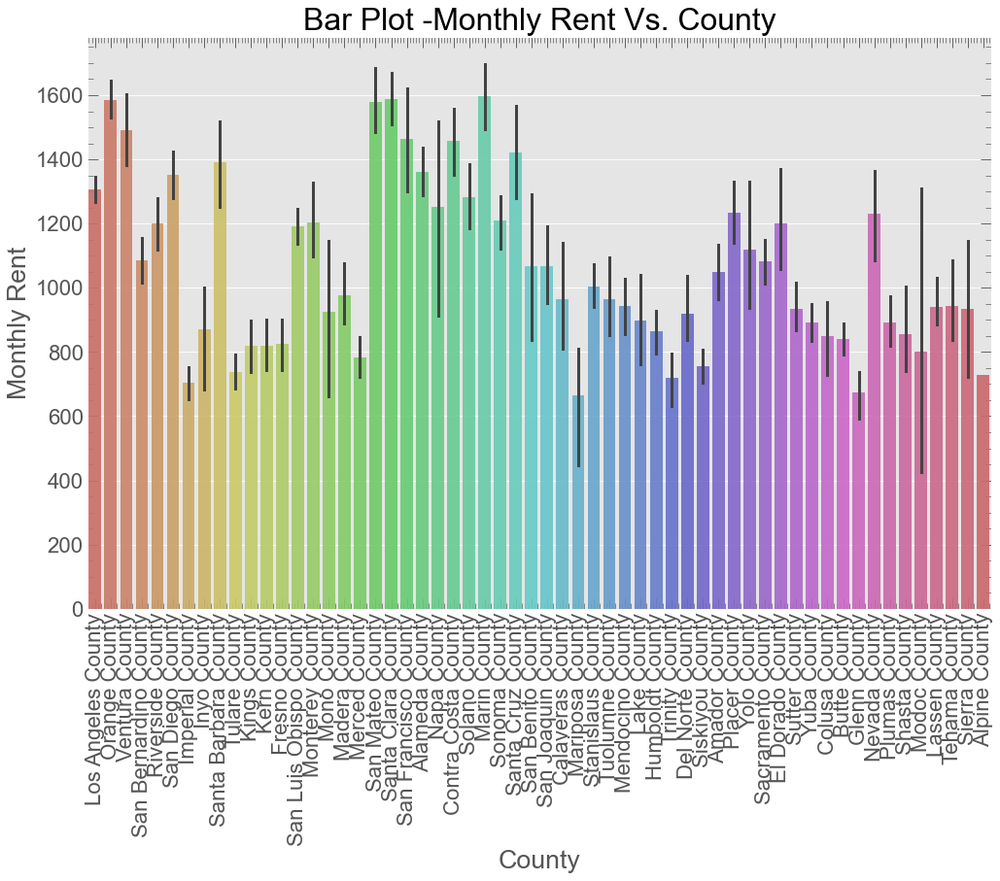

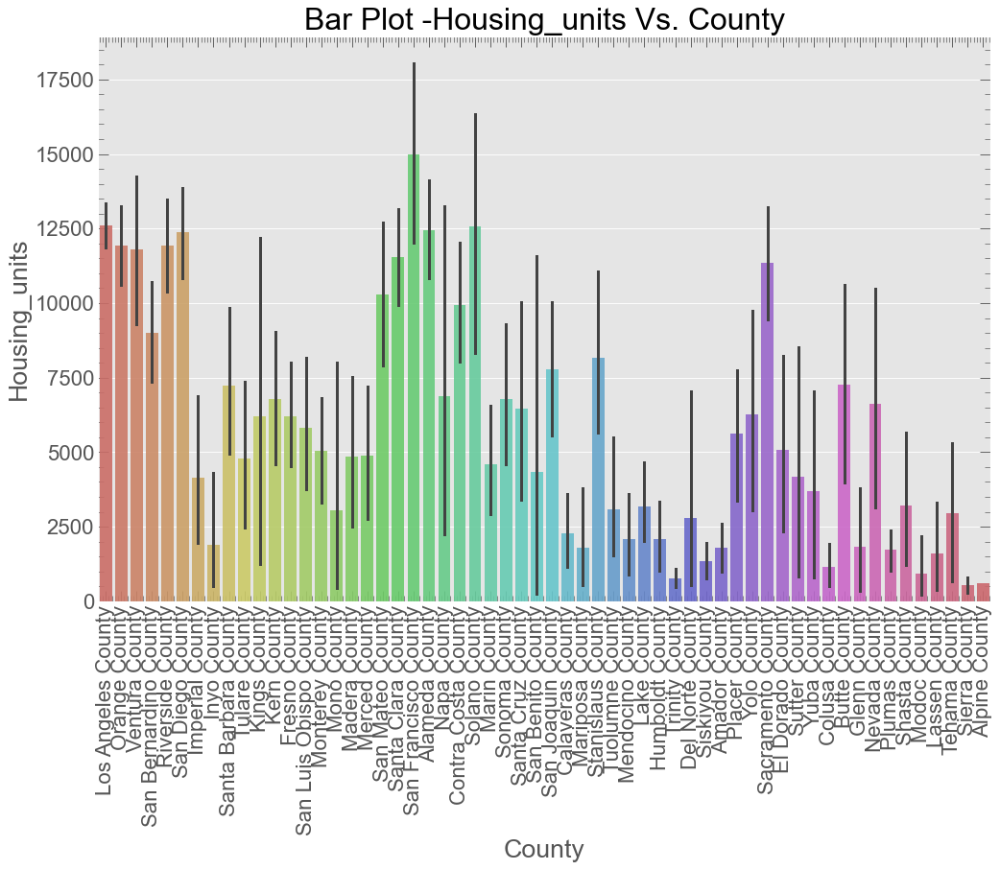

In [13]:
#
c=['Median Age', 'Household Income','Poverty Rate', 'House Value',
       'Monthly Owner Cost', 'Monthly Rent','Housing_units']

for i in range(1, 8):
    fig = plt.figure(figsize=(15,80))
    ax = fig.add_subplot(7, 1, i)
    
    sns.barplot(x='County', y=c[i-1],
            data=ca_2012, alpha=0.9, palette = 'hls',ax=ax)
    
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
    ax.set_ylabel(f'{c[i-1]}')
    ax.set_xlabel('County')
    ax.set_title(f'Bar Plot -{c[i-1]} Vs. County')

plt.show()


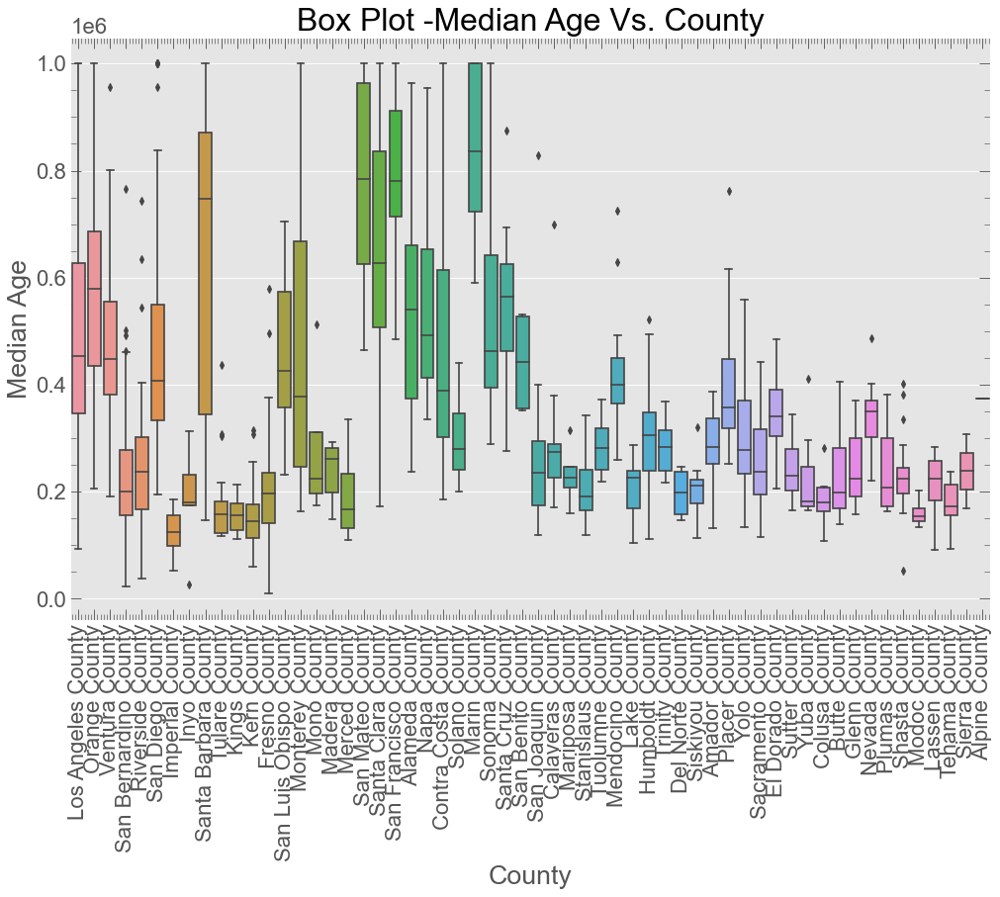

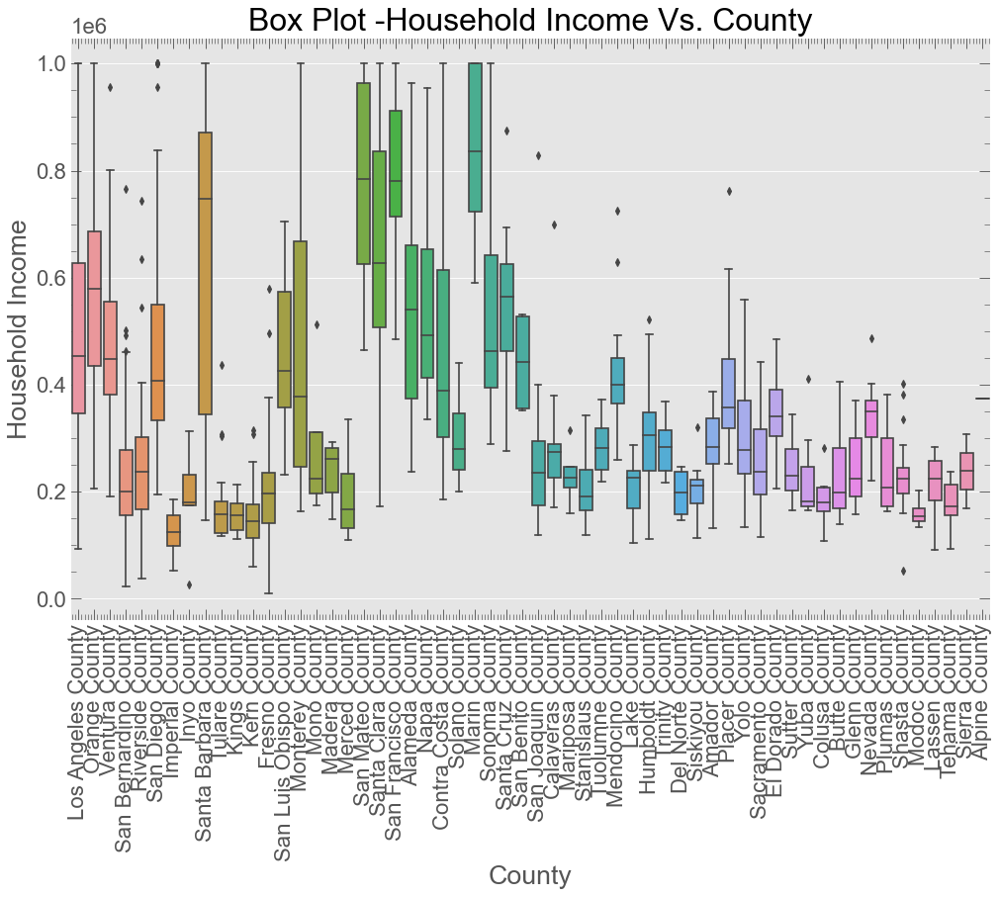

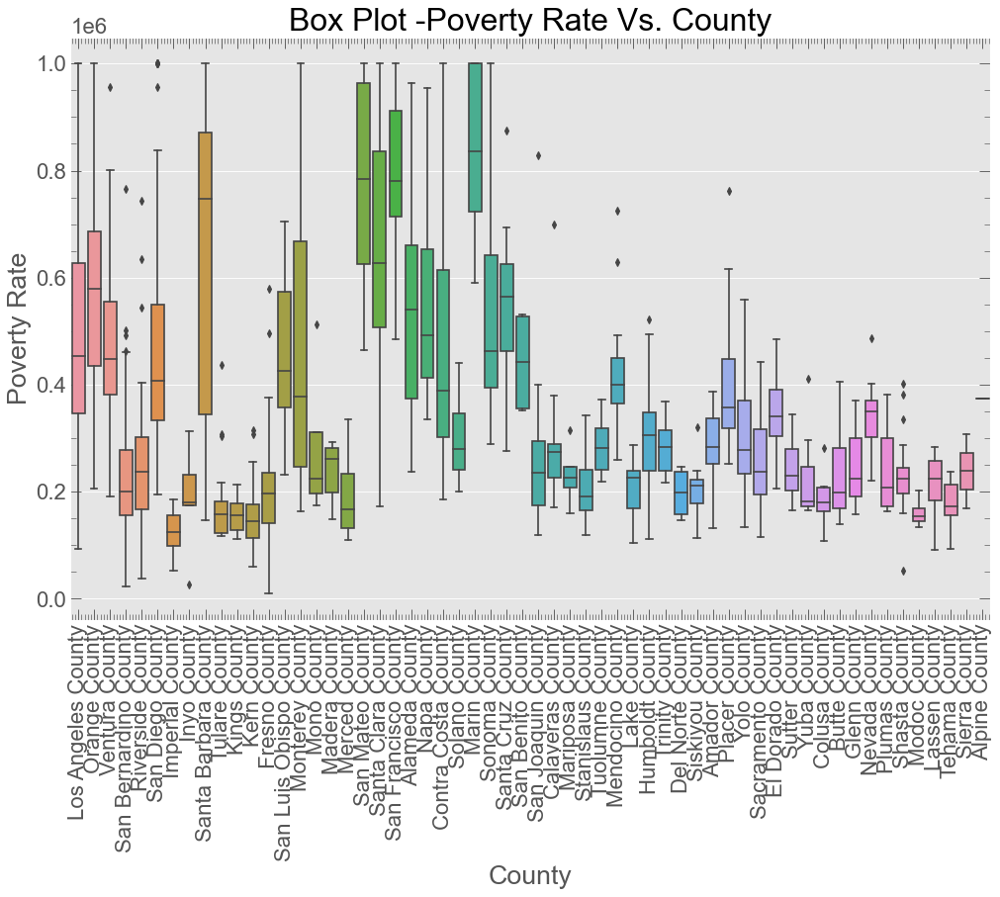

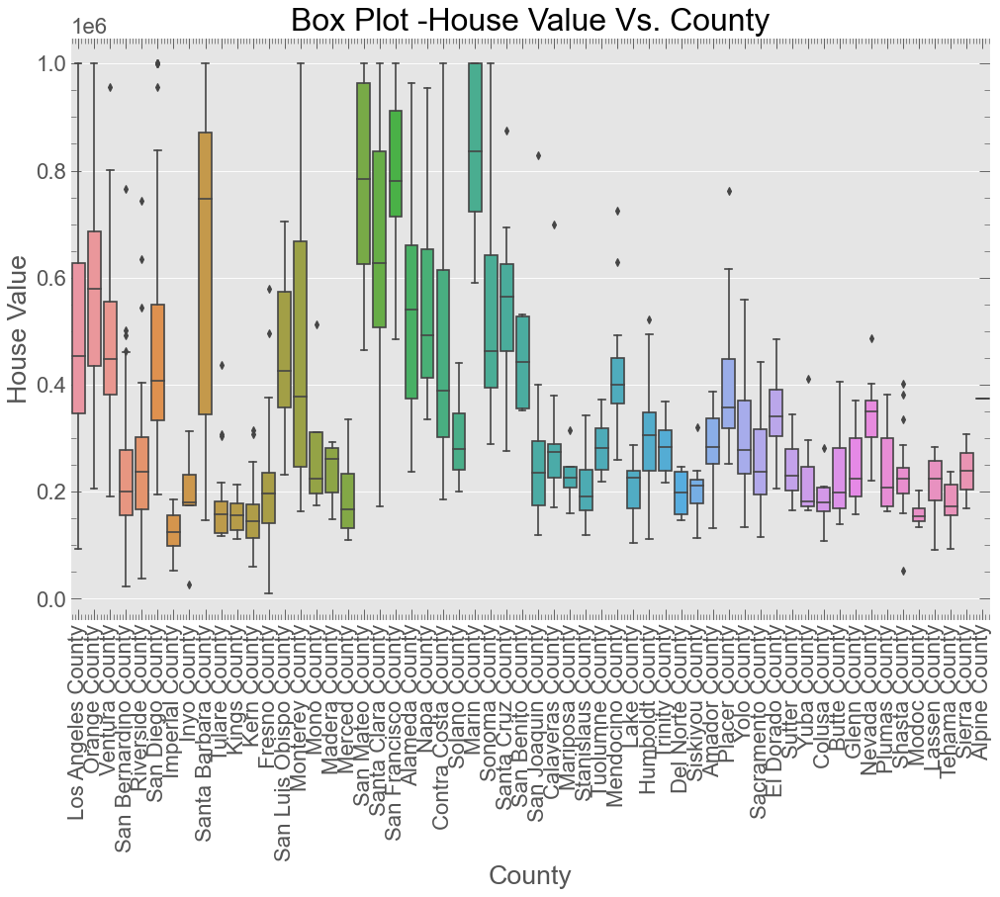

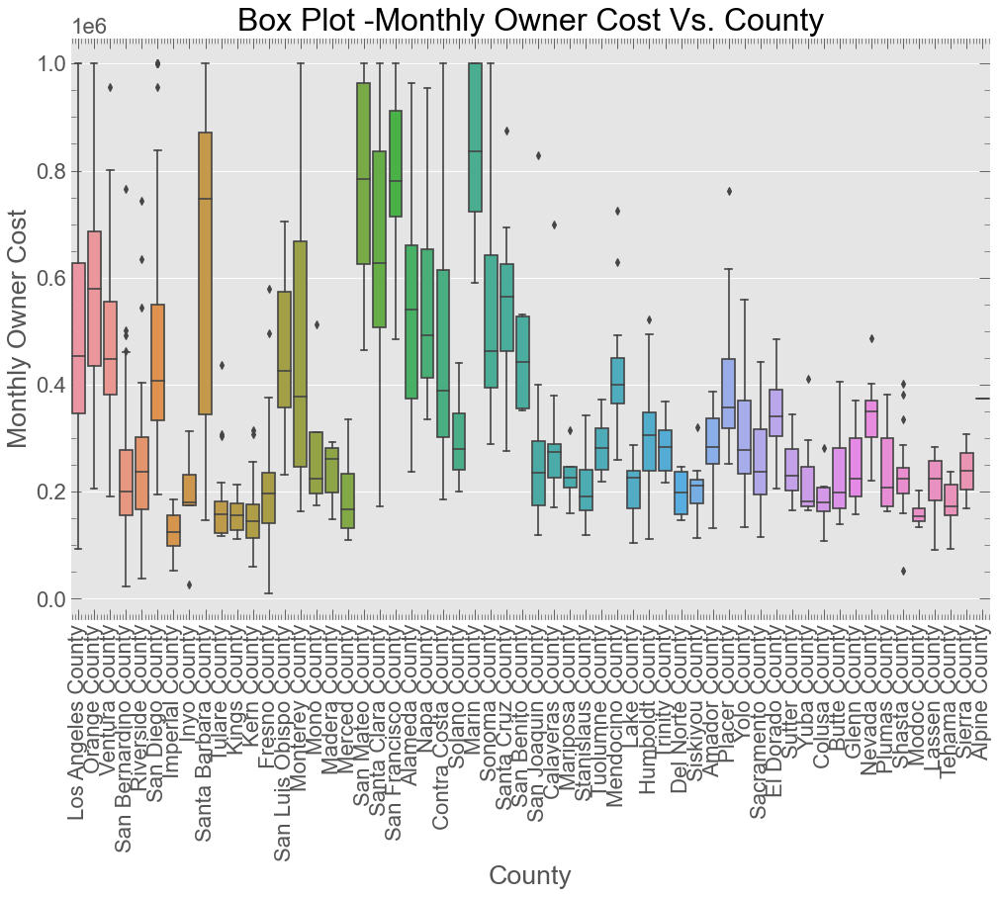

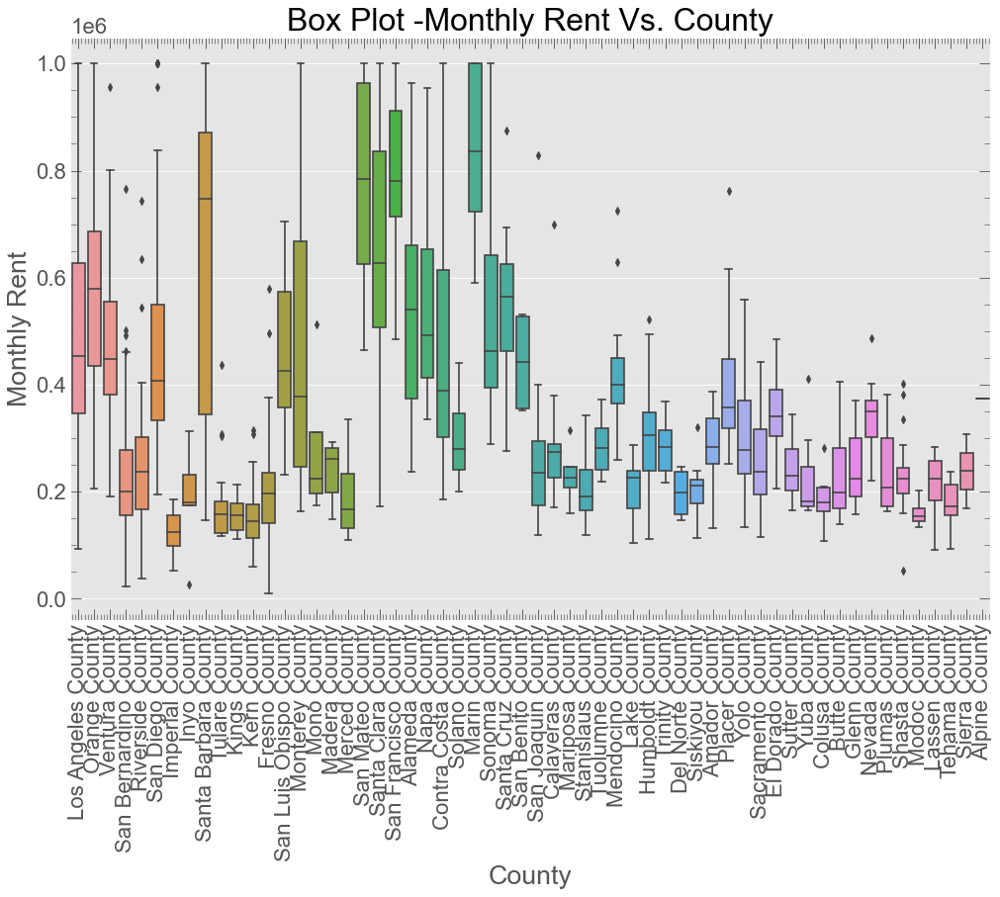

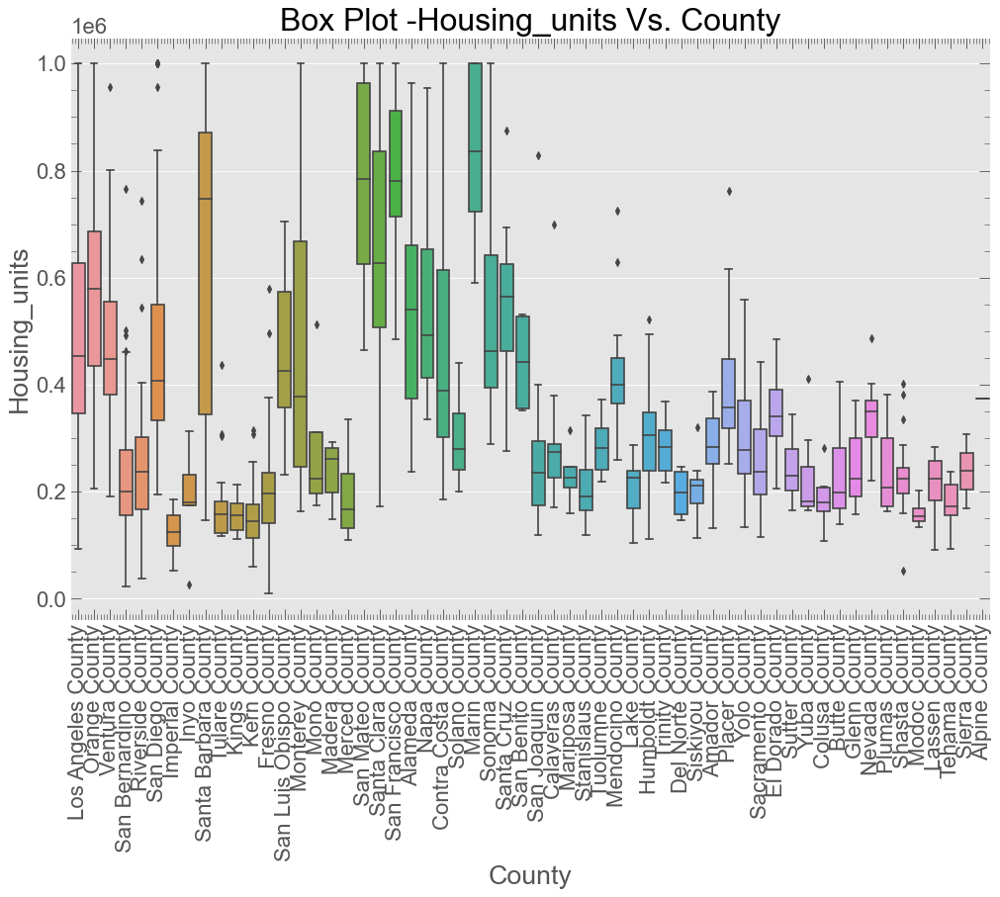

In [14]:
#
c=['Median Age', 'Household Income','Poverty Rate', 'House Value',
       'Monthly Owner Cost', 'Monthly Rent','Housing_units']

for i in range(1, 8):
    fig = plt.figure(figsize=(15,80))
    ax = fig.add_subplot(7, 1, i)
    
    sns.boxplot(x='County', y="House Value",data=ca_2012, ax=ax)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
    ax.set_ylabel(f'{c[i-1]}')
    ax.set_xlabel('County')
    ax.set_title(f'Box Plot -{c[i-1]} Vs. County')

plt.show()

In [16]:
ca_2012.columns

Index(['Zipcode', 'Population', 'Median Age', 'Household Income',
       'Per Capita Income', 'Poverty Rate', 'Unemployment Rate', 'House Value',
       'House Construction Year', 'Monthly Owner Cost', 'Monthly Rent',
       'Public Transport Rate', 'Personal Transport Rate',
       'Commute Time Public', 'Commute Time Car', 'High School Rate',
       'College Rate', 'Uneducated Rate', 'English Language Rate',
       'Spanish Language Rate', 'White Population Rate',
       'Black Population Rate', 'Hispanic Population Rate',
       'Asian Population Rate', 'City', 'County', 'Lat', 'Lng',
       'Housing_units', 'State'],
      dtype='object')

In [130]:
#selecting only important columns
ca_12=ca_2012[['City', 'House Value','Household Income','Population',
       'Poverty Rate', 'Unemployment Rate','Monthly Owner Cost', 'Monthly Rent',
       'Public Transport Rate', 'Uneducated Rate', 
        'Median Age','Per Capita Income',
       'College Rate' ]]

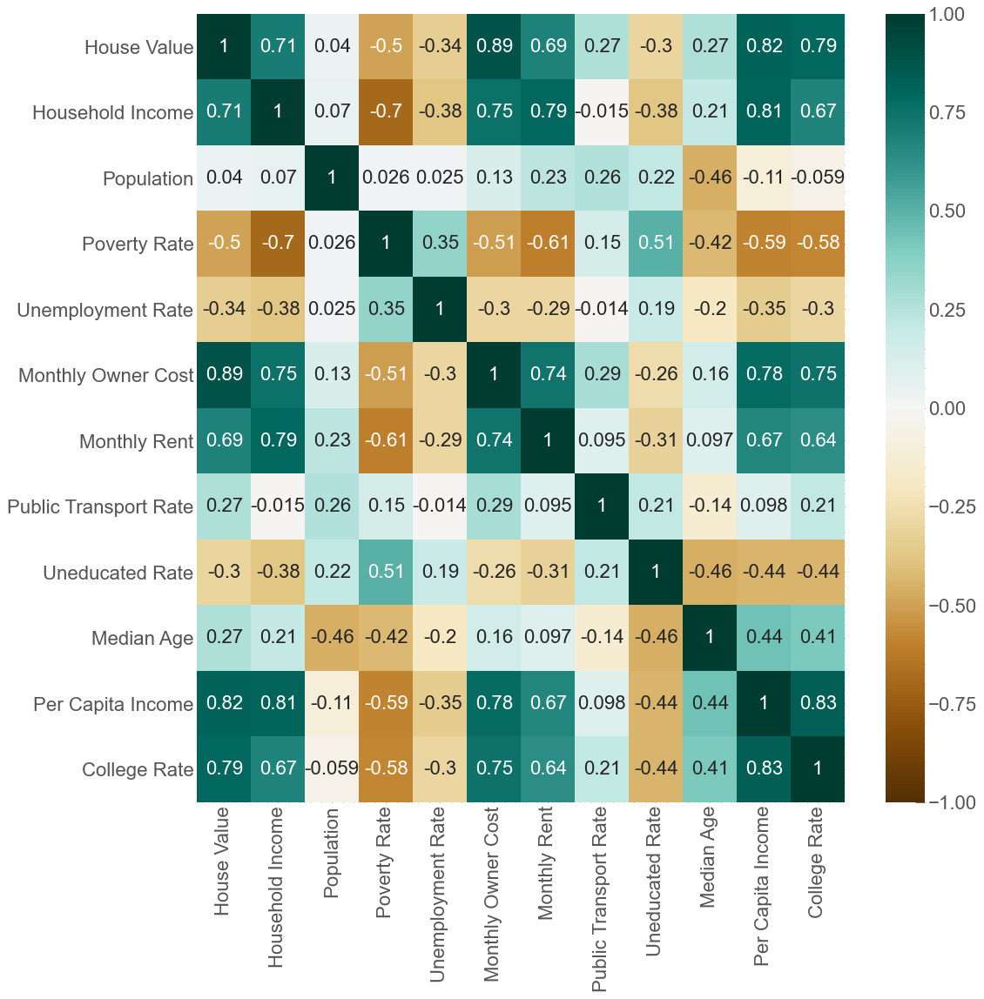

In [131]:
#plotting all correlation using seaborn heatmap
corr_12=ca_12.corr()
import seaborn as sns
fig, ax=plt.subplots(figsize=(15,15))
sns.heatmap(corr_12,vmin=-1, vmax=1, ax=ax, cmap='BrBG',annot=True)
plt.show()

# California Census 2019 Figures

In [26]:
#looking 2019 california cleaned data for plotting
ca_2019.head()

,Zipcode,Population,Median Age,Household Income,Per Capita Income,Poverty Rate,Unemployment Rate,House Value,House Construction Year,Monthly Owner Cost,...,White Population Rate,Black Population Rate,Hispanic Population Rate,Asian Population Rate,City,County,Lat,Lng,Housing_units,State
0,90001,59832.0,29.1,43360.0,13727.0,25.496390,3.929335,359000.0,1949,1853.0,...,41.882270,8.921647,90.134042,0.315884,Los Angeles,Los Angeles County,33.97,-118.25,13788.0,CA
1,90002,53302.0,28.0,37285.0,13284.0,31.188323,4.110540,345900.0,1954,1813.0,...,42.973997,18.912986,78.886346,1.029980,Los Angeles,Los Angeles County,33.95,-118.25,12598.0,CA
2,90003,73730.0,28.3,40598.0,13441.0,29.959311,4.002441,362800.0,1954,1892.0,...,33.116777,20.676794,78.348027,0.297030,Los Angeles,Los Angeles County,33.96,-118.27,17127.0,CA
3,90004,60541.0,35.2,49675.0,32090.0,17.784642,2.685783,1063200.0,1946,3489.0,...,35.676649,3.614080,50.289886,25.465387,Los Angeles,Los Angeles County,34.08,-118.31,24278.0,CA
4,90005,39732.0,35.6,38491.0,24267.0,25.999195,3.289540,777100.0,1950,3149.0,...,23.336354,5.763616,49.481526,34.221786,Los Angeles,Los Angeles County,34.06,-118.31,16345.0,CA


In [27]:
#2019 california cleaned data columns
ca_2019.columns

Index(['Zipcode', 'Population', 'Median Age', 'Household Income',
       'Per Capita Income', 'Poverty Rate', 'Unemployment Rate', 'House Value',
       'House Construction Year', 'Monthly Owner Cost', 'Monthly Rent',
       'Public Transport Rate', 'Personal Transport Rate',
       'Commute Time Public', 'Commute Time Car', 'High School Rate',
       'College Rate', 'Uneducated Rate', 'English Language',
       'Spanish Language', 'White Population Rate', 'Black Population Rate',
       'Hispanic Population Rate', 'Asian Population Rate', 'City', 'County',
       'Lat', 'Lng', 'Housing_units', 'State'],
      dtype='object')

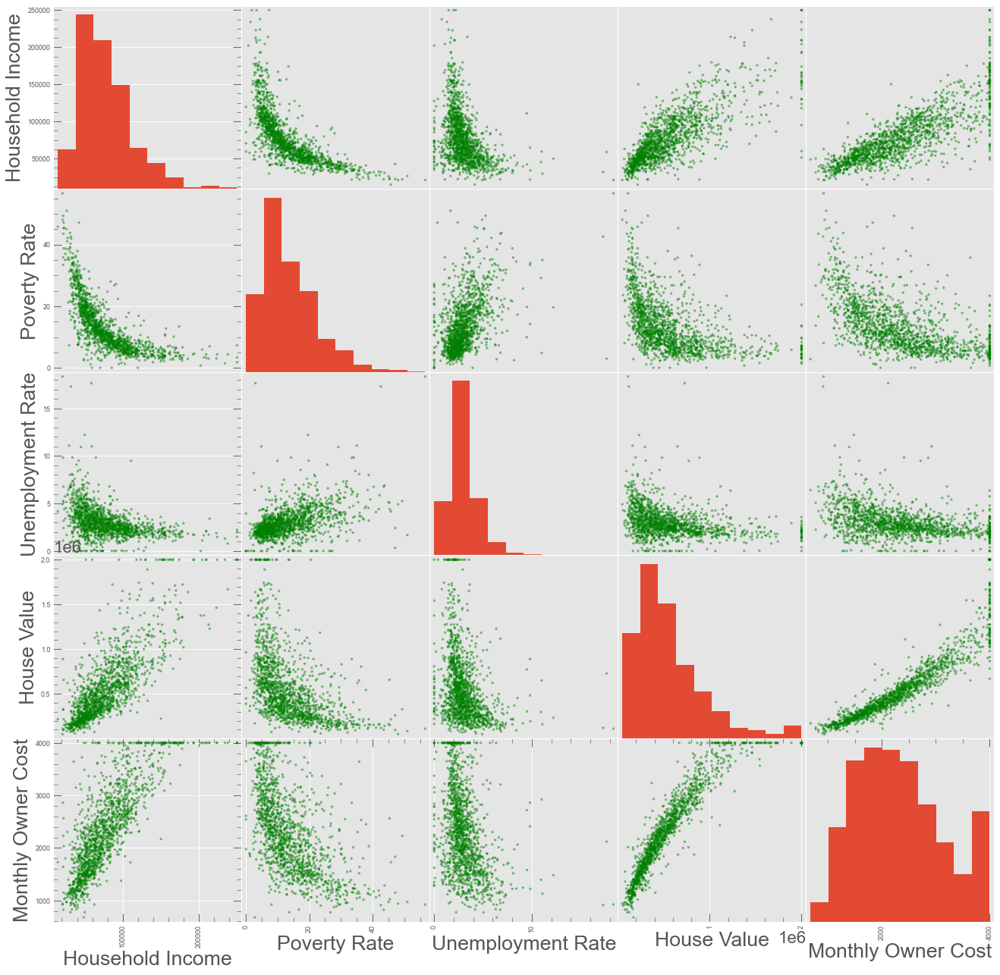

In [28]:
# to plot all selected columns

col_19=ca_2019[[ 'Household Income',
        'Poverty Rate', 'Unemployment Rate', 'House Value',
        'Monthly Owner Cost', ]]

pd.plotting.scatter_matrix(col_19,c='g', figsize=(20,20))
plt.show()


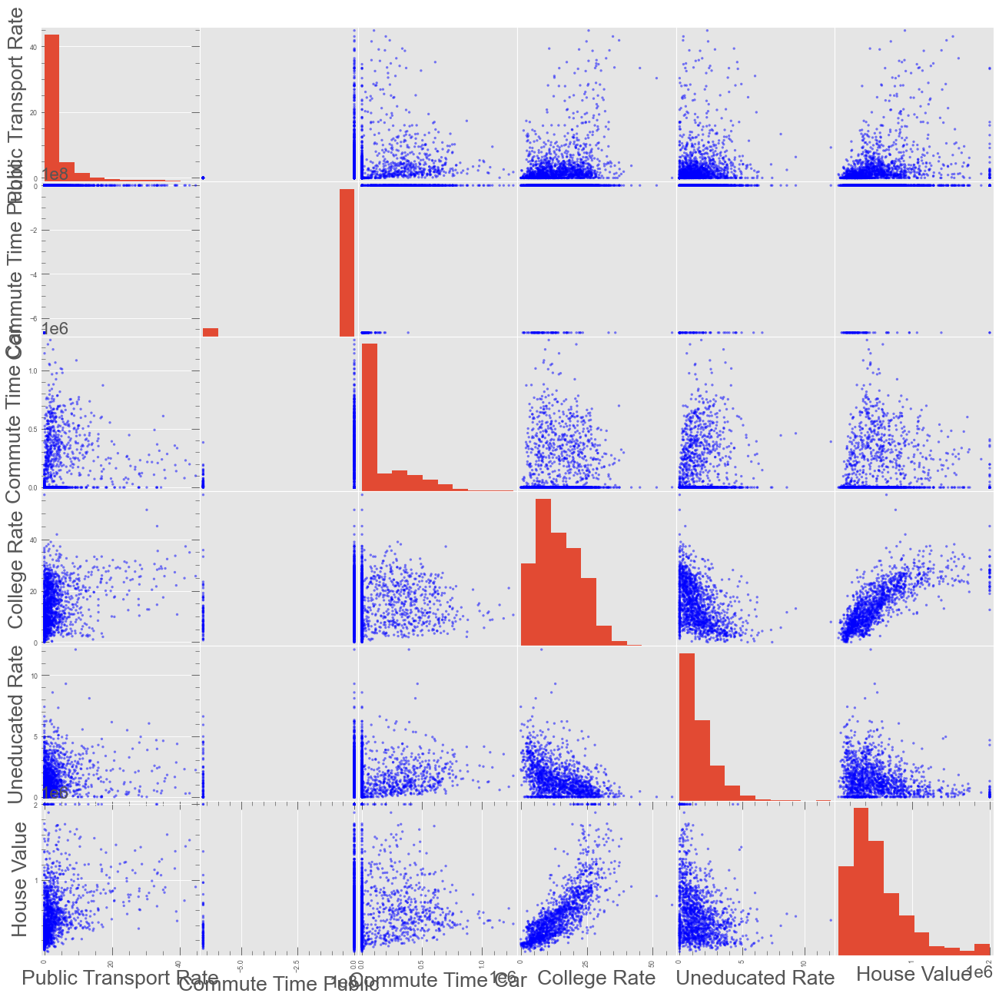

In [29]:
# to plot all selected columns

cols_19=ca_2019[['Public Transport Rate',
       'Commute Time Public', 'Commute Time Car', 
       'College Rate', 'Uneducated Rate','House Value' ]]

pd.plotting.scatter_matrix(cols_19,c='b', figsize=(20,20))
plt.show()

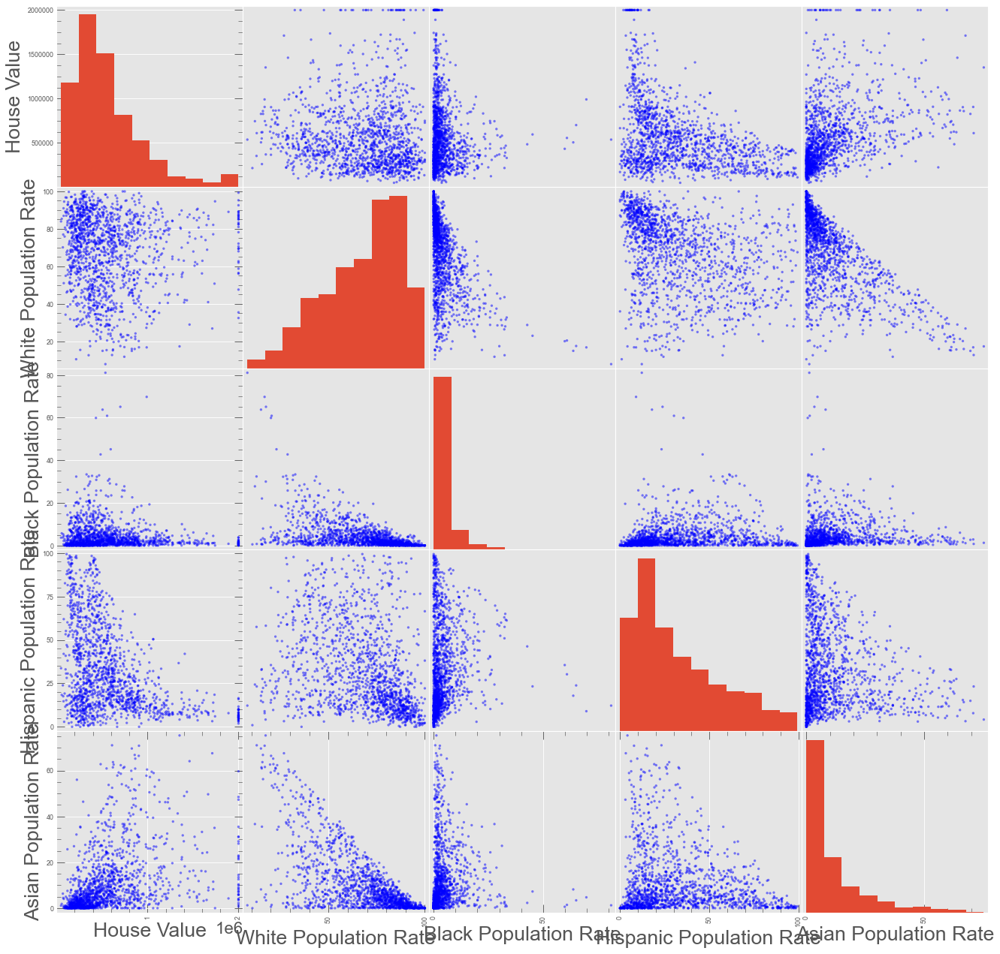

In [30]:
# to plot all selected columns

colu_2019=ca_2019[[ 'House Value',
       'White Population Rate',
       'Black Population Rate', 'Hispanic Population Rate',
       'Asian Population Rate' ]]

pd.plotting.scatter_matrix(colu_2019,c='b', figsize=(20,20))
plt.show()      


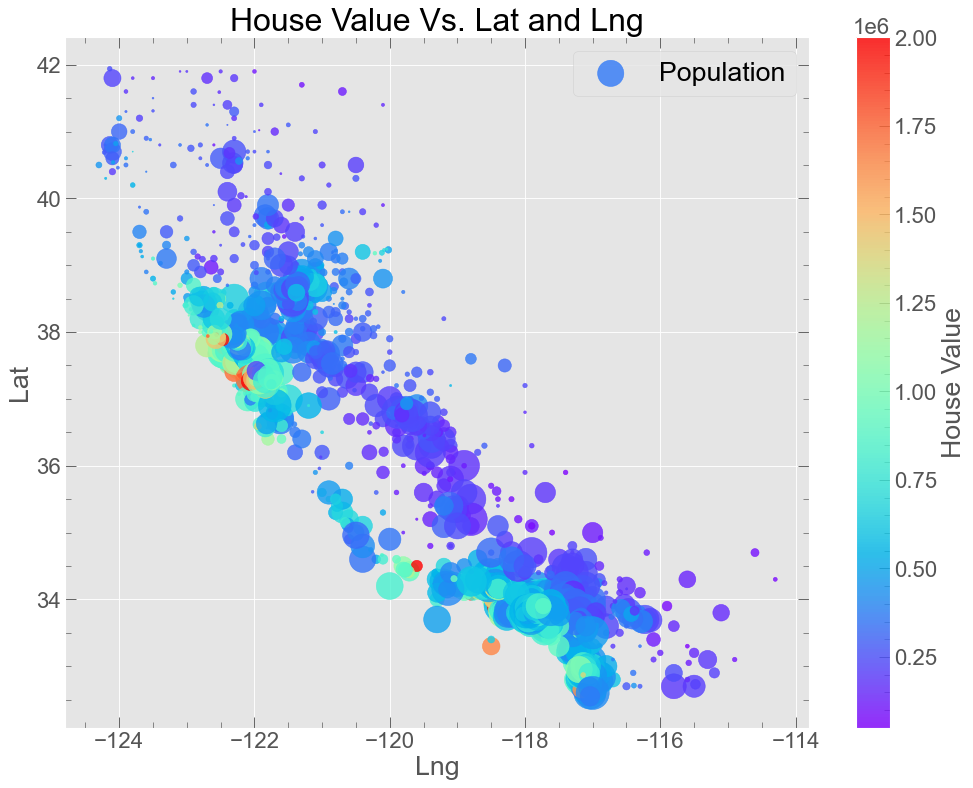

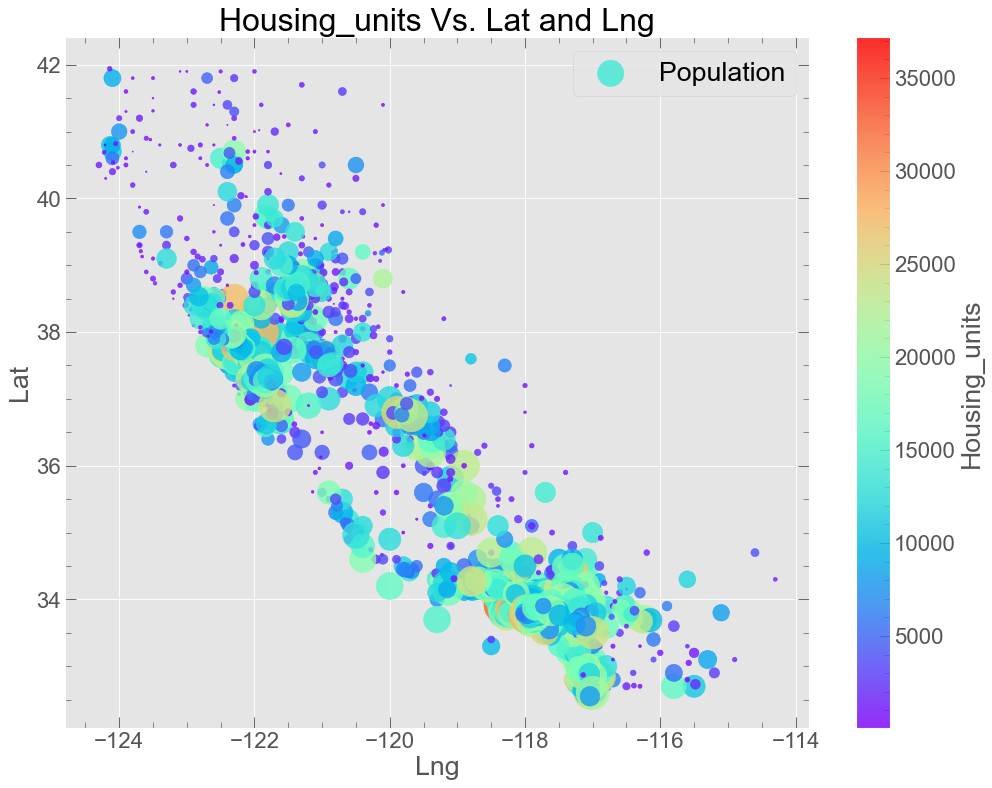

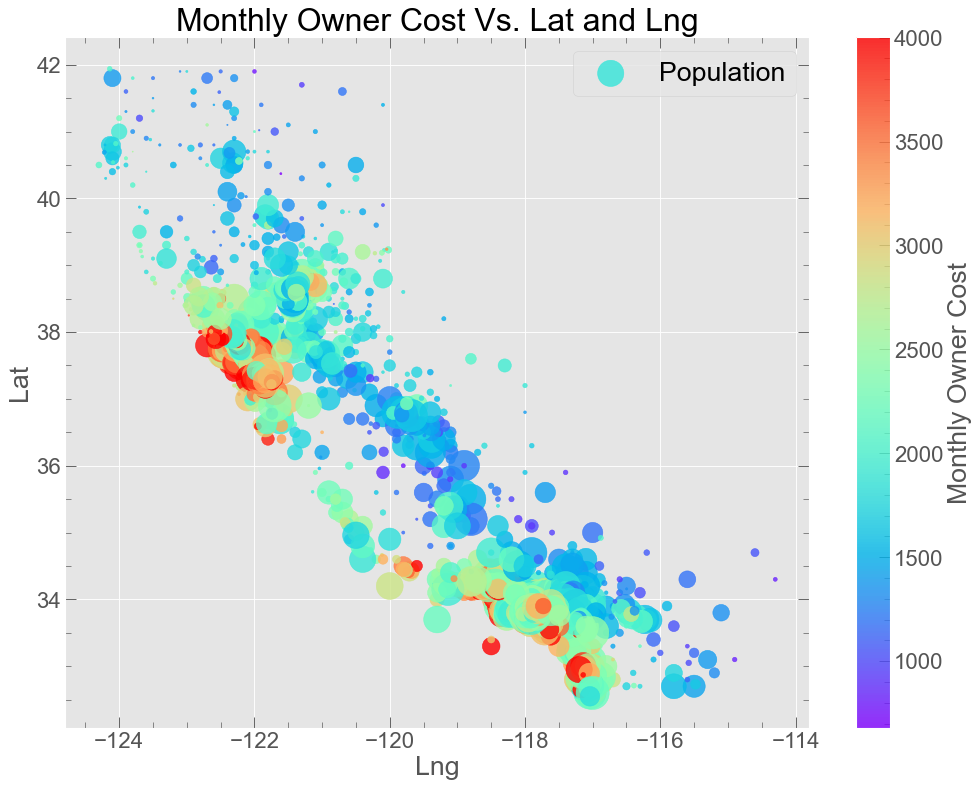

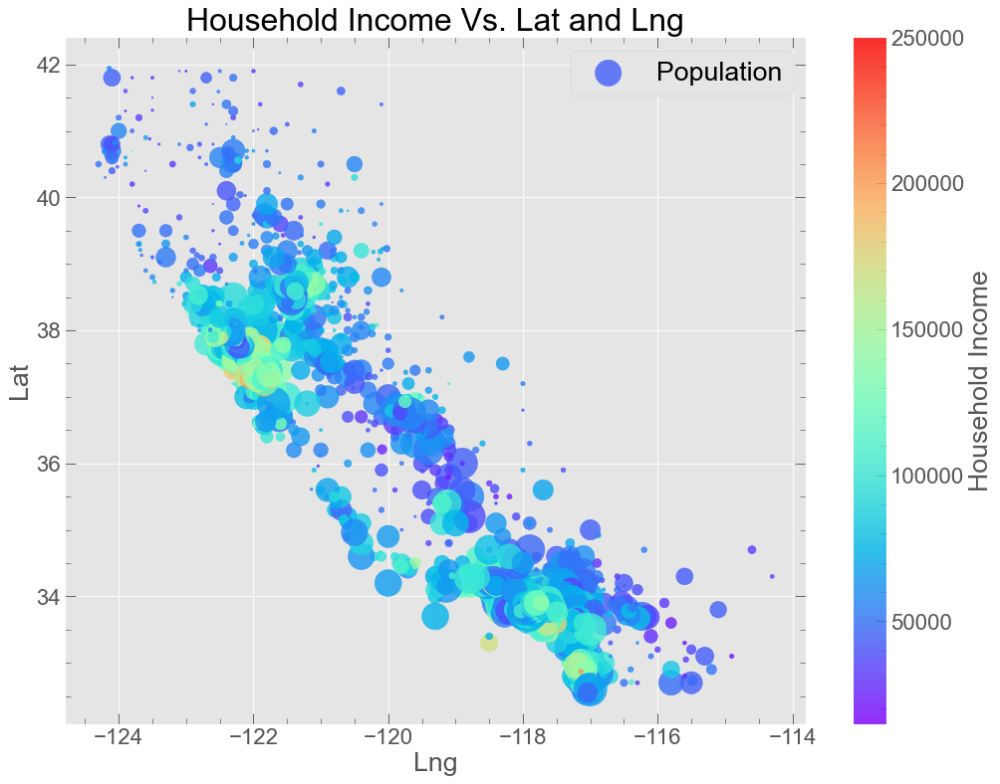

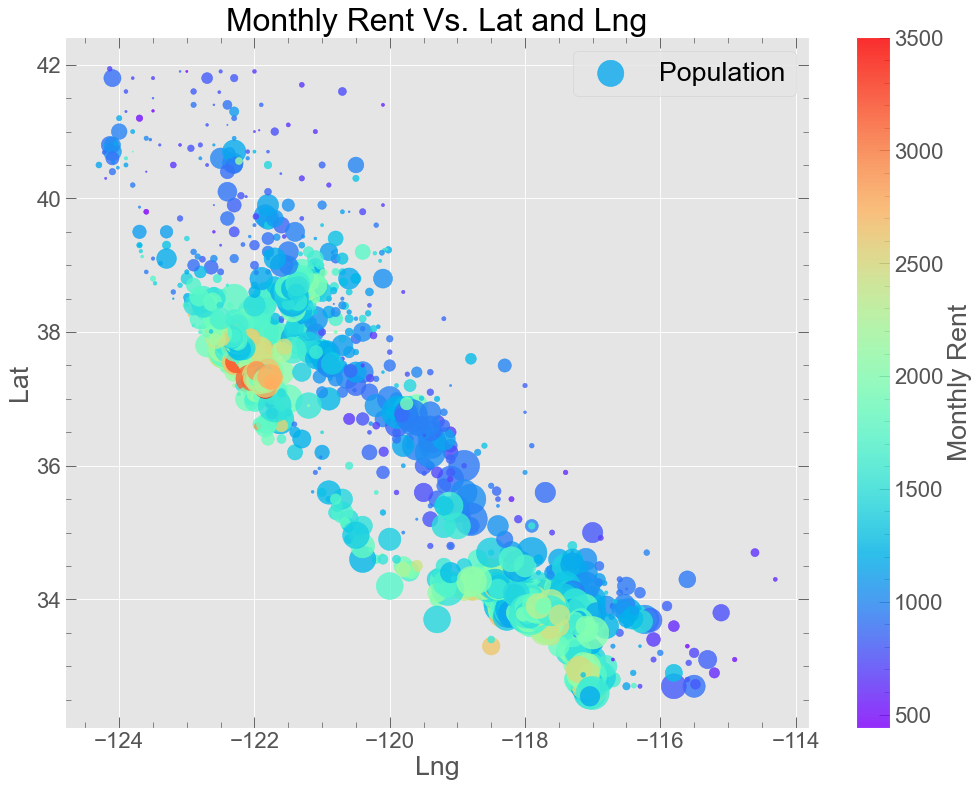

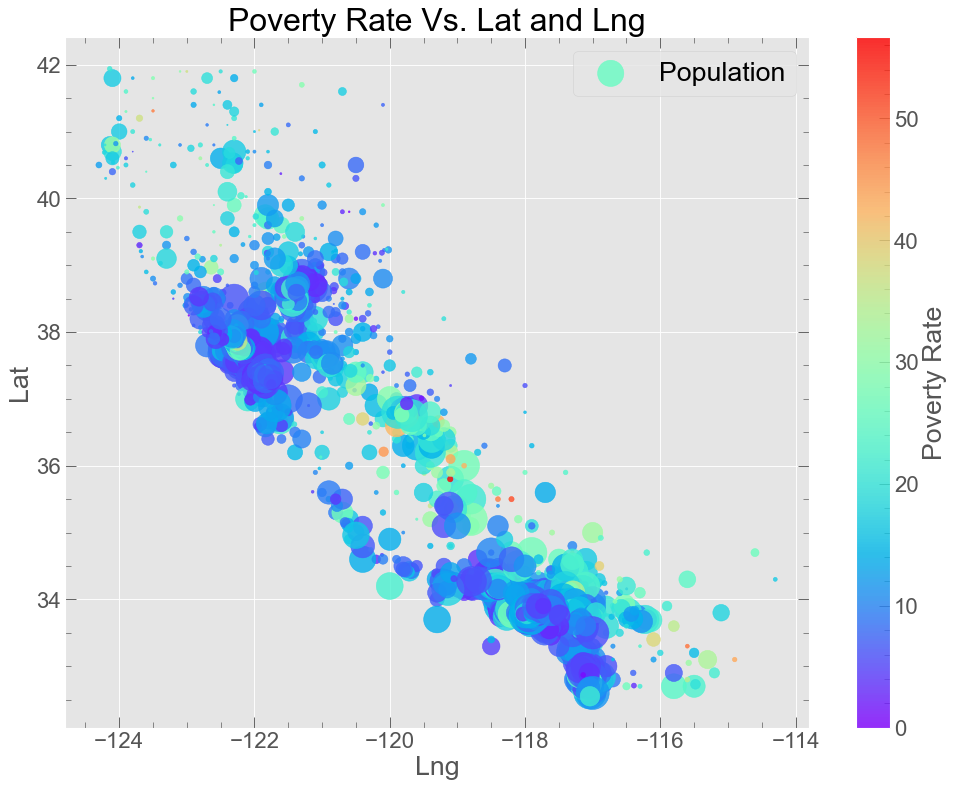

In [31]:
#
c=['House Value','Housing_units','Monthly Owner Cost','Household Income',
  'Monthly Rent','Poverty Rate']
for i in range(1, 7):
    fig = plt.figure(figsize=(15,80))
    ax = fig.add_subplot(6, 1, i)
    
    ca_2019.plot(kind='scatter', x='Lng', y='Lat', alpha=0.8, 
                s=ca_2019['Population']/100,label='Population',
                 c=c[i-1], cmap=plt.get_cmap('rainbow'),
                colorbar=True, ax=ax)
    ax.set_title(f'{c[i-1]} Vs. Lat and Lng')

plt.show()

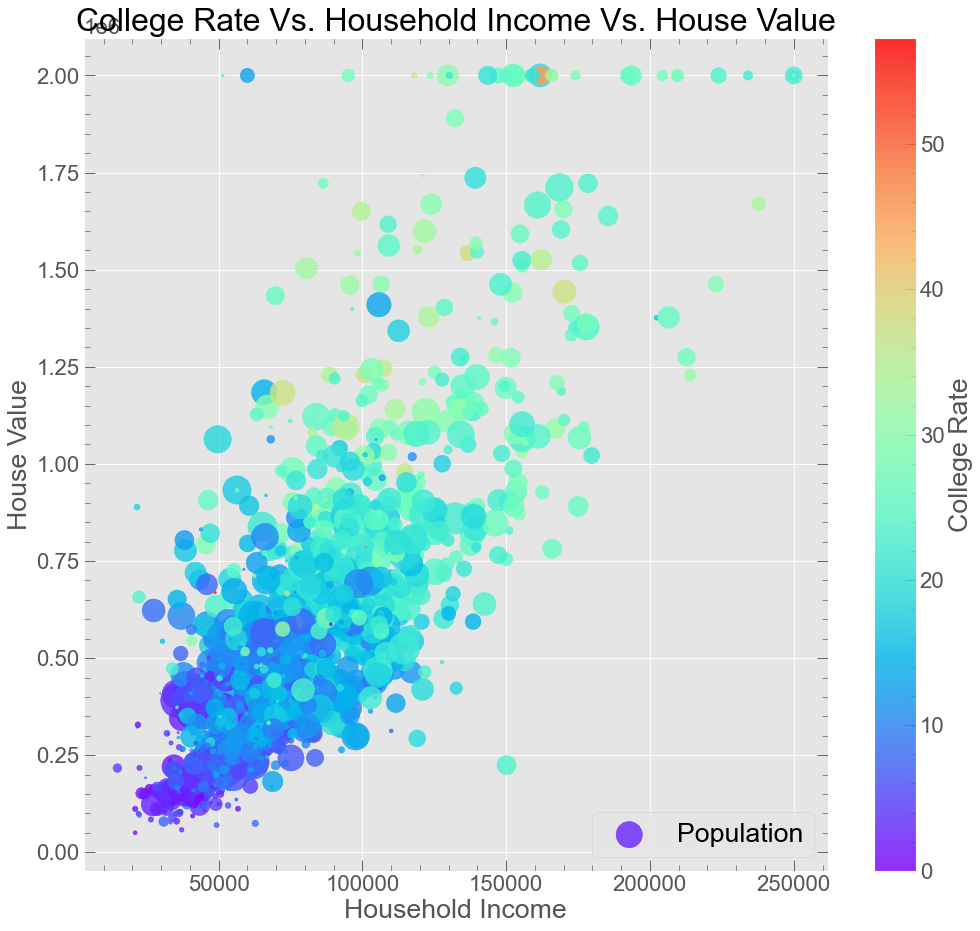

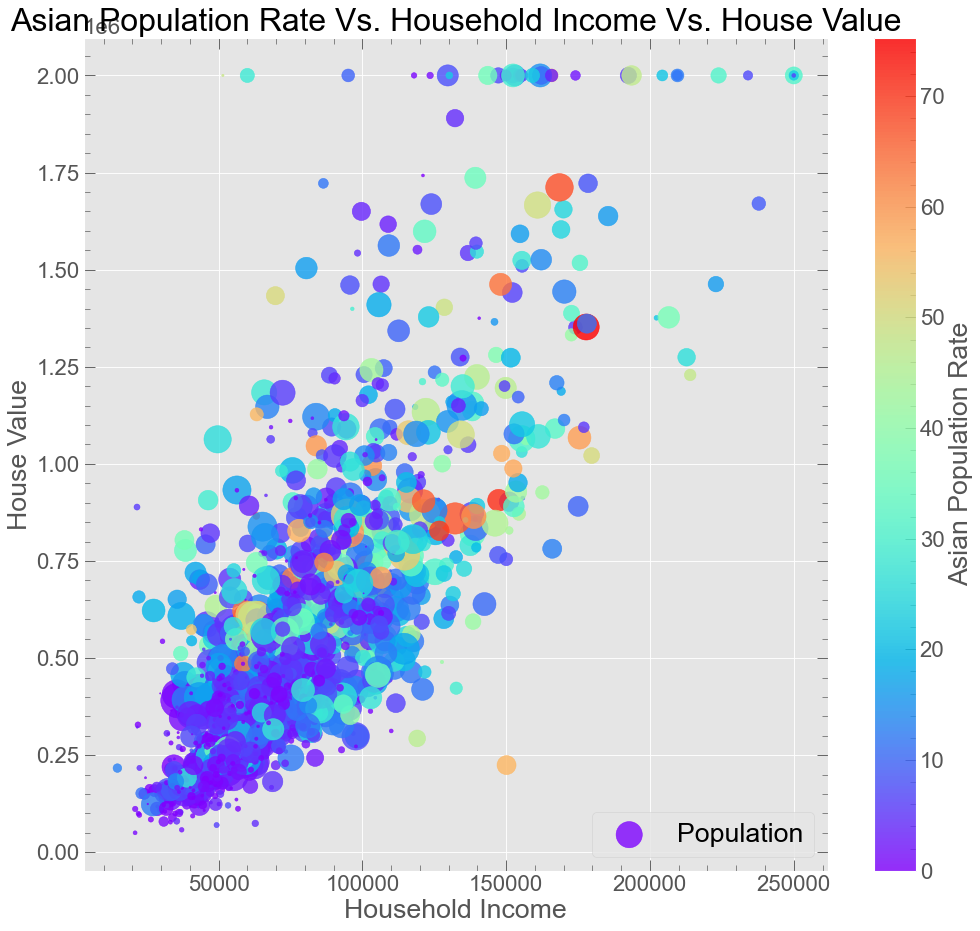

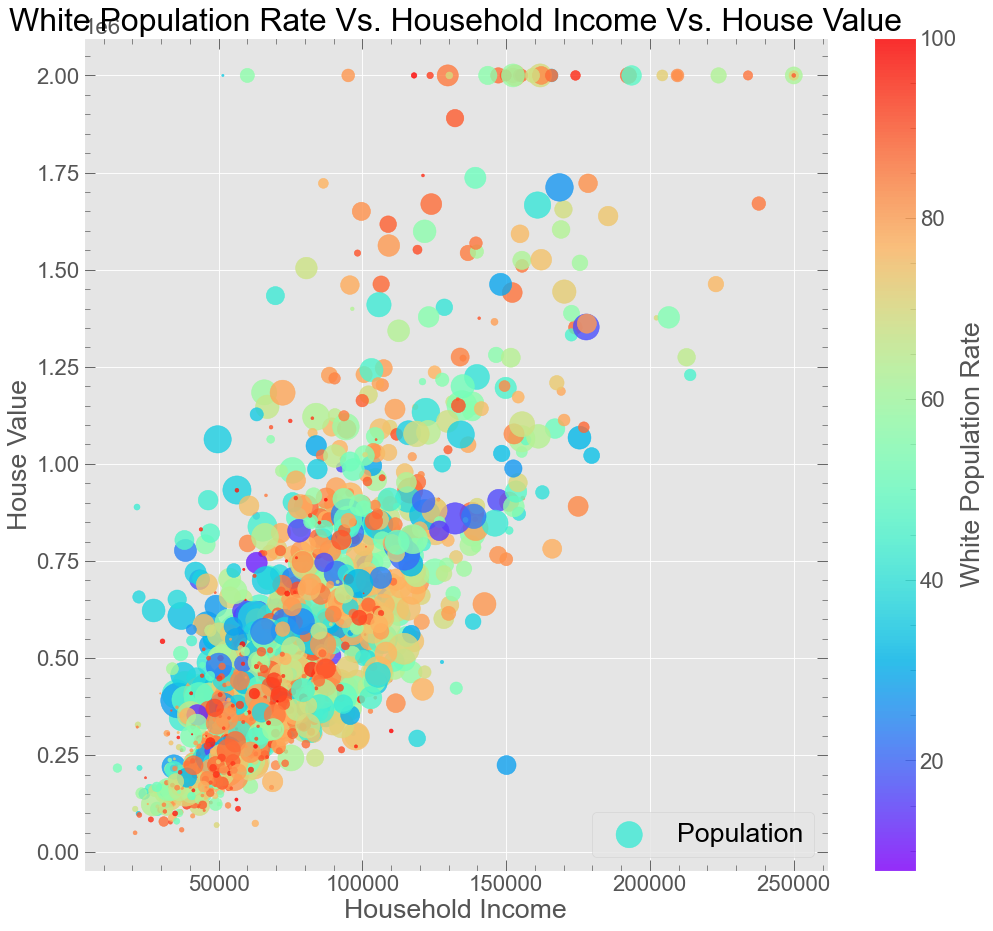

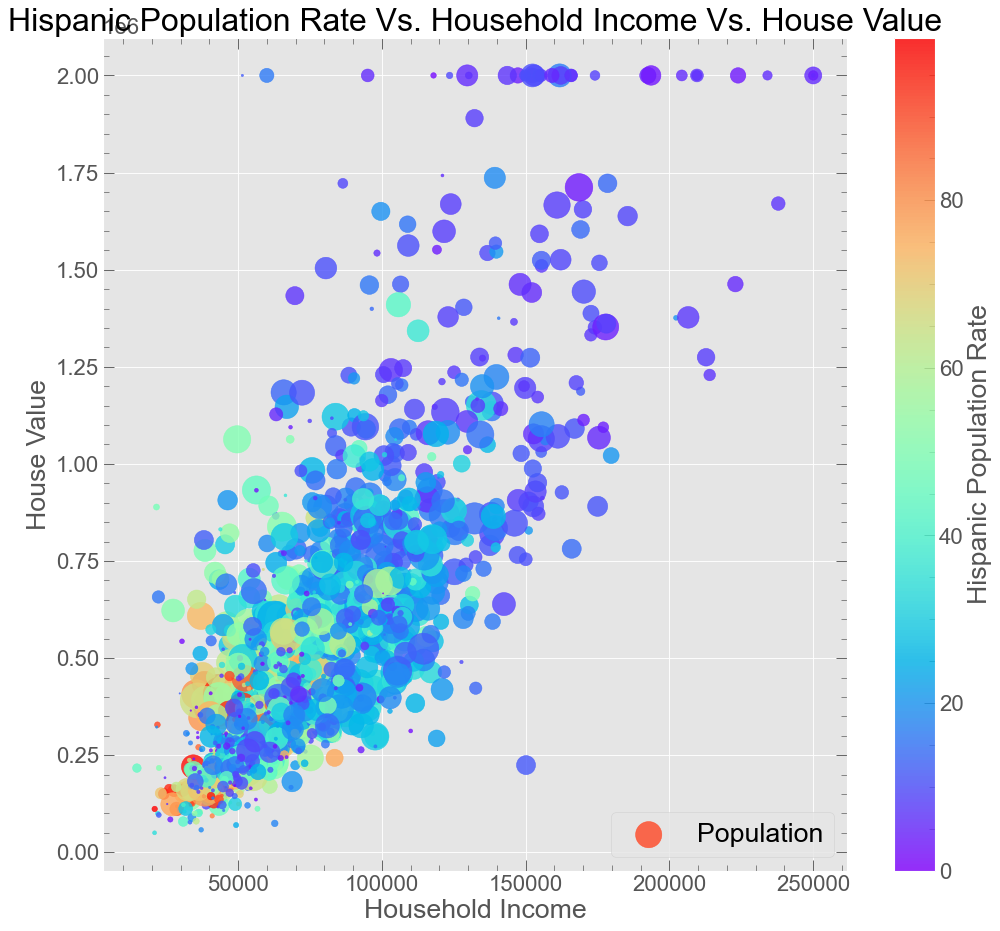

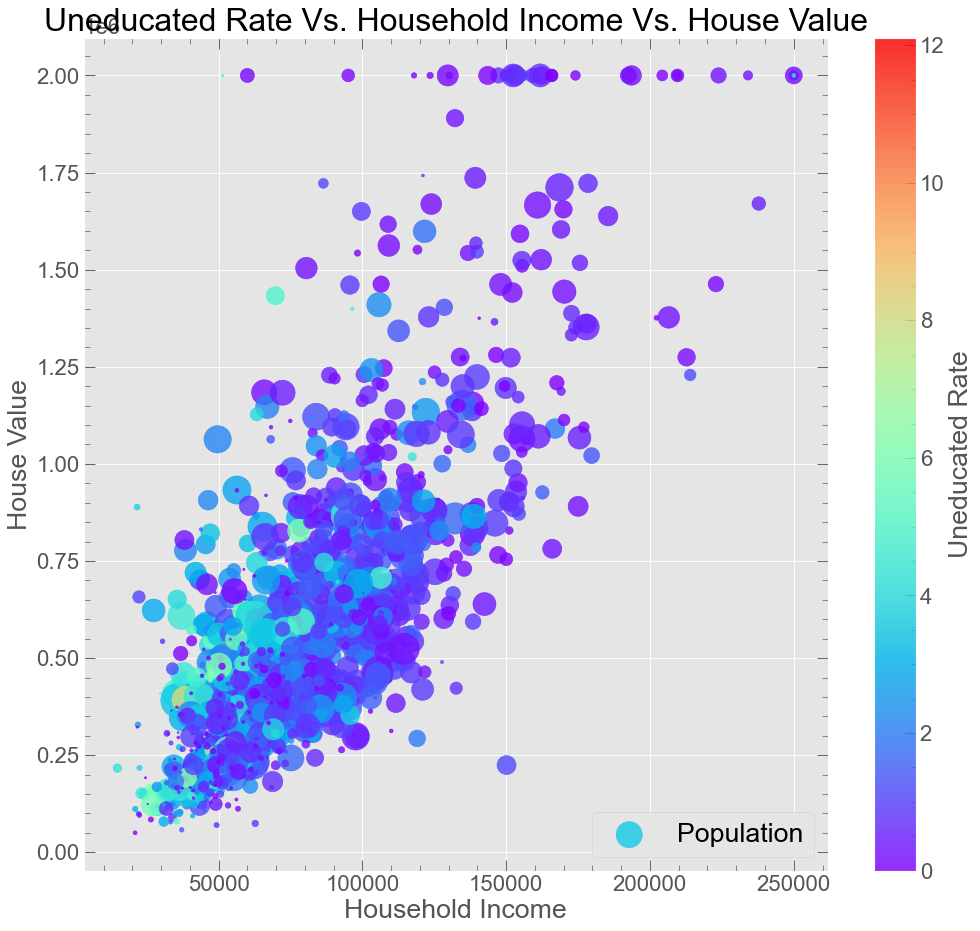

In [32]:
#
c=['College Rate','Asian Population Rate','White Population Rate',
  'Hispanic Population Rate','Uneducated Rate']
for i in range(1, 6):
    fig = plt.figure(figsize=(15,80))
    ax = fig.add_subplot(5, 1, i)
    
    ca_2019.plot(kind='scatter', x='Household Income', y='House Value',
                 alpha=0.8, 
                s=ca_2019['Population']/100,label='Population',
                 c=c[i-1], cmap=plt.get_cmap('rainbow'),
                colorbar=True, ax=ax)
    ax.set_title(f'{c[i-1]} Vs. Household Income Vs. House Value')

plt.show()

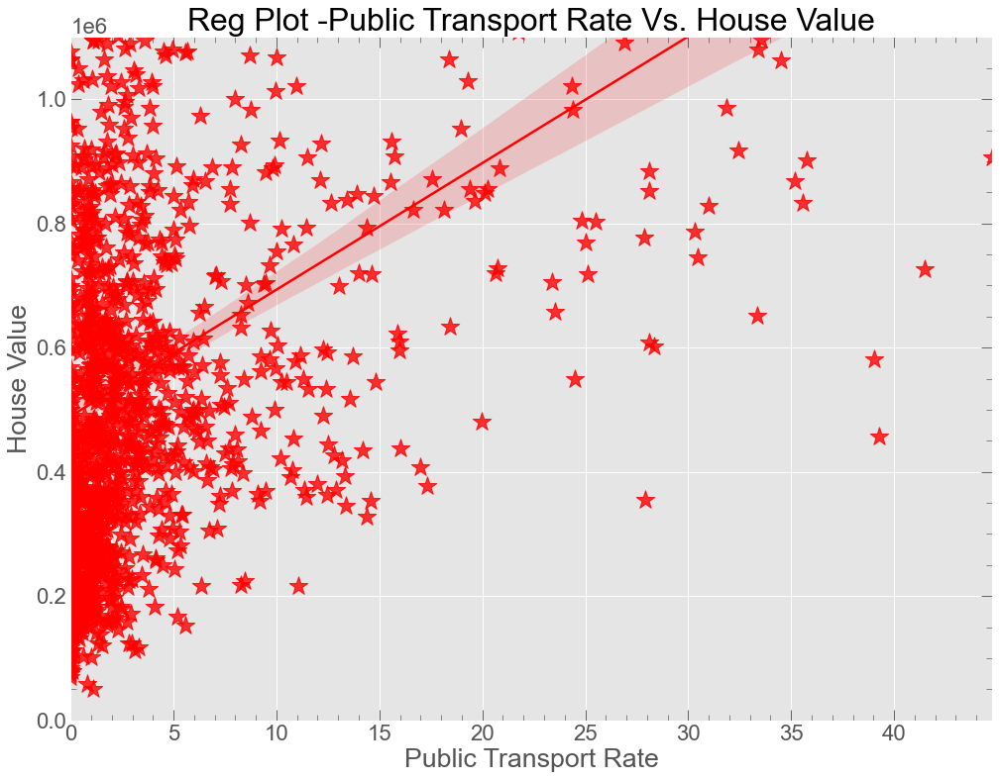

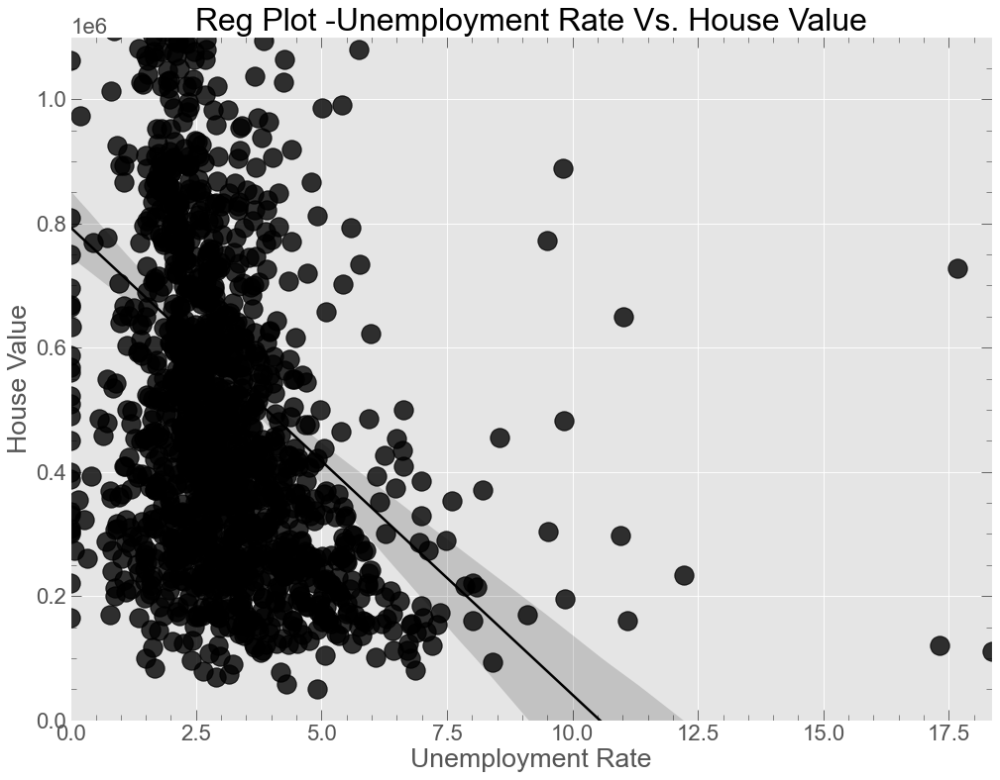

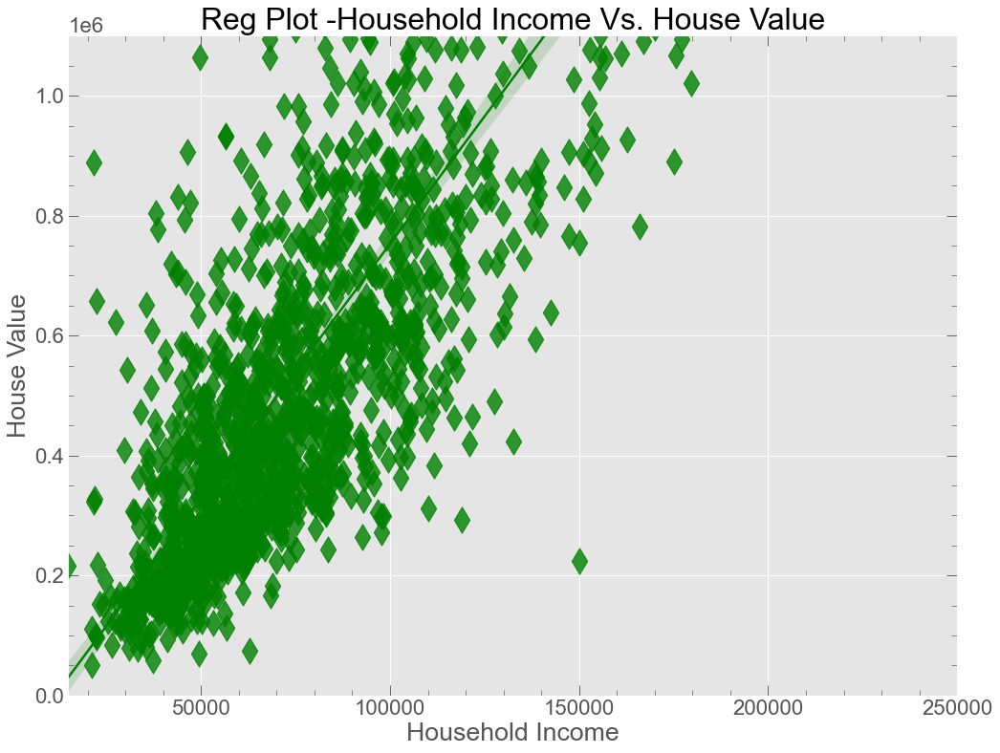

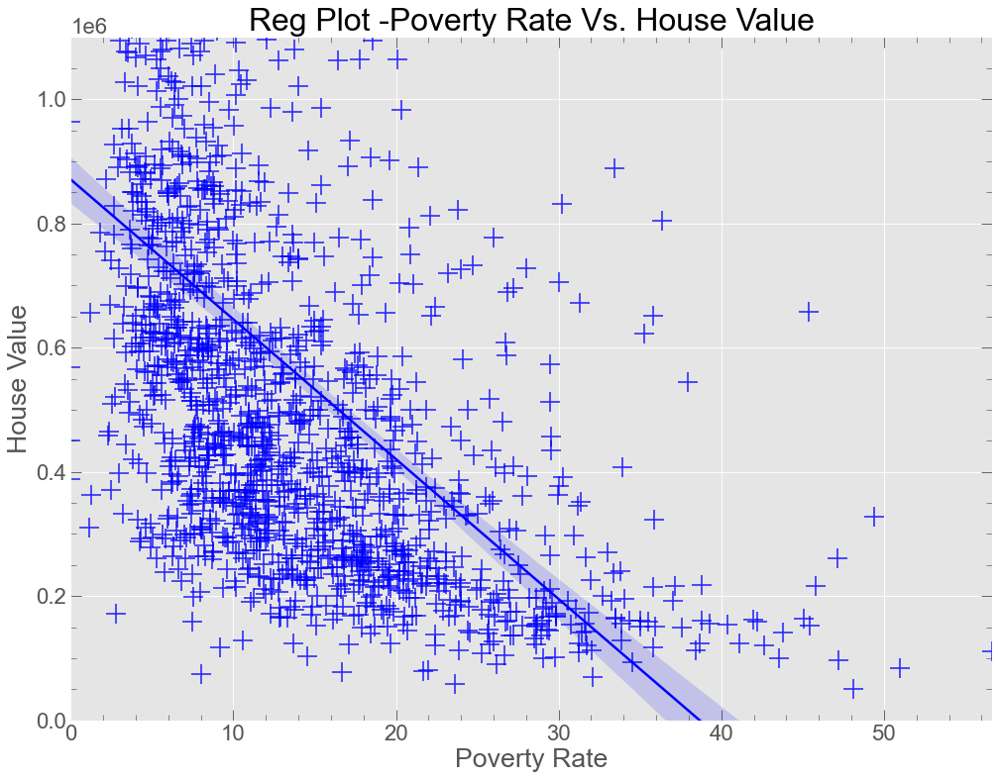

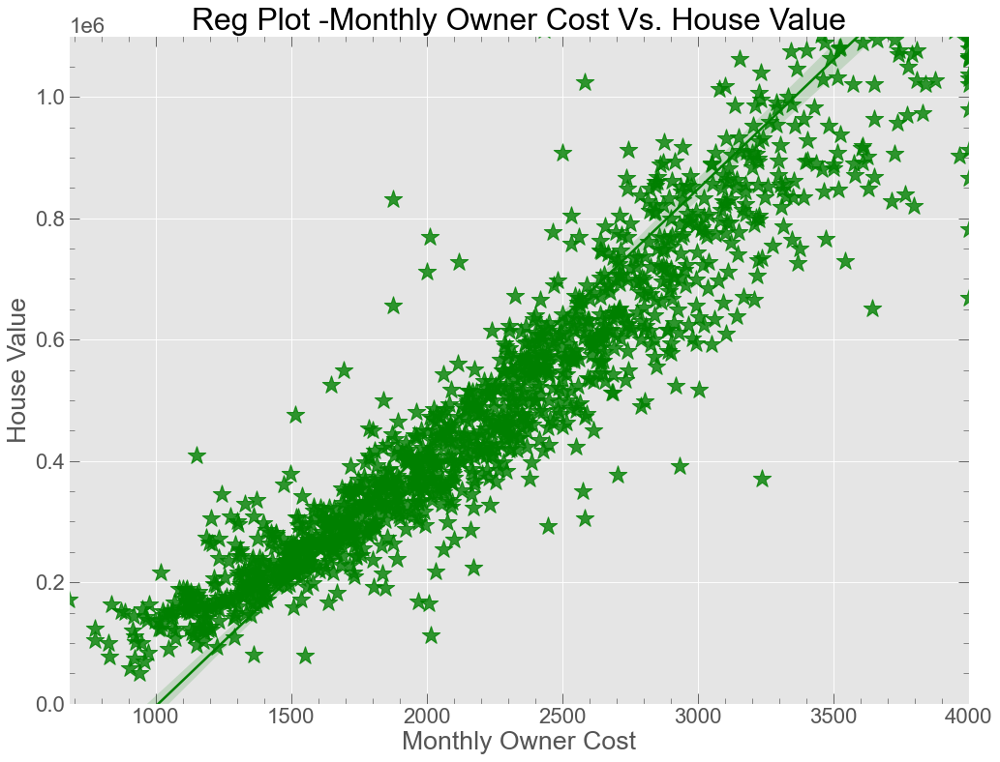

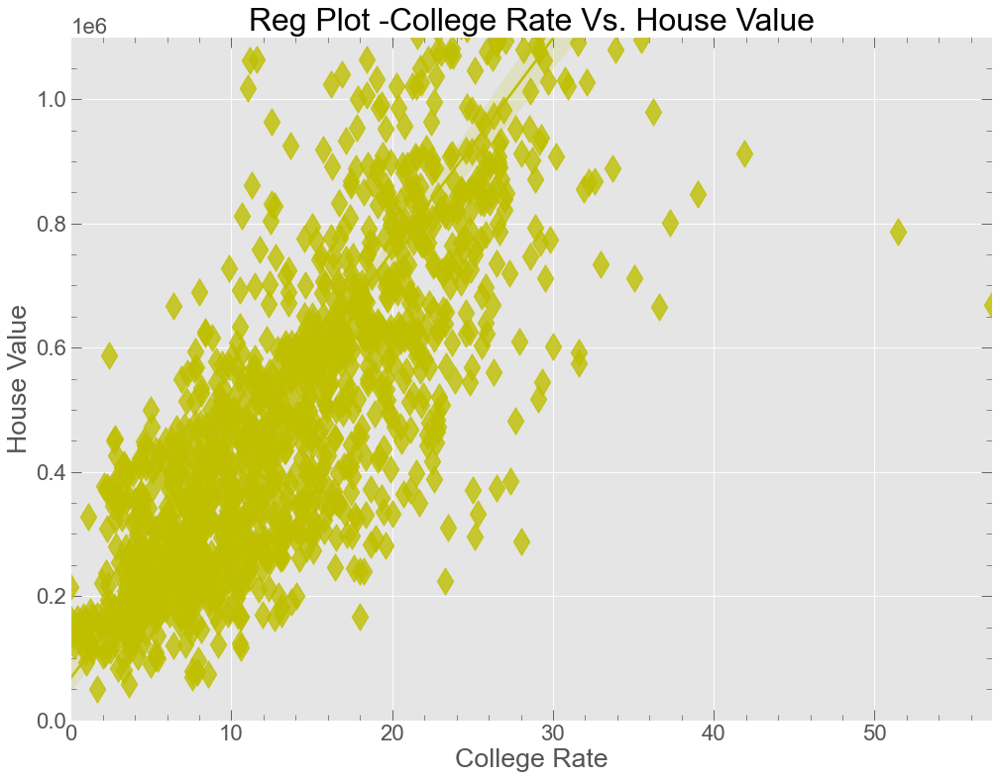

In [33]:
#using seaborn barplot
c=['Public Transport Rate','Unemployment Rate','Household Income',
  'Poverty Rate','Monthly Owner Cost','College Rate']
marker=["*","o","d","+","*","d"]
color=['r','k','g','b','g','y','b']
for i in range(1, 7):
    fig = plt.figure(figsize=(15,80))
    ax = fig.add_subplot(6, 1, i)
    
    sns.regplot(x=c[i-1], y='House Value',
           data=ca_2019,color=color[i-1],marker=marker[i-1],
            scatter_kws={'s':300},ax=ax);

    ax.set_ylim([0, 1100000])

    ax.set_xlabel(f'{c[i-1]}')
    ax.set_ylabel('House Value')
    ax.set_title(f'Reg Plot -{c[i-1]} Vs. House Value')

plt.show()

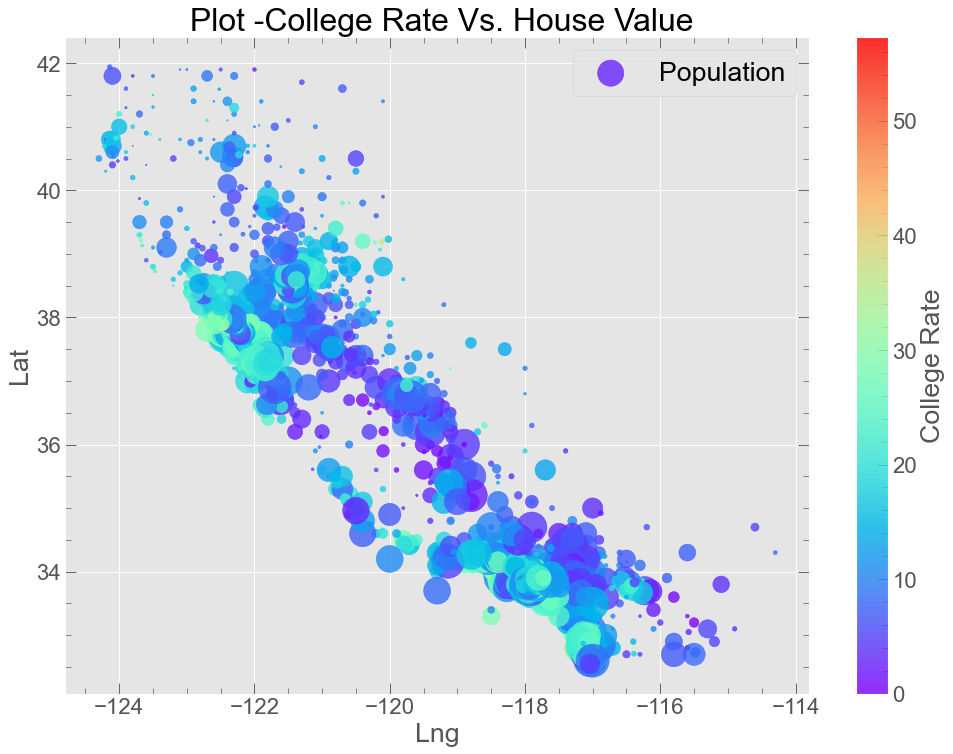

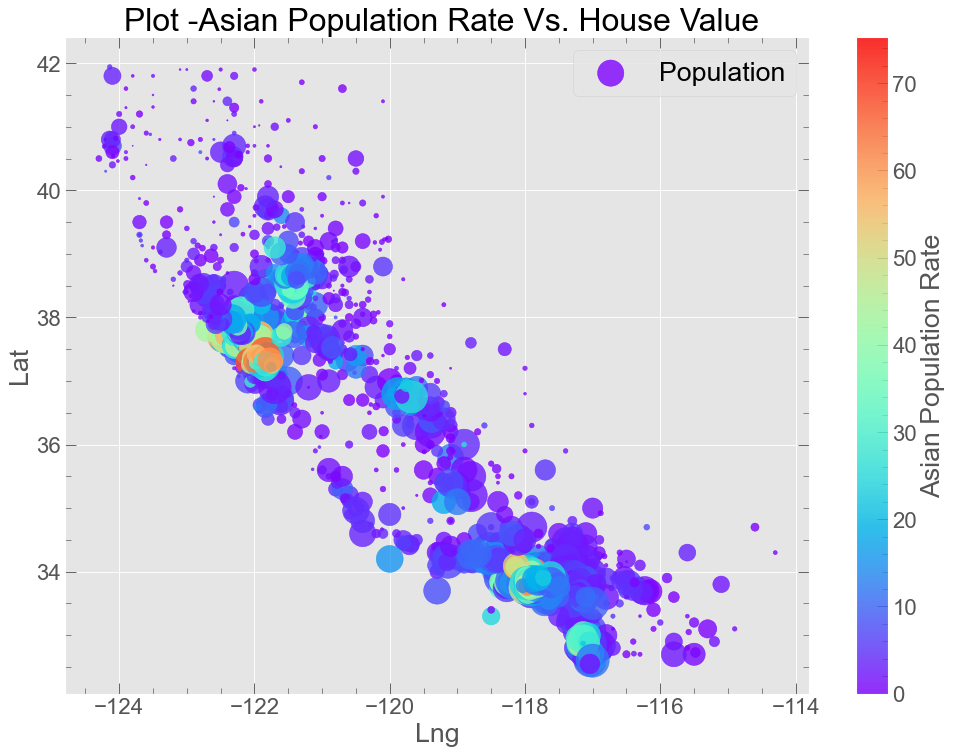

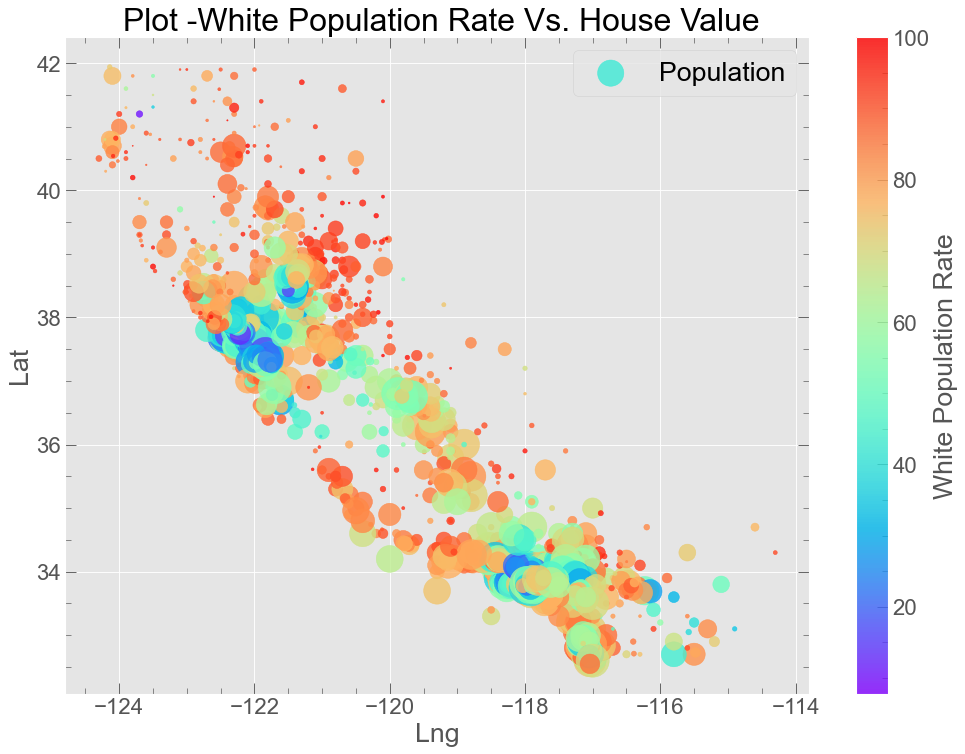

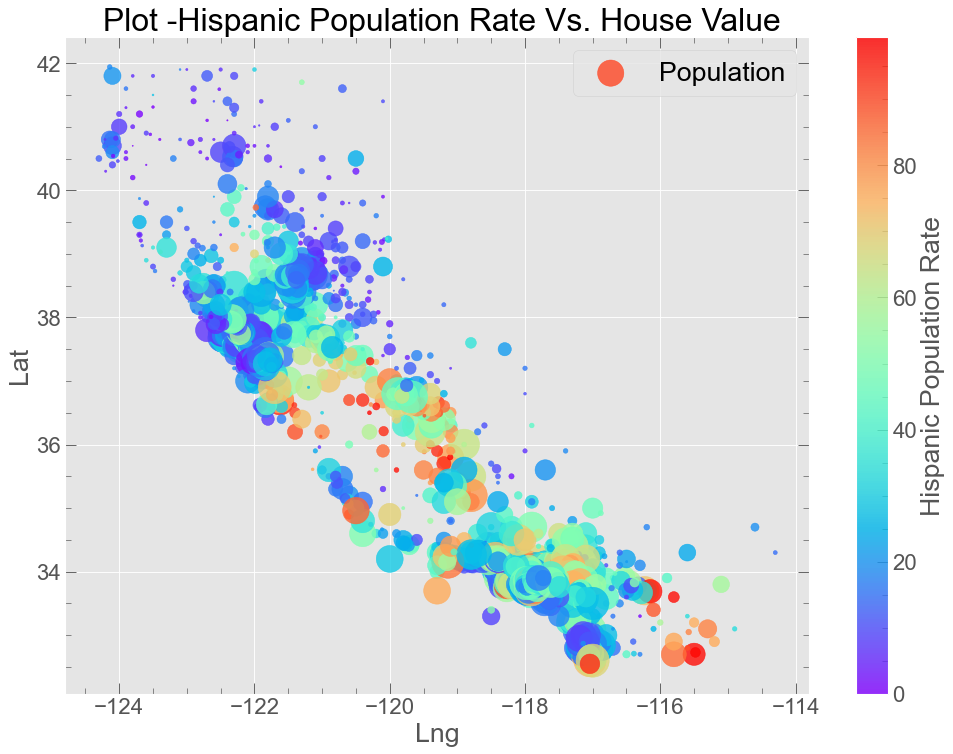

In [34]:
#
c=['College Rate','Asian Population Rate','White Population Rate',
  'Hispanic Population Rate']
for i in range(1, 5):
    fig = plt.figure(figsize=(15,50))
    ax = fig.add_subplot(4, 1, i)
    
    ca_2019.plot(kind='scatter', x='Lng', y='Lat', alpha=0.8, 
                s=ca_2019['Population']/100,label='Population',
                 c=c[i-1], cmap=plt.get_cmap('rainbow'),
                colorbar=True, ax=ax)

    #ax.set_xlabel(f'{c[i-1]}')
    #ax.set_ylabel('House Value')
    ax.set_title(f' Plot -{c[i-1]} Vs. House Value')

plt.show()

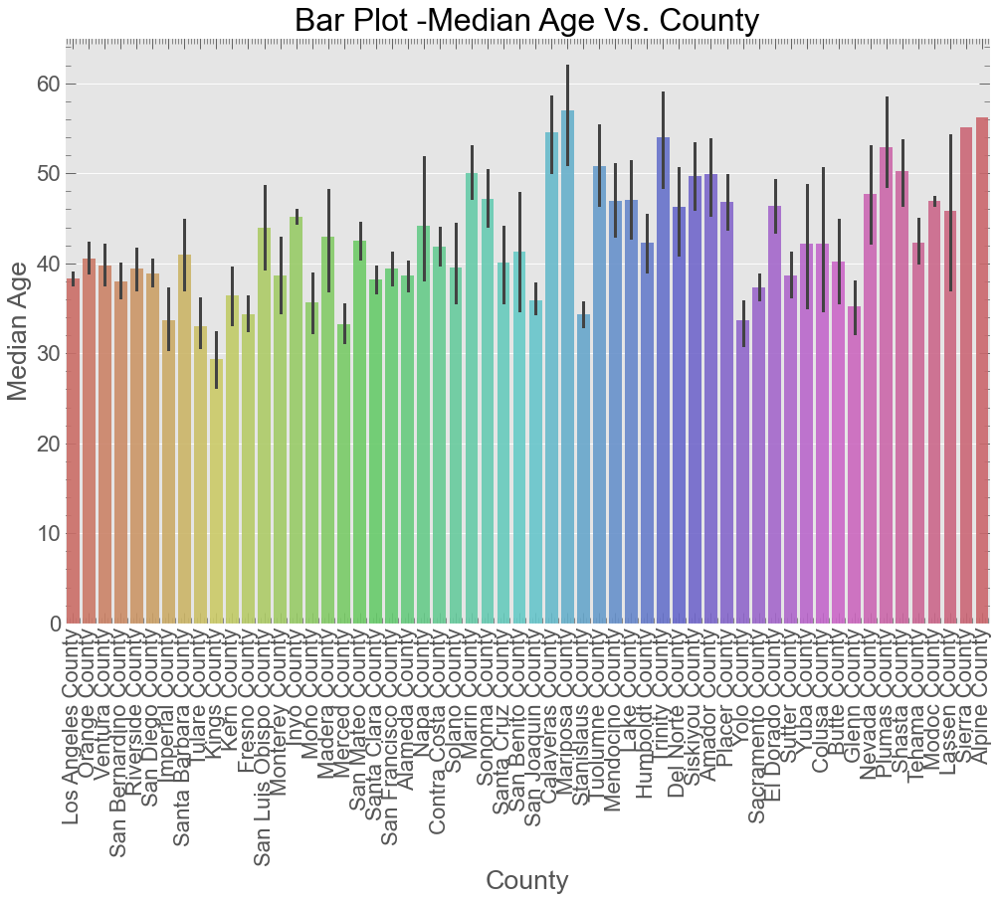

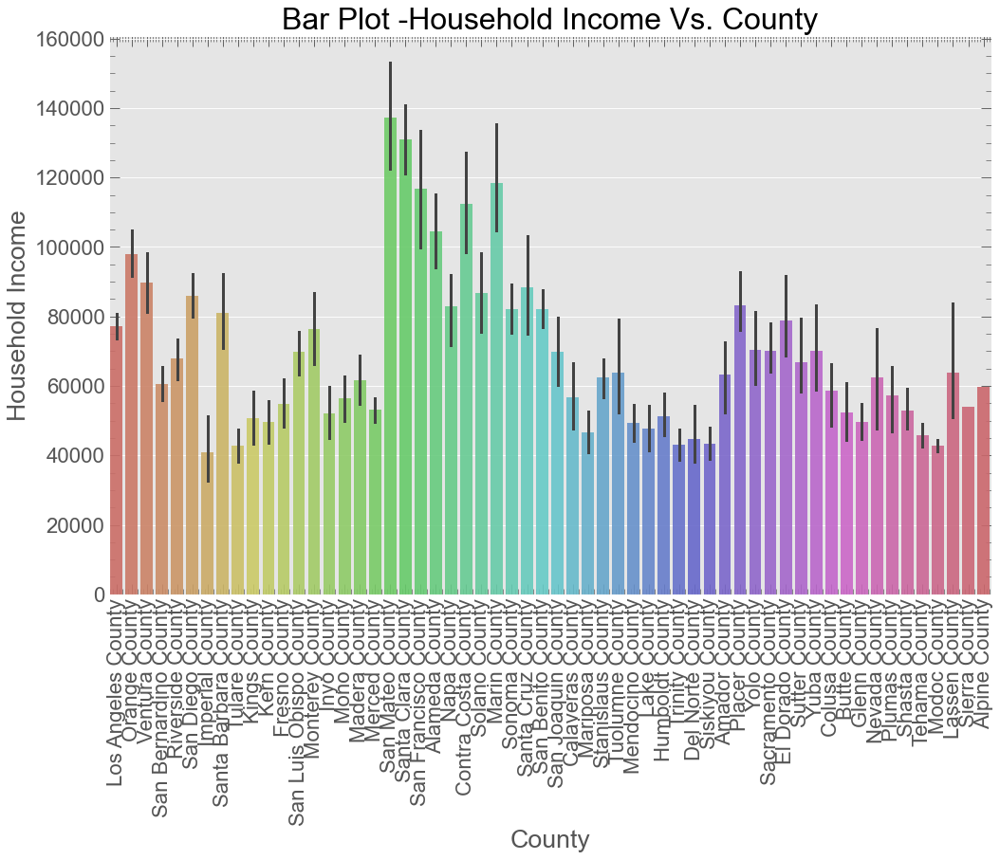

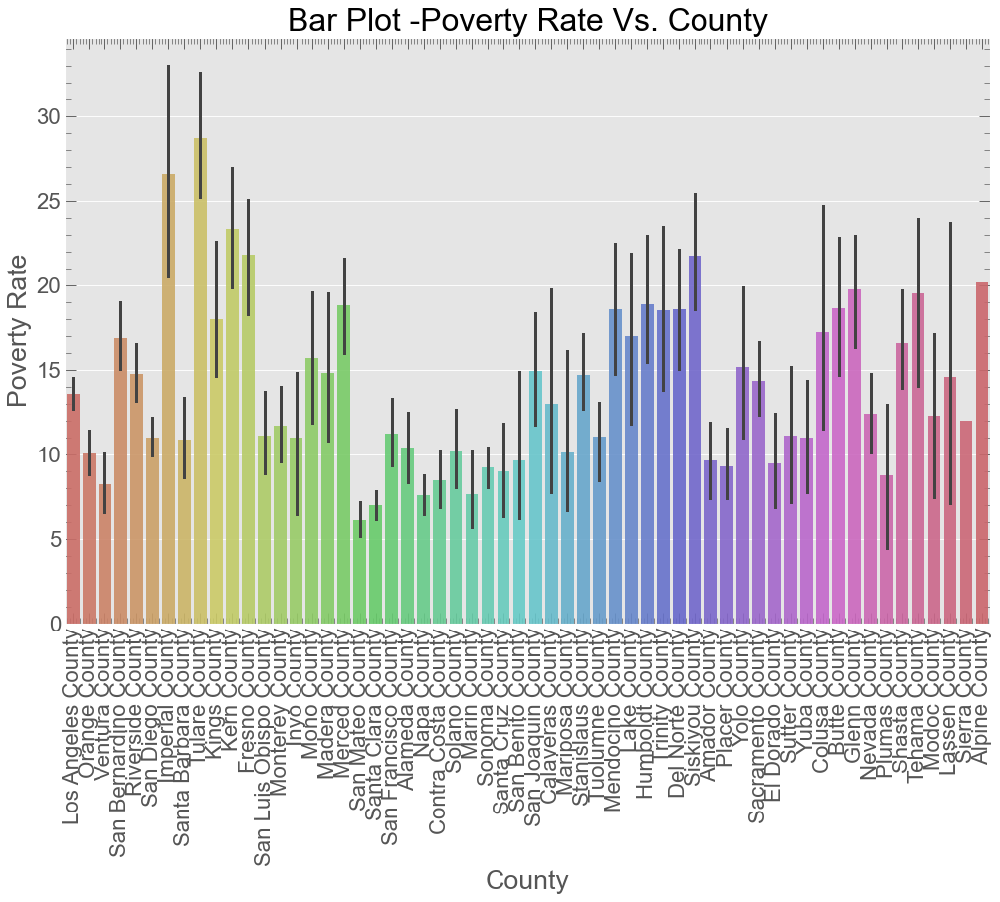

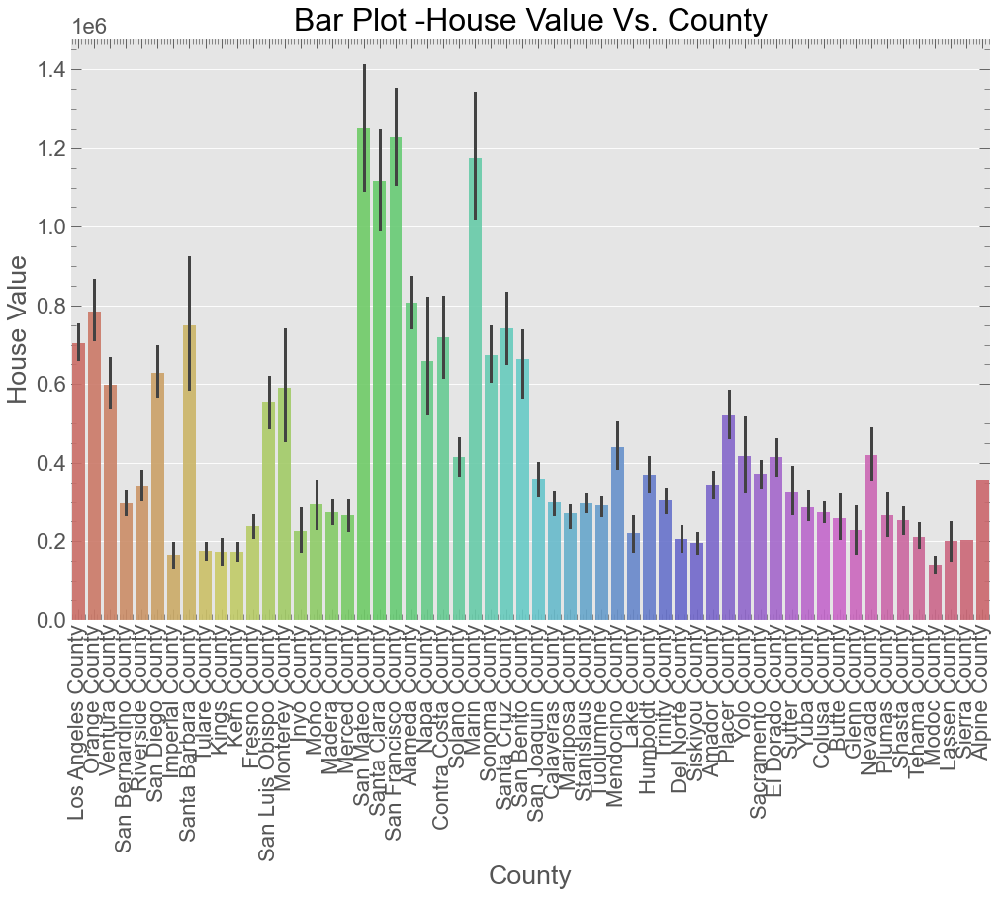

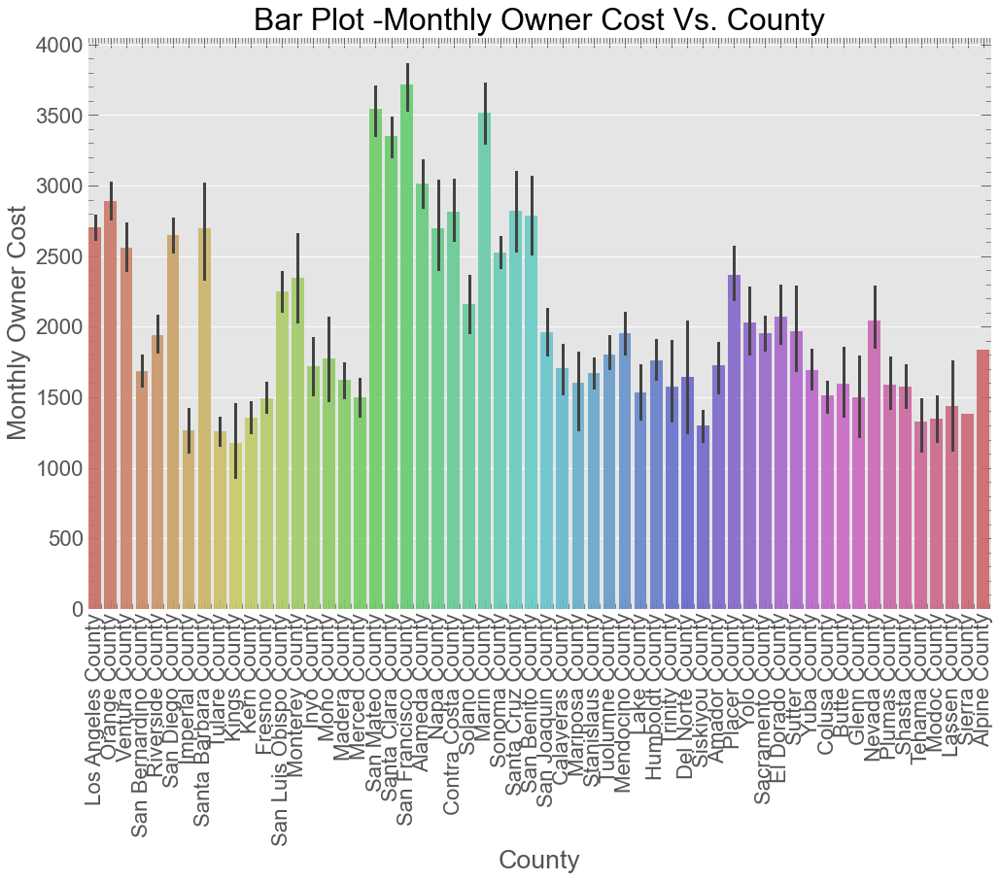

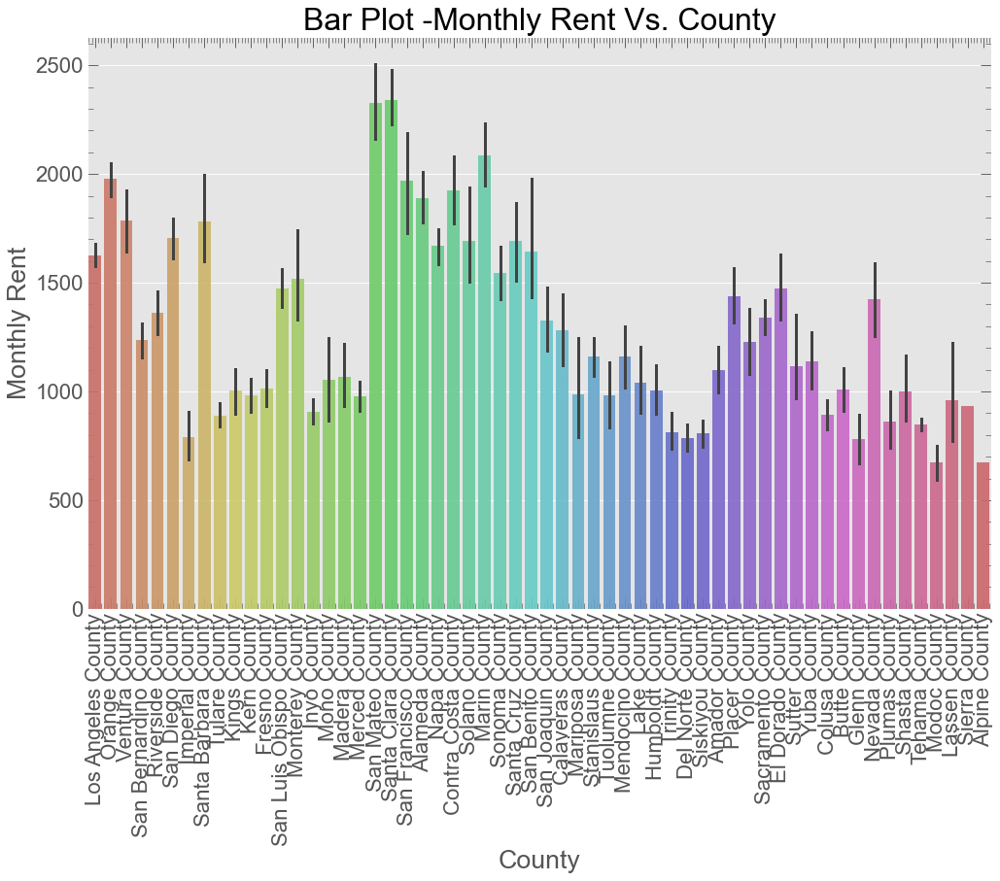

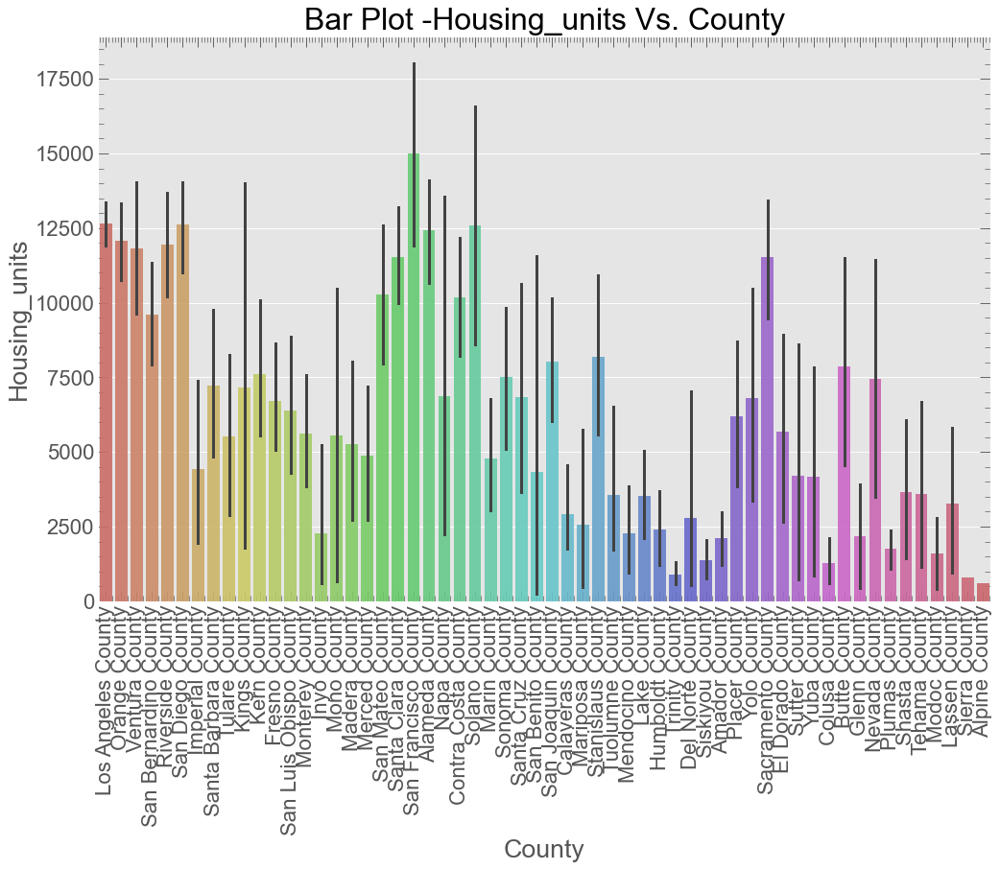

In [35]:
#
c=['Median Age', 'Household Income','Poverty Rate', 'House Value',
       'Monthly Owner Cost', 'Monthly Rent','Housing_units']

for i in range(1, 8):
    fig = plt.figure(figsize=(15,80))
    ax = fig.add_subplot(7, 1, i)
    
    sns.barplot(x='County', y=c[i-1],
            data=ca_2019, alpha=0.9, palette = 'hls',ax=ax)
    
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
    ax.set_ylabel(f'{c[i-1]}')
    ax.set_xlabel('County')
    ax.set_title(f'Bar Plot -{c[i-1]} Vs. County')

plt.show()


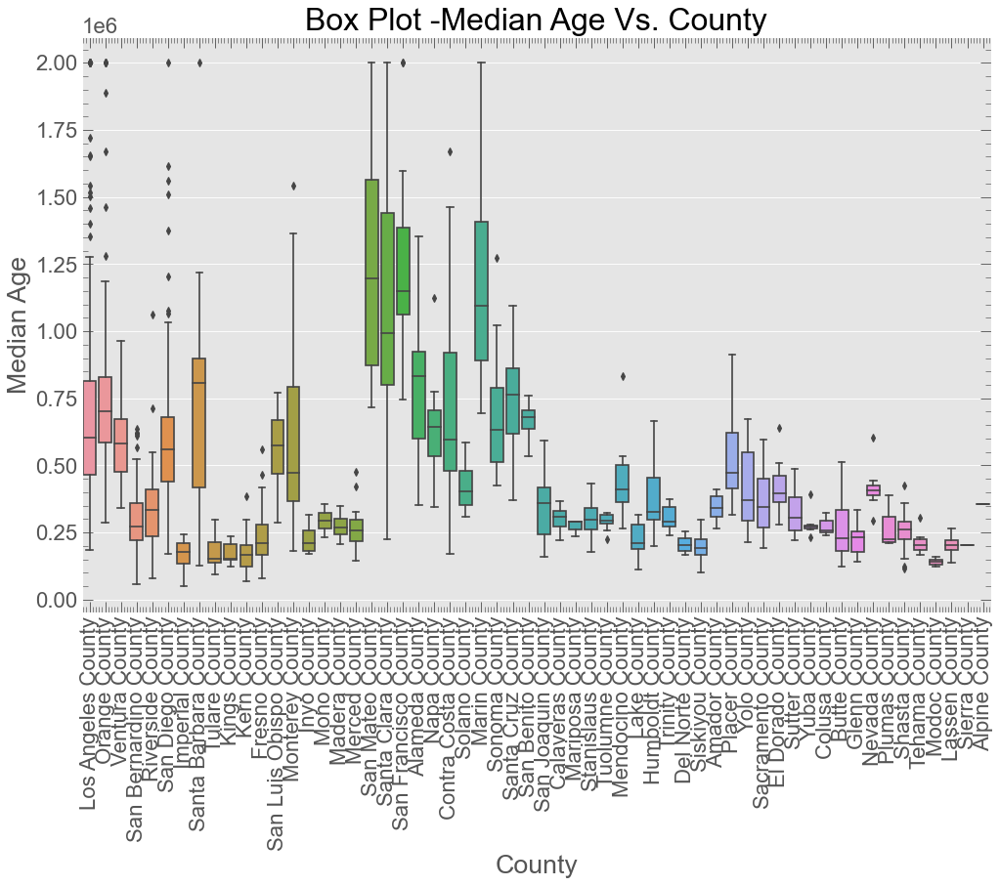

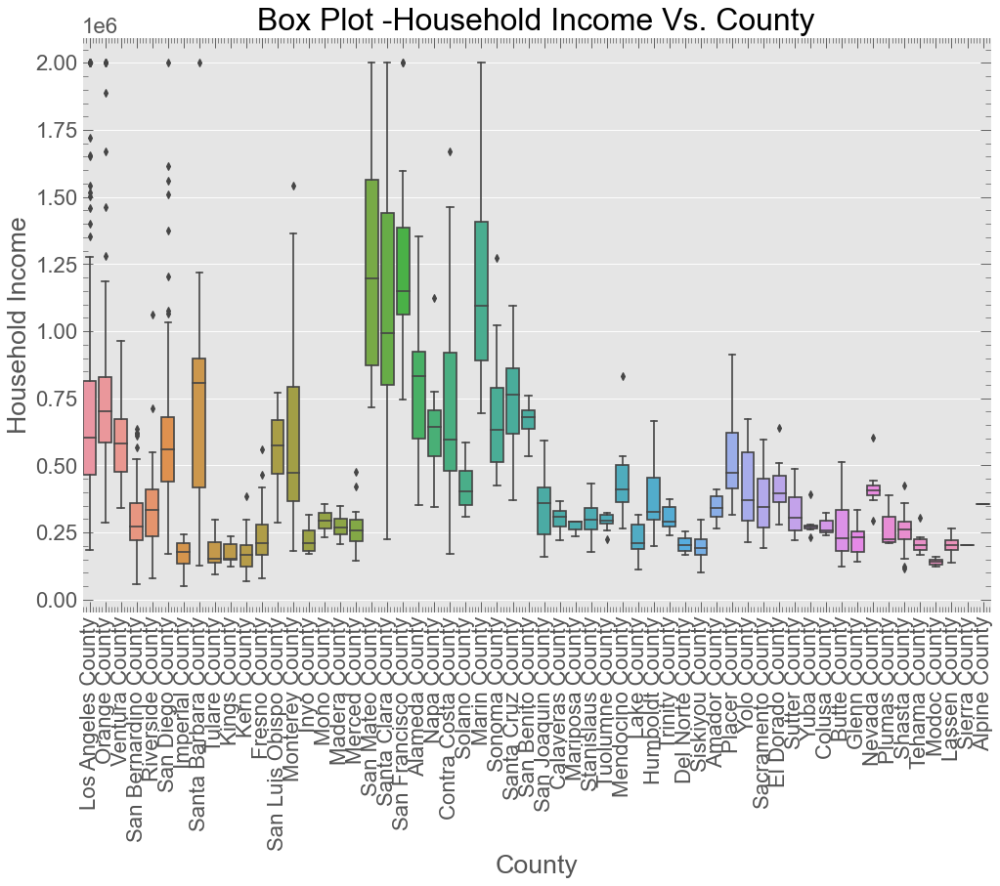

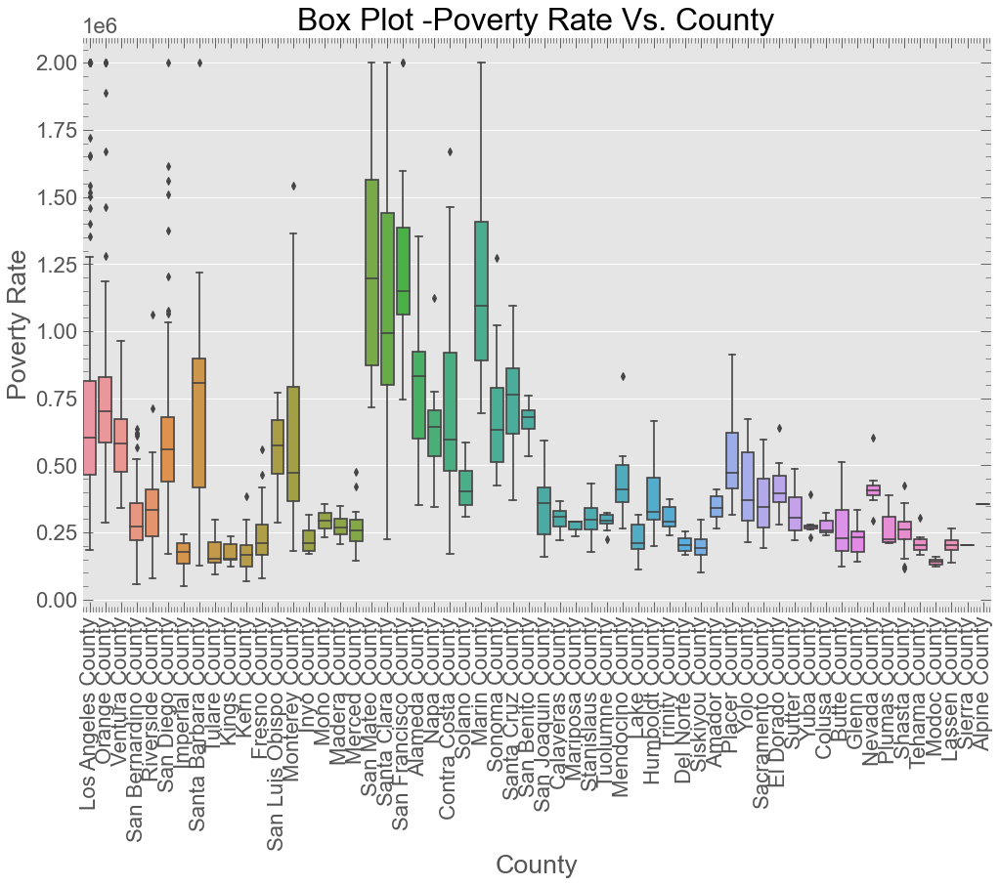

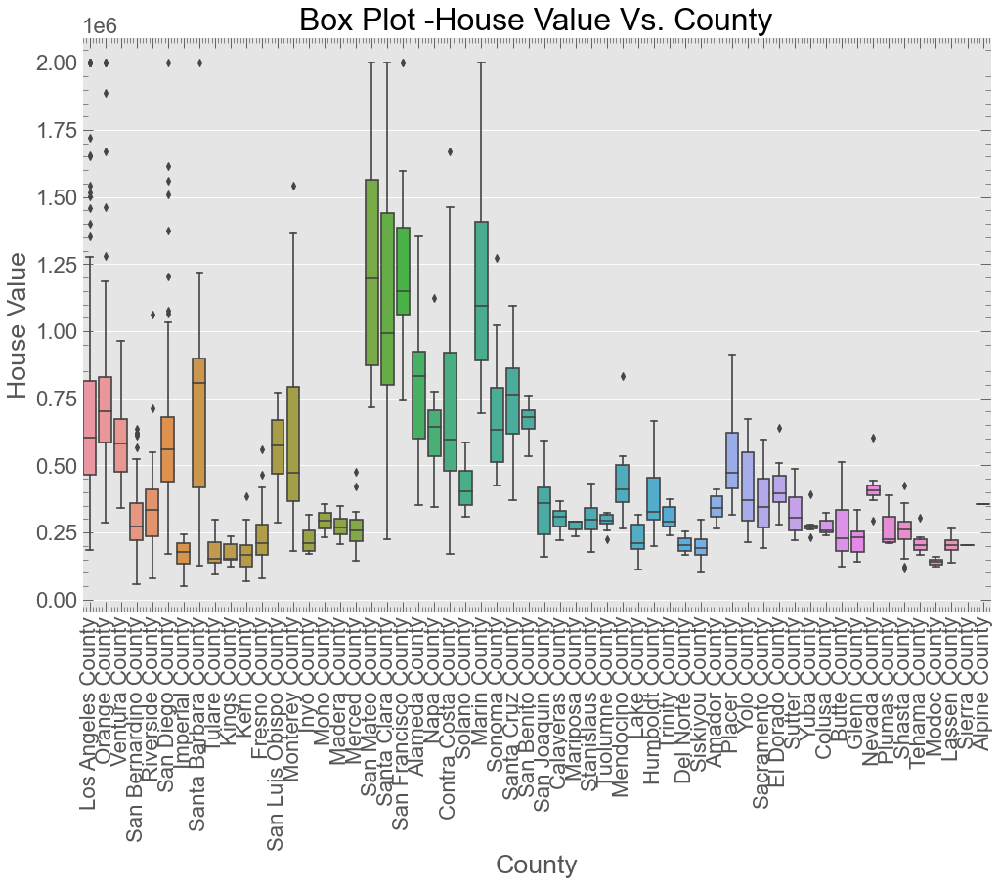

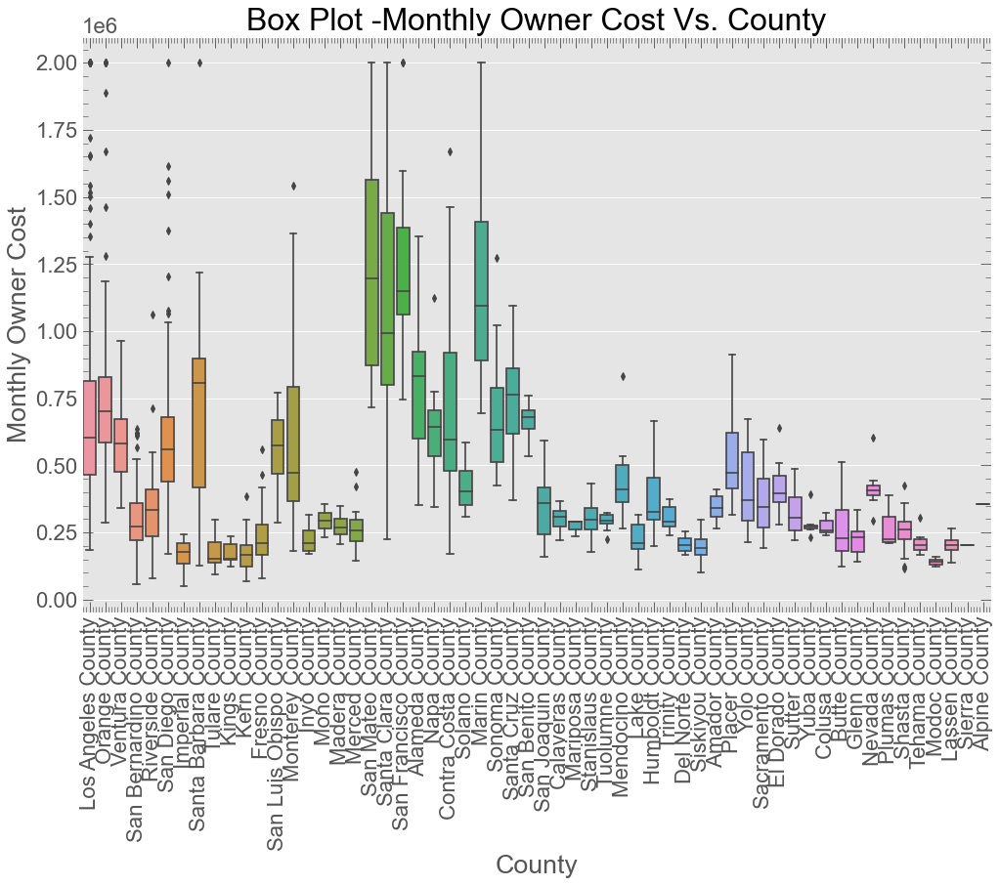

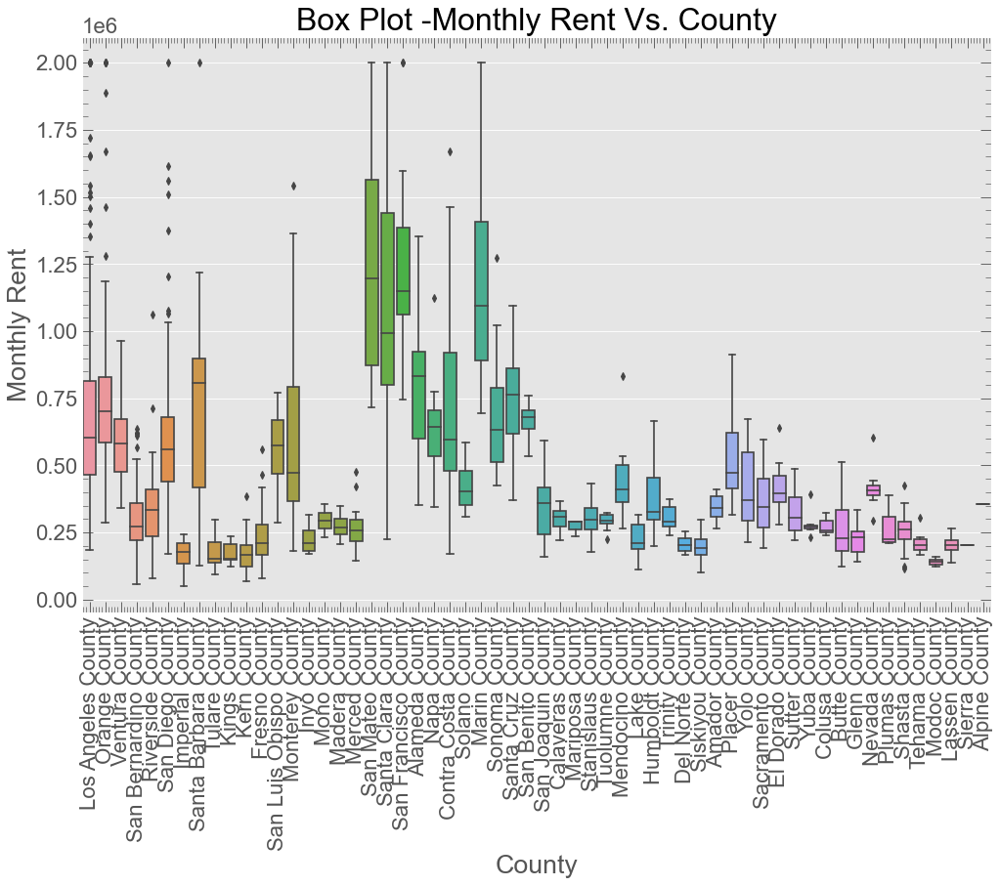

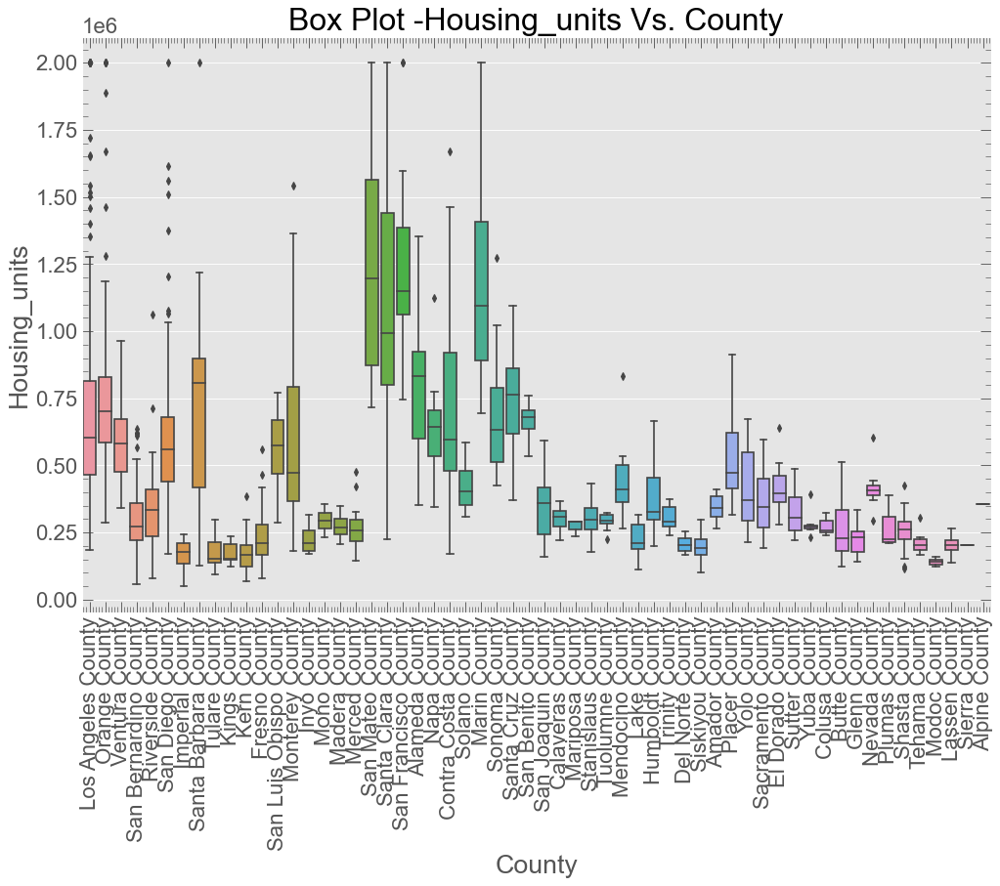

In [36]:
#
c=['Median Age', 'Household Income','Poverty Rate', 'House Value',
       'Monthly Owner Cost', 'Monthly Rent','Housing_units']

for i in range(1, 8):
    fig = plt.figure(figsize=(15,80))
    ax = fig.add_subplot(7, 1, i)
    
    sns.boxplot(x='County', y="House Value",data=ca_2019, ax=ax)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
    ax.set_ylabel(f'{c[i-1]}')
    ax.set_xlabel('County')
    ax.set_title(f'Box Plot -{c[i-1]} Vs. County')

plt.show()

In [39]:
#selecting only important columns
ca_19=ca_2019[['City', 'House Value','Household Income','Population',
       'Poverty Rate', 'Unemployment Rate','Monthly Owner Cost', 'Monthly Rent',
       'Public Transport Rate', 'Uneducated Rate', 
        'Median Age','Per Capita Income',
       'College Rate' ]]

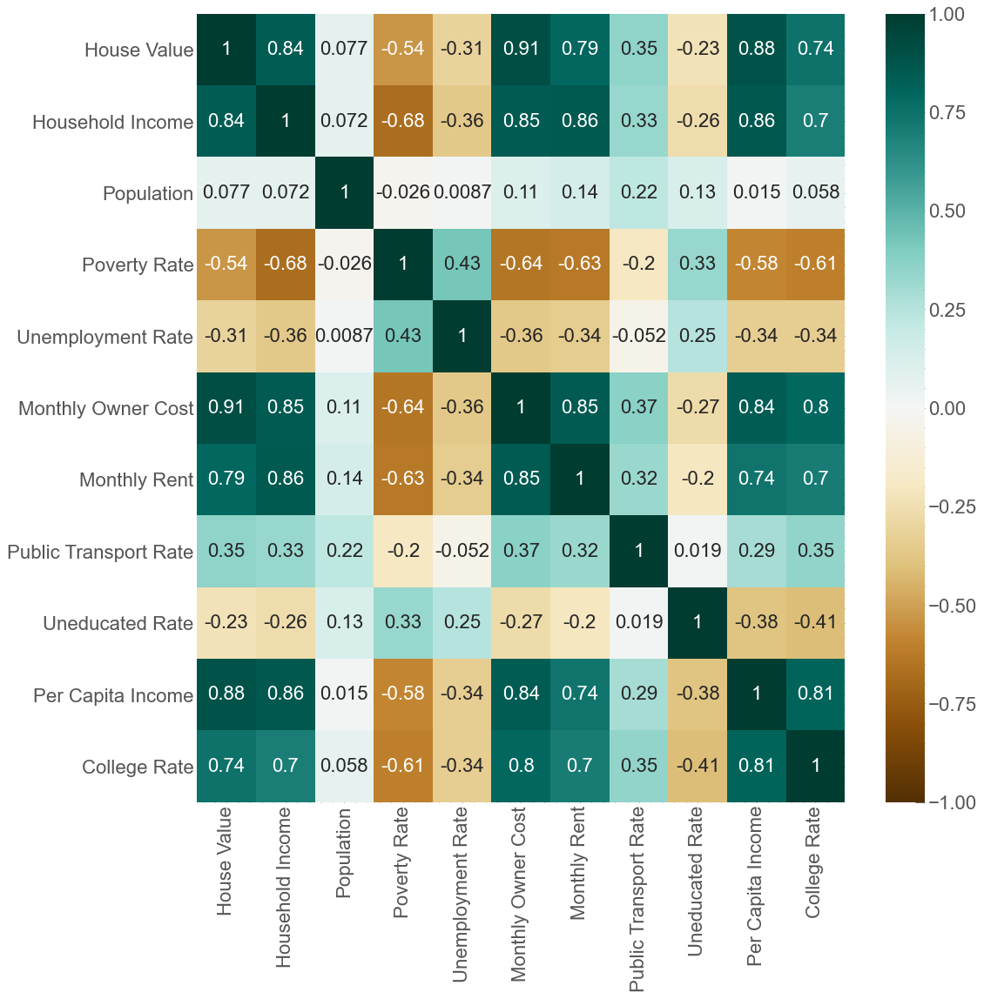

In [43]:
#plotting all correlation using seaborn heatmap
corr_19=ca_19.corr()
import seaborn as sns
fig, ax=plt.subplots(figsize=(15,15))
sns.heatmap(corr_19,vmin=-1, vmax=1, ax=ax, cmap='BrBG',annot=True)
plt.show()

## Different years house value

In [162]:
#combined data on from differnt years
df_2012=ca_2012[['Zipcode', 'County','Monthly Owner Cost', 'Monthly Rent', 'House Value']]
df_2014=ca_2014[['Zipcode', 'Monthly Owner Cost', 'Monthly Rent', 'House Value']]
df_2017=ca_2017[['Zipcode', 'Monthly Owner Cost', 'Monthly Rent', 'House Value']]
df_2019=ca_2019[['Zipcode', 'Monthly Owner Cost', 'Monthly Rent', 'House Value']]
df_combined=(df_2012.merge(df_2014, on='Zipcode', suffixes=('_2012', '_2014'))
             .merge(df_2017, on='Zipcode')
             .merge(df_2019, on='Zipcode', suffixes=('_2017', '_2019')))
df_combined=df_combined.drop(['Zipcode'], axis=1)
df_comb=df_combined.groupby('County').mean().reset_index()

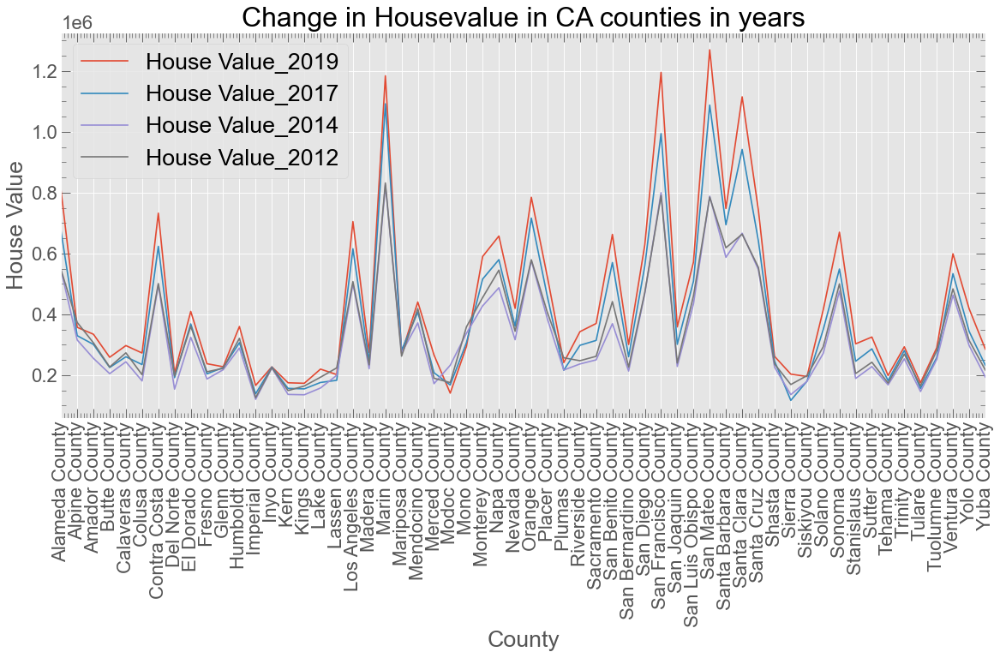

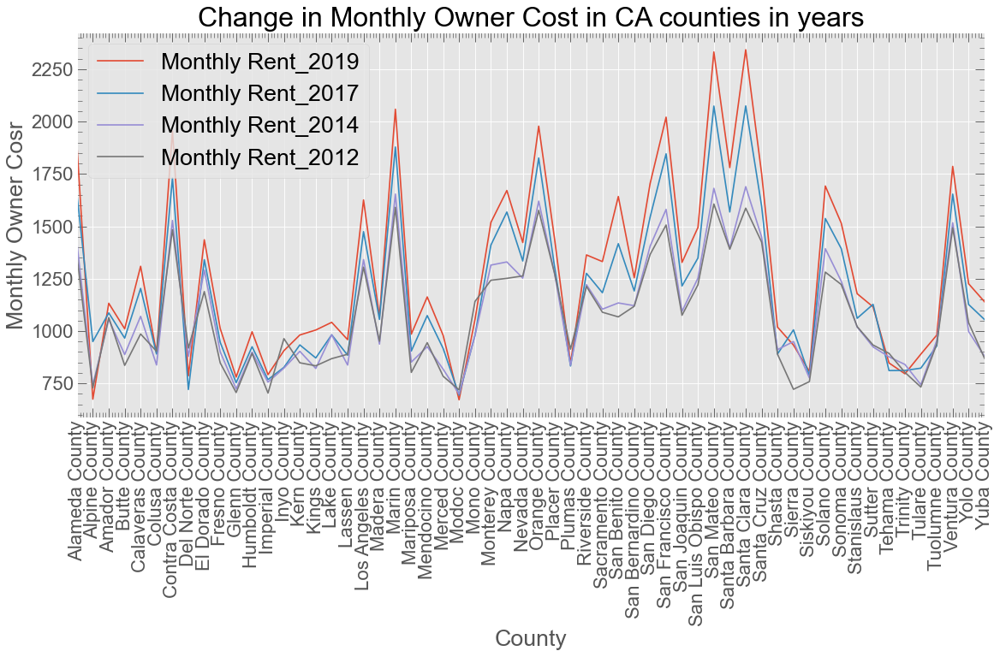

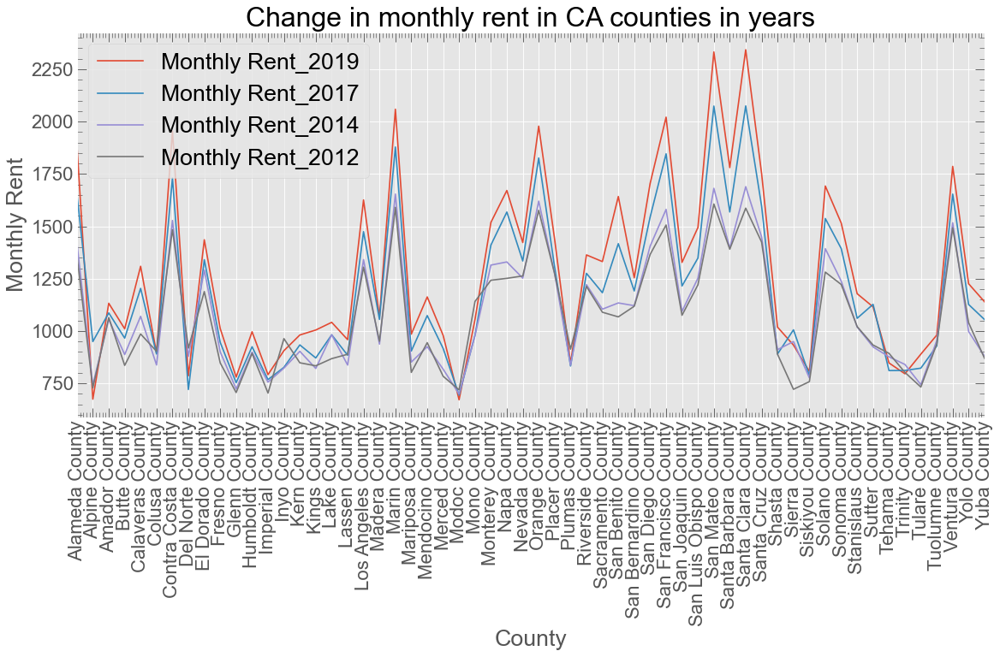

In [176]:
#plotting
counties=df_combined['County'].nunique()
x_values=np.arange(0,counties)
county_house_value=df_comb[["House Value_2019","House Value_2017",
                            "House Value_2014","House Value_2012"]]
county_monthly_cost=df_comb[["Monthly Owner Cost_2019","Monthly Owner Cost_2017",
                                             "Monthly Owner Cost_2014",
                                             "Monthly Owner Cost_2012"]]
county_monthly_cost=df_comb[["Monthly Rent_2019","Monthly Rent_2017",
                                             "Monthly Rent_2014",
                                             "Monthly Rent_2012"]]
cols=['House Value', "Monthly Owner Cosr", 'Monthly Rent']
title=['Change in Housevalue in CA counties in years',
       'Change in Monthly Owner Cost in CA counties in years',
       'Change in monthly rent in CA counties in years']
county_all=[county_house_value,county_monthly_cost,county_monthly_cost] 

for i, county in enumerate(county_all):
    county.plot.line(xticks=x_values,rot=90,grid=True,figsize=(15,10))
    plt.xlim(0,57)
    plt.xlabel("County")
    plt.ylabel(f"{cols[i]}")
    plt.title(f'{title[i]}')
    plt.tight_layout()
    plt.show()

In [179]:
ca_2019.columns

Index(['Zipcode', 'Population', 'Median Age', 'Household Income',
       'Per Capita Income', 'Poverty Rate', 'Unemployment Rate', 'House Value',
       'House Construction Year', 'Monthly Owner Cost', 'Monthly Rent',
       'Public Transport Rate', 'Personal Transport Rate',
       'Commute Time Public', 'Commute Time Car', 'High School Rate',
       'College Rate', 'Uneducated Rate', 'English Language',
       'Spanish Language', 'White Population Rate', 'Black Population Rate',
       'Hispanic Population Rate', 'Asian Population Rate', 'City', 'County',
       'Lat', 'Lng', 'Housing_units', 'State'],
      dtype='object')

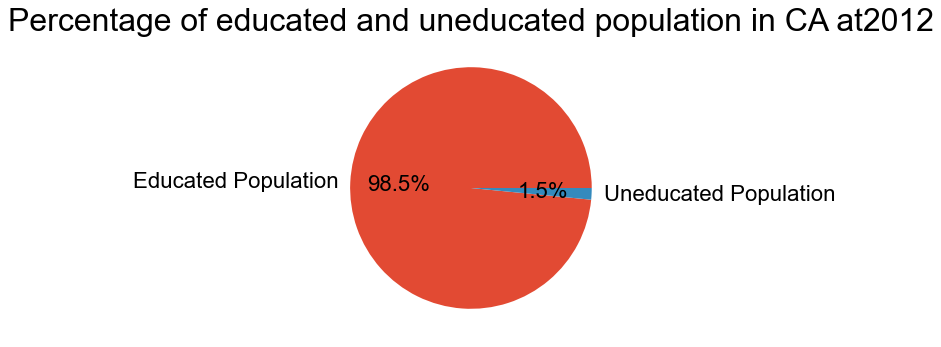

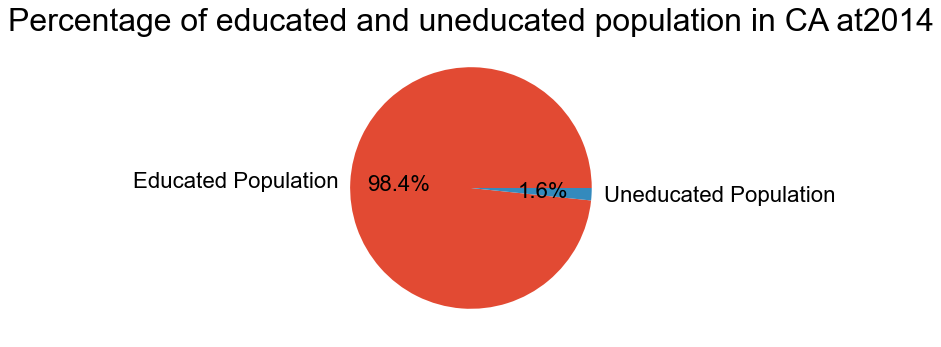

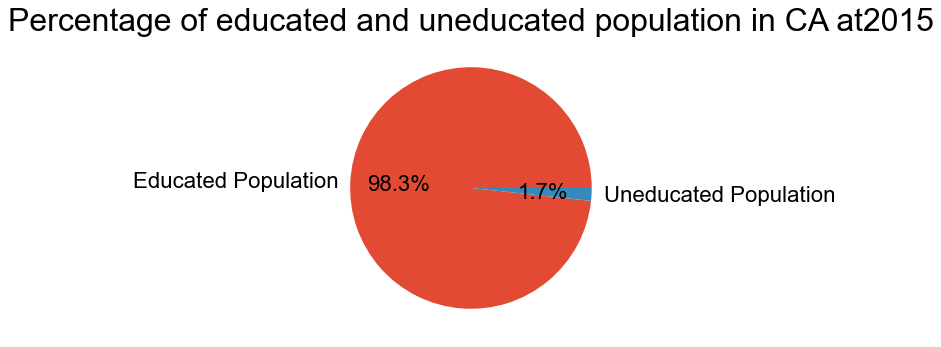

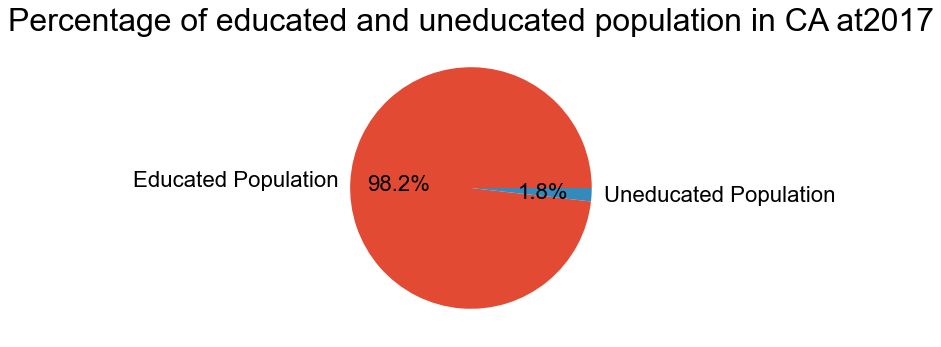

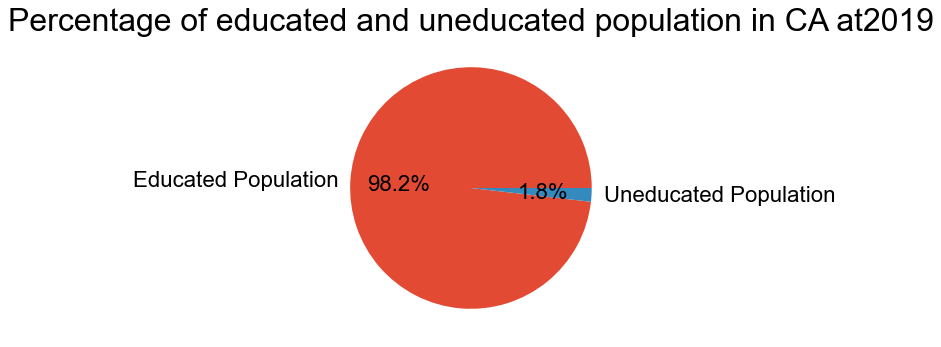

In [188]:
#Percentage of educated and uneducated population in CA
all_data=[ca_2012,ca_2014, ca_2015, ca_2017, ca_2019]
year=['2012','2014', '2015', '2017', '2019']
for i, data in enumerate(all_data):
    ca_total_population=data['Population'].sum()
    ca_uneducated=((data['Population']*data["Uneducated Rate"])/100).sum(axis=0)
    ca_educated=(ca_total_population-ca_uneducated)
    plt.figure(figsize=(5,5))
    slices=[ca_educated,ca_uneducated]
    labels=["Educated Population","Uneducated Population"]
    plt.pie(slices,labels=labels,autopct="%1.1f%%")
    plt.title(f"Percentage of educated and uneducated population in CA at{year[i]}")
    #plt.tight_layout()
    plt.show()

In [189]:
ca_2019.columns

Index(['Zipcode', 'Population', 'Median Age', 'Household Income',
       'Per Capita Income', 'Poverty Rate', 'Unemployment Rate', 'House Value',
       'House Construction Year', 'Monthly Owner Cost', 'Monthly Rent',
       'Public Transport Rate', 'Personal Transport Rate',
       'Commute Time Public', 'Commute Time Car', 'High School Rate',
       'College Rate', 'Uneducated Rate', 'English Language',
       'Spanish Language', 'White Population Rate', 'Black Population Rate',
       'Hispanic Population Rate', 'Asian Population Rate', 'City', 'County',
       'Lat', 'Lng', 'Housing_units', 'State'],
      dtype='object')

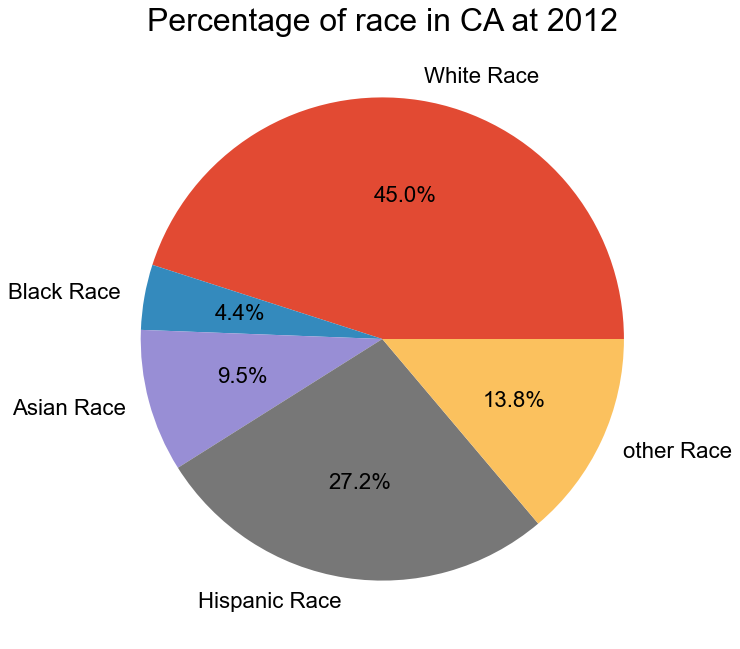

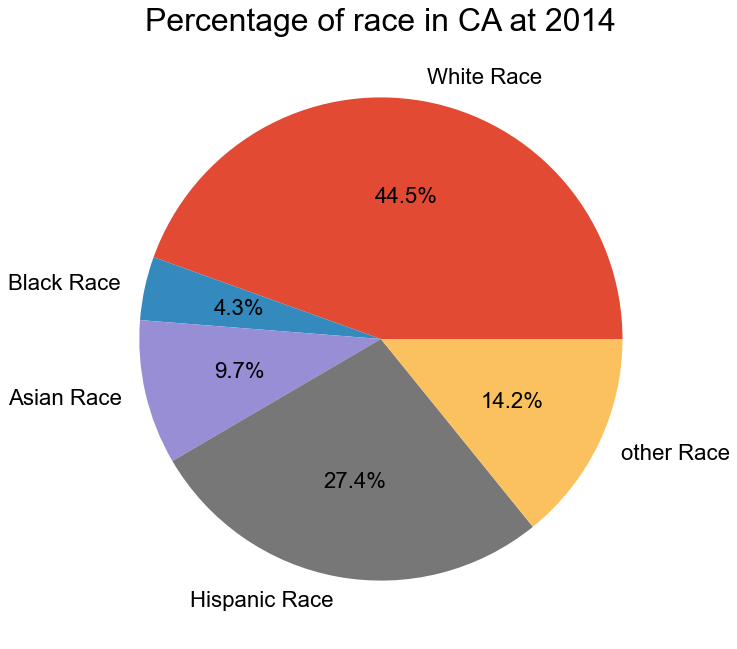

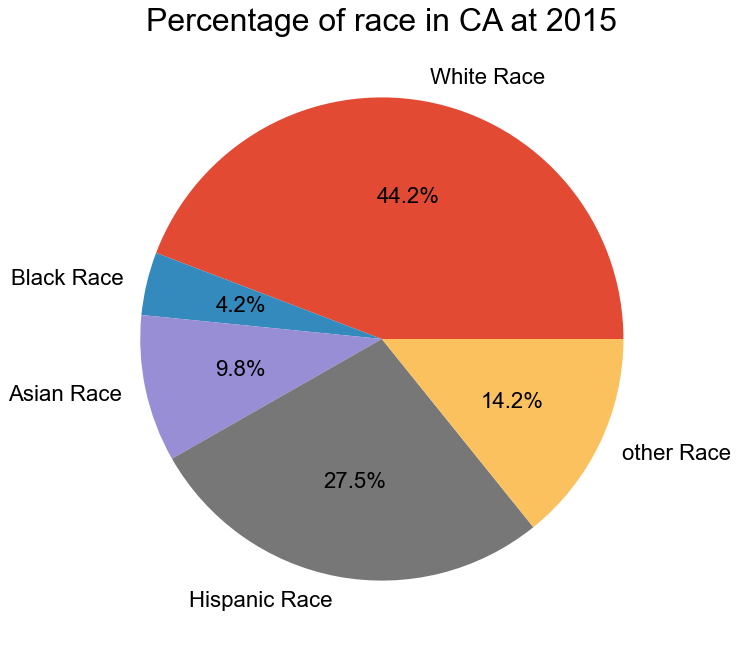

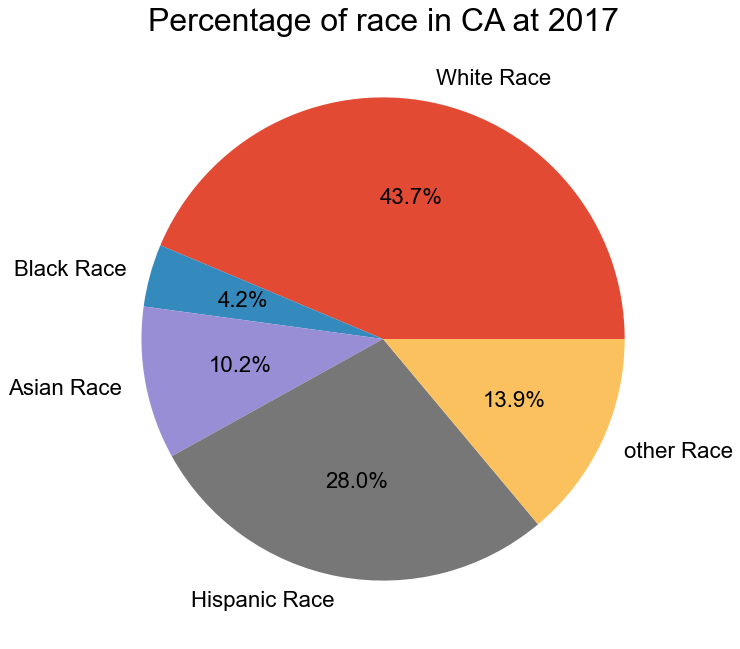

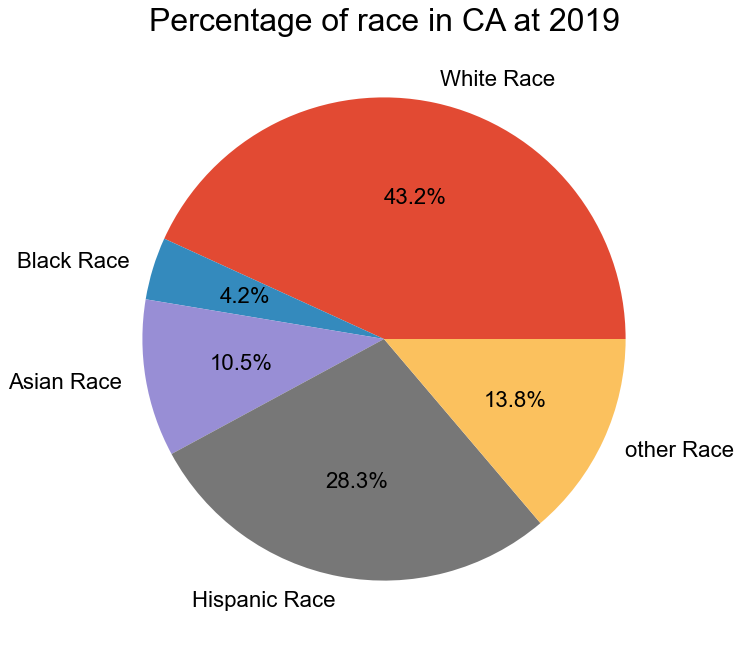

In [197]:
#Percentage of educated and uneducated population in CA

all_data=[ca_2012,ca_2014, ca_2015, ca_2017, ca_2019]
year=['2012','2014', '2015', '2017', '2019']
for i, data in enumerate(all_data):
    ca_total_population=data['Population'].sum()
    ca_white=((data['Population']*data['White Population Rate'])/100).sum(axis=0)
    ca_black=((data['Population']*data['Black Population Rate'])/100).sum(axis=0)
    ca_asian=((data['Population']*data['Asian Population Rate'])/100).sum(axis=0)
    ca_hispanic=((data['Population']*data['Hispanic Population Rate'])/100).sum(axis=0)
    ca_other=(-ca_total_population+(ca_white+ca_black+ca_asian+ca_hispanic))
    #plt.figure(figsize=(5,5))
    slices=[ca_white, ca_black, ca_asian, ca_hispanic, ca_other]
    labels=["White Race","Black Race", 
            'Asian Race','Hispanic Race','Other Race']
    plt.pie(slices,labels=labels,autopct="%1.1f%%")
    plt.title(f"Percentage of race in CA at {year[i]}")
    #plt.tight_layout()
    plt.show()

In [203]:
#combined data on from differnt years
r_2012=ca_2012[['County','White Population Rate',
               'Black Population Rate',
               'Hispanic Population Rate',
               'Asian Population Rate']]
r_2012=r_2012.groupby('County').mean()

r_2014=ca_2014[['County','White Population Rate',
               'Black Population Rate',
               'Hispanic Population Rate',
               'Asian Population Rate']]
r_2014=r_2014.groupby('County').mean()

r_2015=ca_2015[["County",'White Population Rate',
               'Black Population Rate',
               'Hispanic Population Rate',
               'Asian Population Rate']]
r_2015=r_2015.groupby('County').mean()

r_2017=ca_2017[["County",'White Population Rate',
               'Black Population Rate',
               'Hispanic Population Rate',
               'Asian Population Rate']]
r_2017=r_2017.groupby('County').mean()

r_2019=ca_2019[["County",'White Population Rate',
               'Black Population Rate',
               'Hispanic Population Rate',
               'Asian Population Rate']]
r_2019=r_2019.groupby('County').mean()

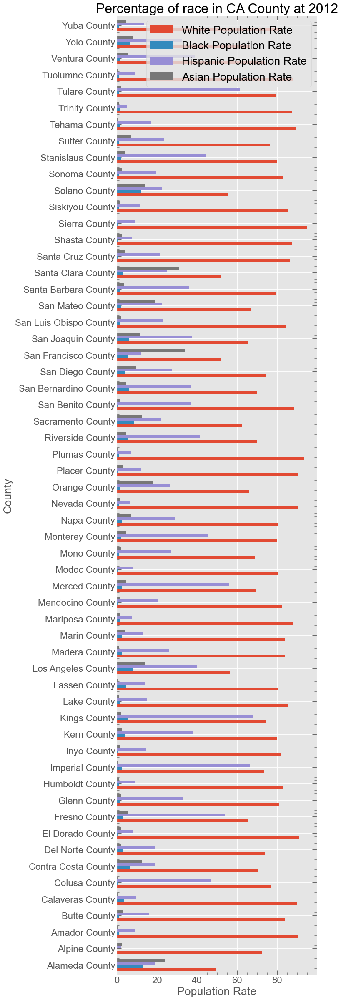

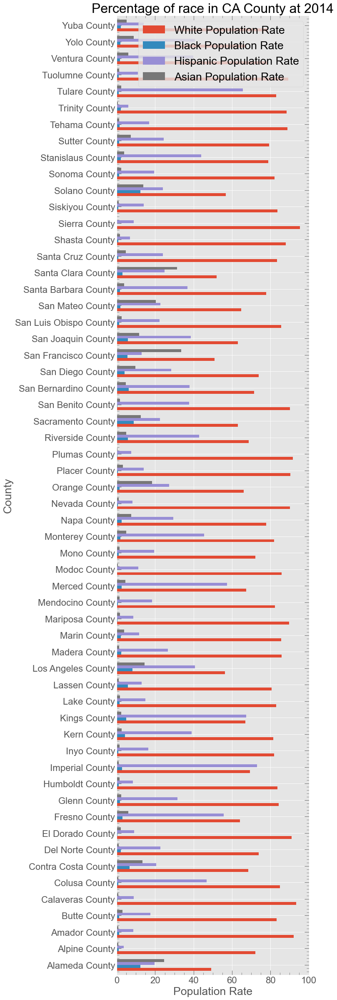

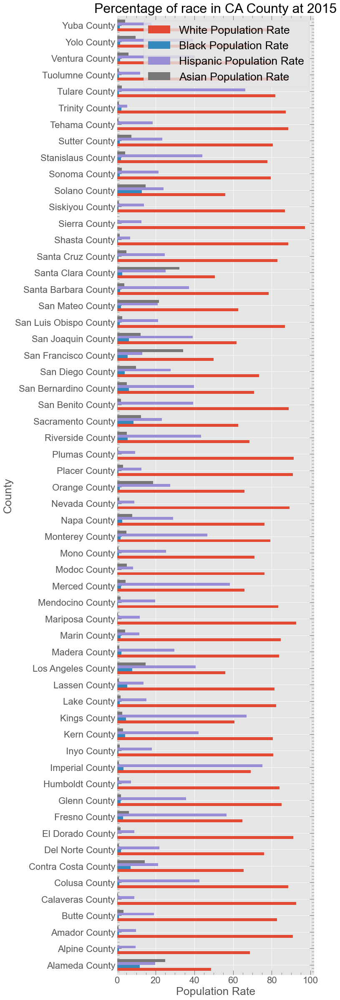

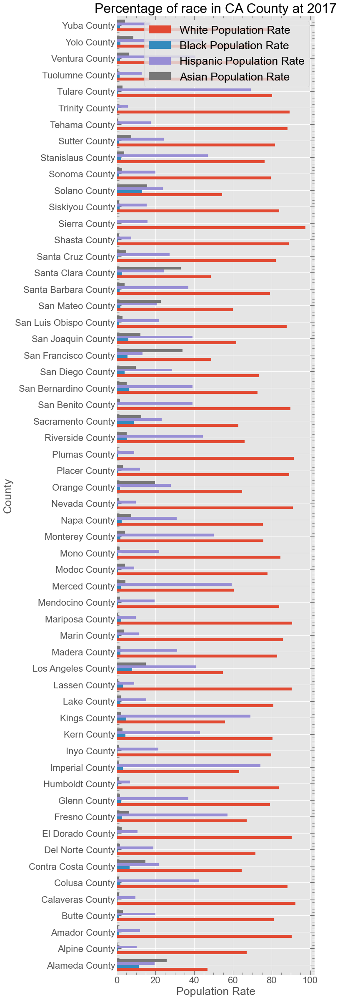

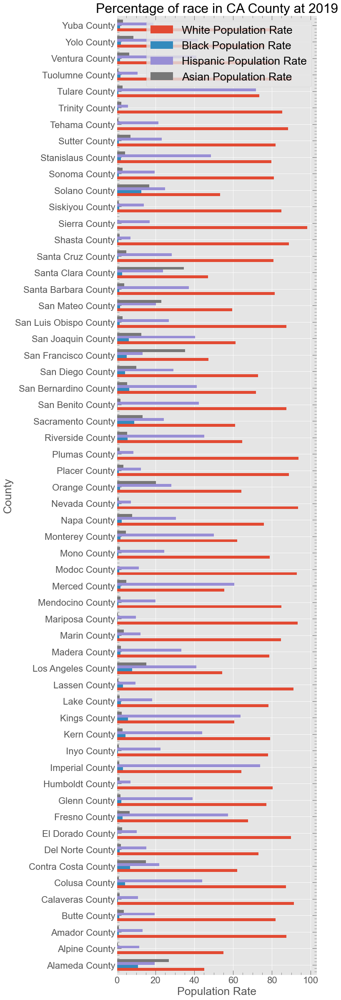

In [204]:
r_data=[r_2012,r_2014,r_2015,r_2017,r_2019]
year=['2012','2014', '2015', '2017', '2019']
for i, data in enumerate(r_data):
    data.plot(kind="barh",width=.7,figsize=(10,30))
    plt.xlabel("Population Rate")
    plt.ylabel("County")
    plt.tight_layout()
    plt.title(f"Percentage of race in CA County at {year[i]}")
    plt.show()

# Top 5 Best Cities for Differnt Years

In [134]:
#getting best city for each year and appending to cities
cities=[]
all_data=[ca_2012,ca_2014, ca_2015, ca_2017, ca_2019]
for data in all_data:
    
    #selecting only important columns
    d1=data[['City', 'House Value','Household Income','Population',
       'Poverty Rate', 'Unemployment Rate','Monthly Owner Cost', 'Monthly Rent',
       'Public Transport Rate', 'Uneducated Rate', 
        'Median Age','Per Capita Income',
       'College Rate' ]]
    #using groupby method to groupby the data according to city
    d1=d1.groupby('City').agg({'House Value': 'mean',
                                  'Household Income': 'mean',
                                  'Population': 'sum',
                                   'Poverty Rate': 'mean', 
                                  'Unemployment Rate': 'mean',
                                  'Monthly Owner Cost': 'mean', 
                                  'Monthly Rent': 'mean',
                                   'Public Transport Rate': 'mean', 
                                  'Uneducated Rate': 'mean', 
                                  'Per Capita Income': 'mean',
                                  'College Rate': 'mean'}).reset_index()
    d2=d1.nlargest(50,"Population")
    #getting nlargest and nsmallest of all columns and selecting their city as a list
    hv=d2.nsmallest(50, 'House Value')
    hv_c=hv['City'].tolist()
    ue=d2.nsmallest(20, 'Unemployment Rate')
    ue_c=ue['City'].tolist()
    pt=d2.nlargest(20, 'Public Transport Rate')
    pt_c=pt['City'].tolist()
    p=d2.nsmallest(20, 'Poverty Rate')
    p_c=p['City'].tolist()
    ued=d2.nsmallest(20, 'Uneducated Rate')
    ued_c=ued['City'].tolist()
    mr=d2.nsmallest(20, 'Monthly Rent')
    mr_c=mr['City'].tolist()
    moc=d2.nsmallest(20, 'Monthly Owner Cost')
    moc_c=moc['City'].tolist()
    pci=d2.nlargest(20, 'Per Capita Income')
    pci_c=pci['City'].tolist()
    cr=d2.nsmallest(20, 'College Rate')
    cr_c=mr['City'].tolist()
    hi=d2.nlargest(20, 'Household Income')
    hi_c=hi['City'].tolist()
    
    #Ading largest or smallest city from all columns

    all_city=hv_c + ue_c + pt_c + p_c + ued_c +mr_c + moc_c +hi_c+cr_c+pci_c

    #Using counter to count most common
    my_counter=Counter(all_city)
    best_city=my_counter.most_common(5)
    cities.append(best_city)
    
print(cities)

[[('Sunnyvale', 7), ('Fremont', 7), ('Santa Barbara', 7), ('Lancaster', 6), ('Elk Grove', 6)], [('San Diego', 7), ('Sunnyvale', 7), ('Pasadena', 7), ('Fremont', 7), ('San Mateo', 7)], [('San Diego', 7), ('Sunnyvale', 7), ('Fremont', 7), ('San Mateo', 7), ('Santa Barbara', 7)], [('Roseville', 7), ('Sunnyvale', 7), ('Fremont', 7), ('San Mateo', 7), ('Lancaster', 6)], [('Roseville', 7), ('Fremont', 7), ('Sunnyvale', 7), ('San Mateo', 7), ('Visalia', 6)]]


In [143]:
#creating a dataframe for best cities
df_best=pd.DataFrame({'city_2012':cities[0],
                     'city_2014':cities[1],
                     'city_2015':cities[2],
                     'city_2017':cities[3],
                    'city_2019':cities[4]})
df_best

,city_2012,city_2014,city_2015,city_2017,city_2019
0,"(Sunnyvale, 7)","(San Diego, 7)","(San Diego, 7)","(Roseville, 7)","(Roseville, 7)"
1,"(Fremont, 7)","(Sunnyvale, 7)","(Sunnyvale, 7)","(Sunnyvale, 7)","(Fremont, 7)"
2,"(Santa Barbara, 7)","(Pasadena, 7)","(Fremont, 7)","(Fremont, 7)","(Sunnyvale, 7)"
3,"(Lancaster, 6)","(Fremont, 7)","(San Mateo, 7)","(San Mateo, 7)","(San Mateo, 7)"
4,"(Elk Grove, 6)","(San Mateo, 7)","(Santa Barbara, 7)","(Lancaster, 6)","(Visalia, 6)"


In [146]:
#getting dataframe for best city
best_cities=[]
all_df=[]
year=['2012','2014', '2015', '2017', '2019']
for i, data in enumerate(all_data):
    d3=data[(data['City']==cities[i][0][0])|
            (data['City']==cities[i][1][0])|
            (data['City']==cities[i][2][0])|
            (data['City']==cities[i][3][0])|
            (data['City']==cities[i][4][0])]
    d3=d3.drop_duplicates(subset=['City'],keep='last')
    all_df.append(d3)
    # Convert best city to list
    best_city=(cities[i][0][0], cities[i][1][0], cities[i][2][0],cities[i][3][0],cities[i][4][0])
    best_city=list(best_city)
    print(f'Best cities for {year[i]} are:{best_city}')
    best_cities.append(best_city)
    

Best cities for 2012 are:['Sunnyvale', 'Fremont', 'Santa Barbara', 'Lancaster', 'Elk Grove']
Best cities for 2014 are:['San Diego', 'Sunnyvale', 'Pasadena', 'Fremont', 'San Mateo']
Best cities for 2015 are:['San Diego', 'Sunnyvale', 'Fremont', 'San Mateo', 'Santa Barbara']
Best cities for 2017 are:['Roseville', 'Sunnyvale', 'Fremont', 'San Mateo', 'Lancaster']
Best cities for 2019 are:['Roseville', 'Fremont', 'Sunnyvale', 'San Mateo', 'Visalia']


In [145]:
#creating a dataframe for best cities
df_best=pd.DataFrame({'city_2012':best_cities[0],
                     'city_2014':best_cities[1],
                     'city_2015':best_cities[2],
                     'city_2017':best_cities[3],
                    'city_2019':best_cities[4]})
df_best

,city_2012,city_2014,city_2015,city_2017,city_2019
0,Sunnyvale,San Diego,San Diego,Roseville,Roseville
1,Fremont,Sunnyvale,Sunnyvale,Sunnyvale,Fremont
2,Santa Barbara,Pasadena,Fremont,Fremont,Sunnyvale
3,Lancaster,Fremont,San Mateo,San Mateo,San Mateo
4,Elk Grove,San Mateo,Santa Barbara,Lancaster,Visalia


## Plotting using gmaps

## Best cities of 2012

In [147]:
#2012
d_2012=all_df[0]
b_city_2012=best_cities[0]
marker_locations = d_2012[['Lat', 'Lng']]

# Create a marker_layer using the best city list to fill the info box
fig = gmaps.figure()
markers = gmaps.marker_layer(marker_locations,
            info_box_content=[f"Best City: {city}" for city in b_city_2012])
fig.add_layer(markers)
    
fig

Figure(layout=FigureLayout(height='420px'))

## Best cities of 2014

In [148]:
#2014
d_2014=all_df[1]
b_city_2014=best_cities[1]
marker_locations = d_2014[['Lat', 'Lng']]

# Create a marker_layer using the best city list to fill the info box
fig = gmaps.figure()
markers = gmaps.marker_layer(marker_locations,
            info_box_content=[f"Best City: {city}" for city in b_city_2014])
fig.add_layer(markers)
    
fig

Figure(layout=FigureLayout(height='420px'))

## Best cities of 2015

In [149]:
#2015
d_2015=all_df[2]
b_city_2015=best_cities[2]
marker_locations = d_2015[['Lat', 'Lng']]

# Create a marker_layer using the best city list to fill the info box
fig = gmaps.figure()
markers = gmaps.marker_layer(marker_locations,
            info_box_content=[f"Best City: {city}" for city in b_city_2015])
fig.add_layer(markers)
    
fig

Figure(layout=FigureLayout(height='420px'))

## Best cities of 2017

In [150]:
#2017
d_2017=all_df[3]
b_city_2017=best_cities[3]
marker_locations = d_2017[['Lat', 'Lng']]

# Create a marker_layer using the best city list to fill the info box
fig = gmaps.figure()
markers = gmaps.marker_layer(marker_locations,
            info_box_content=[f"Best City: {city}" for city in b_city_2017])
fig.add_layer(markers)
    
fig

Figure(layout=FigureLayout(height='420px'))

## Best cities of 2019

In [151]:
#2019
d_2019=all_df[4]
b_city_2019=best_cities[4]
marker_locations = d_2019[['Lat', 'Lng']]

# Create a marker_layer using the best city list to fill the info box
fig = gmaps.figure()
markers = gmaps.marker_layer(marker_locations,
            info_box_content=[f"Best City: {city}" for city in b_city_2019])
fig.add_layer(markers)
    
fig

Figure(layout=FigureLayout(height='420px'))